ООО "Фабрика оценки", ИНН 7806299780

# Количественный межрегиональный анализ российского рынка жилой недвижимости в многоквартирных домах по состоянию на 2023-12-31 на основе данных Sberindex (сервис ПАО "Сбербанк") 

Вариант 1: Санкт-Петербург и Ленинградская область, Москва и Московская область рассматриваются как четыре отдельных региона

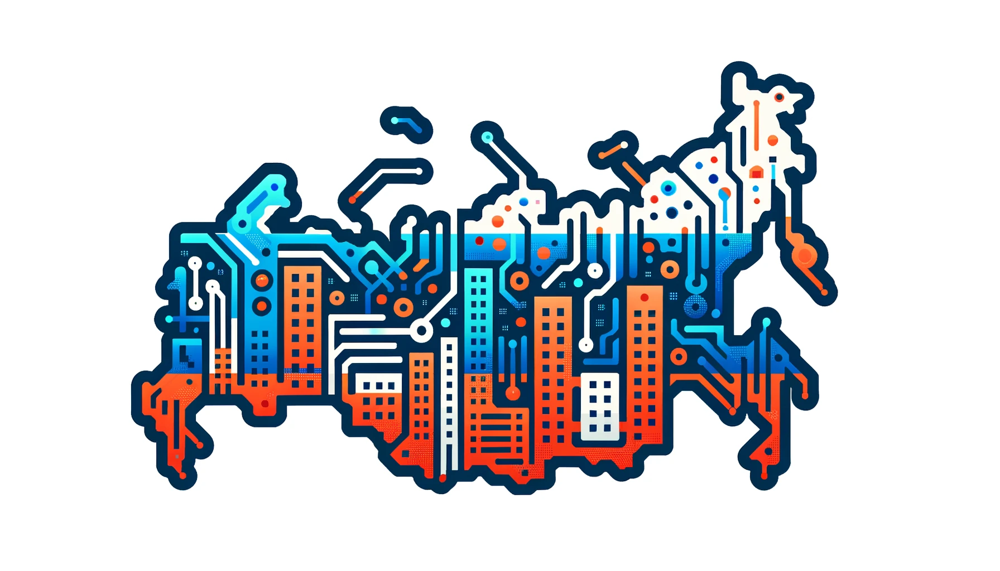

Анализ, приведённый в данном исследовании, полностью основан на данных, предоставляемых [Sberindex](https://sberindex.ru/en) и размещаемых им в [открытом доступе](https://sberindex.ru/en/dashboards?partition=7). Автор данного исследования, равно как и правообладатель модели машинного обучения [Syväjärvi](https://www.facebook.com/groups/1977067932456703)© ([Сювяярви](https://t.me/AIinValuation)) ([Sovconsult DOO](https://sovconsult.tech)), используемой в данной работе, а также провайдер облачной инфраструктуры данной модели (Meleksa Research AB) не имеют какое-либо отношение к Sberindex или ПАО "Сбербанк", равно как и Sberindex и ПАО "Сбербанк" не имеют какое-либо отношение к данному исследованию и не несут какую-либо ответственность за его результаты и сделанные на его основе выводы.

Данное исследование распространяется на условиях лицензии [CC BY-SA 4.0 license](https://creativecommons.org/licenses/by-sa/4.0/).
Все данные, модели, выводы и результаты предоставляются "как есть" и служат только для информационных целей.
Автор исследования, равно как и разработчик модели Syväjärvi© или провайдер её инфраструктуры не несут какую-либо ответственность за последствия использования данного исследования и не дают какую-либо гарантию за точность и правильность его содержания.
Любой частный либо корпоративный пользователь принимает на себя все риски использования данного исследования.

Данное исследование, равно как и все продукты, созданные с помощью модели Syväjärvi©, основано на следующих принципах:
1. согласие со справедливостью [Гипотезы Эффективного Рынка](https://en.wikipedia.org/wiki/Efficient-market_hypothesis);
1. [принцип KISS](https://en.wikipedia.org/wiki/KISS_principle);
1. соответствие требованиям параграфа 3 [МСФО 13 Оценка справедливой стоимости](https://www.ifrs.org/issued-standards/list-of-standards/ifrs-13-fair-value-measurement/#about).

Данное исследование существует в двух вариантах. В данном варианте Санкт-Петербург, Ленинградская область, Москва и Московская область рассматриваются как четыре отдельных региона. Во втором варианте Санкт-Петербург и Ленинградская область объединены в экономический макрорегион "Ингрия"; Москва и Московская область &mdash; "Большая Москва".

## 00 Сведения об использованных данных

|Данные|Правообладатель|Лицензия|URL|
| -- | -- | -- | -- |
|Количественные данные о рынке жилой недвижимости в многокевартирных домах|ПАО "Сбербанк"|не определена|[https://sberindex.ru/en/dashboards?partition=7](https://sberindex.ru/en/dashboards?partition=7)|
|Данные о координатах регионов в формате GeoJSON|Индивидуальный предприниматель Савостьянов Дмитрий Евгеньевич|не определена|[https://mydata.biz/ru/catalog/databases/borders_ru](https://mydata.biz/ru/catalog/databases/borders_ru)|

## 0 Сведения о материалах, являющихся результатом данного исследования 

Основные результаты приводятся в тексте данного исследования. Дополнительные материалы доступны по ссылкам из таблицы.

|Материал|Ссылка|
| -- | -- |
|Основной репозиторий|https://github.com/Kirill-Murashev/sberindex|
|Основной текст исследования на русском языке с качественным рендерингом |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_rus.ipynb|
|Основной текст исследования на английском языке с качественным рендерингом |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_eng.ipynb|
|Основной текст исследования на китайском языке с качественным рендерингом |https://nbviewer.org/github/Kirill-Murashev/sberindex/blob/master/ru_flats_2023_dec_chn.ipynb|
|Исходные данные в кодировке UTF-8|https://web.tresorit.com/l/mhRxz#phwMYN_at8U-x1ZBHUfbjQ|
|Исходные данные, сведённые в единый файл в формате XLSX|https://web.tresorit.com/l/BwLdB#WfcPGKOySdyvUgruGdGYig|
|Тепловые карты в форматах PNG и HTML (интерактивные на картографической основе OSM)|https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg|
|Диаграммы и графики|https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA|

## 1 Начало работы

Подключаем Syväjärvi

In [1]:
import pandas as pd
import syvajarvi as syv

Загружаем и очищаем данные Sberindex

In [2]:
# Set the display options to show all rows and columns
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Fetch data for November 2023
primary_deals, secondary_deals, primary_offers,\
secondary_offers, primary_volumes, secondary_volumes,\
secondary_exposure = syv.read_sberindex_flats('2023-12%')

# Check data
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure = syv.check_consistency(primary_deals,\
                                                                             secondary_deals,\
                                                                             primary_offers,\
                                                                             secondary_offers,\
                                                                             primary_volumes,\
                                                                             secondary_volumes,\
                                                                             secondary_exposure)




Рассчитаем скидки при переходе от цен предложений к ценам сделок.

In [3]:
# Calculate discount rates
primary_discounts = syv.calculate_discount(primary_deals, primary_offers)
secondary_discounts = syv.calculate_discount(secondary_deals, secondary_offers)

Рассчитаем отношения между первичным и вторичным рынками.

In [4]:
# Calculate ratios between primary and secondary markets
deals_ratios = syv.calculate_market_ratios(primary_deals, secondary_deals, 'value')
offers_ratios = syv.calculate_market_ratios(primary_offers, secondary_offers, 'value')
volumes_ratios = syv.calculate_market_ratios(primary_volumes, secondary_volumes, 'value')
discounts_ratios = syv.calculate_market_ratios(primary_discounts, secondary_discounts, 'value')

Добавляем переменную со стандартизированными значениями. Стандартизация выполнялась по методу z-меток: 

\begin{align}
z_{i} = \frac{x_{i} - \mu }{\sigma},
\end{align}

где $x_{i}$ &mdash; оригинальное значение показателя для i-того наблюдения , $\mu$ &mdash; среднее значение показателя, $\sigma$ &mdash; стандартное отклонение показателя.

In [5]:
# Define a list of data frames
sberindex_data_frames = [primary_deals,\
                         secondary_deals,\
                         primary_offers,\
                         secondary_offers,\
                         primary_volumes,\
                         secondary_volumes,\
                         secondary_exposure,\
                         primary_discounts,\
                         secondary_discounts,\
                         deals_ratios,\
                         offers_ratios,\
                         volumes_ratios,\
                         discounts_ratios]

# Define the column to standardize
column_name = 'value'

# Apply the function to each data frame in the list
for i in range(len(sberindex_data_frames)):
    sberindex_data_frames[i] = syv.add_standardized_column(sberindex_data_frames[i], column_name, exclude_regions=['Россия'])

# Update individual data frames
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = sberindex_data_frames



In [6]:
# Apply the smart sorting function to each data frame in the list directly
for i in range(len(sberindex_data_frames)):
    sberindex_data_frames[i] = syv.sberindex_regions_smart_sorting(sberindex_data_frames[i])
    
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = sberindex_data_frames


В исследовании будут использоваться следующие датафреймы.

|Название датафрейма|Описание|
|--- |--- |
|primary_deals|данные о средних ценах сделок за один квадратный метр на первичном рынке|
|secondary_deals|данные о средних ценах сделок за один квадратный метр на вторичном рынке|
|primary_offers|данные о медианных ценах предложений за один квадратный метр на первичном рынке|
|secondary_offers|данные о медианных ценах предложений за один квадратный метр на первичном рынке|
|primary_volumes|данные об объёме предложения на первичном рынке|
|secondary_volumes|данные об объёме предложения на вторичном рынке|
|secondary_exposure|данные о средних сроках экспозиции на вторичном рынке|
|primary_discounts|данные о типичной скидке при переходе от цен предложений к ценам сделок на первичном рынке|
|secondary_discounts|данные о типичной скидке при переходе от цен предложений к ценам сделок на вторичном рынке|
|deals_ratios|отношение цен сделок на первичном рынке к ценам сделок на вторичном рынке|
|offers_ratios|отношение цен предложений на первичном рынке к ценам предложений на вторичном рынке|
|volumes_ratios|отношение объёма предложения на первичном рынке к объёму предложения на вторичном рынке|
|discounts_ratios|отношение типичного значения скидки при переходе от цен предложений к ценам сделок на первичном рынке к аналогичному показателю на вторичном рынке|


## 2 Основные данные о рынке

### 2.1 Таблицы

Данные о средних ценах сделок на первичном рынке.

In [7]:
primary_deals[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",222383,2.893341
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",160999,1.237648
2,"Москва, Moscow, 莫斯科",294745,4.845140
3,"Московская область, Moscow Oblast, 莫斯科州",177221,1.675199
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",171573,1.522857
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",109222,-0.158918
6,"Амурская область, Amur Oblast, 阿穆尔州",146185,0.838074
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",124650,0.257217
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",124954,0.265416
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",104397,-0.289062


Данные о медианных ценах предложений на первичном рынке.

In [8]:
primary_offers[['region', 'value', 'standardized_value' ]]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",244244.0,2.655483
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",161003.0,0.792491
2,"Москва, Moscow, 莫斯科",376354.0,5.612199
3,"Московская область, Moscow Oblast, 莫斯科州",196680.0,1.590967
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",174758.0,1.100337
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",117001.0,-0.192305
6,"Амурская область, Amur Oblast, 阿穆尔州",166531.0,0.916211
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",131841.0,0.139825
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",121965.0,-0.081207
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",106772.0,-0.421237


Данные о средних ценах сделок на вторичном рынке.

In [9]:
secondary_deals[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",176875,2.629769
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",118719,0.823191
2,"Москва, Moscow, 莫斯科",278115,5.774724
3,"Московская область, Moscow Oblast, 莫斯科州",141727,1.537920
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",141424,1.528507
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",83105,-0.283135
6,"Амурская область, Amur Oblast, 阿穆尔州",121929,0.922908
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",84350,-0.244459
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",72362,-0.616859
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",78073,-0.439450


Данные о медианных ценах предложений на вторичном рынке.

In [10]:
secondary_offers[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",201807.0,2.821604
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",153951.0,1.420048
2,"Москва, Moscow, 莫斯科",303514.0,5.800292
3,"Московская область, Moscow Oblast, 莫斯科州",163793.0,1.708290
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",130567.0,0.735202
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",97682.1,-0.227896
6,"Амурская область, Amur Oblast, 阿穆尔州",150852.0,1.329288
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",97296.8,-0.239181
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",77779.0,-0.810797
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",87981.5,-0.511997


Данные о количестве предложений на первичном рынке.

In [11]:
primary_volumes[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",30976,0.310223
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",25935,0.223048
2,"Москва, Moscow, 莫斯科",64787,0.894924
3,"Московская область, Moscow Oblast, 莫斯科州",35975,0.396672
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",64491,0.889805
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",2013,-0.190641
6,"Амурская область, Amur Oblast, 阿穆尔州",604,-0.215007
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1922,-0.192215
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",2317,-0.185384
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",521,-0.216442


Данные о количестве предложений на вторичном рынке.

In [12]:
secondary_volumes[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",35536,0.317904
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",15475,0.016965
2,"Москва, Moscow, 莫斯科",30343,0.240002
3,"Московская область, Moscow Oblast, 莫斯科州",32074,0.265969
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",75555,0.918236
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",3874,-0.157064
6,"Амурская область, Amur Oblast, 阿穆尔州",3603,-0.161130
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",3098,-0.168705
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",2739,-0.174091
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",6616,-0.115931


Данные о среднем сроке экпозиции на вторичном рынке.

In [13]:
secondary_exposure[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",78.7843,0.627948
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",95.3276,1.381960
2,"Москва, Moscow, 莫斯科",61.2008,-0.173473
3,"Московская область, Moscow Oblast, 莫斯科州",73.9804,0.408996
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",79.1533,0.644767
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",50.6915,-0.652467
6,"Амурская область, Amur Oblast, 阿穆尔州",61.1468,-0.175935
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",86.2588,0.968622
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",51.2285,-0.627992
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",87.8147,1.039537


Данные о типичных скидках при переходе от цен сделок к ценам предложений на первичном рынке.

In [14]:
primary_discounts[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.089505,0.111710
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.000025,-0.925774
2,"Москва, Moscow, 莫斯科",0.216841,1.588123
3,"Московская область, Moscow Oblast, 莫斯科州",0.098937,0.221077
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.018225,-0.714748
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.066487,-0.155176
6,"Амурская область, Amur Oblast, 阿穆尔州",0.122175,0.490513
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.054543,-0.293658
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.000000,-0.926062
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.022244,-0.668156


Данные о типичных скидках при переходе от цен сделок к ценам предложений на вторичном рынке.

In [15]:
secondary_discounts[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.123544,-0.113457
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.228852,1.812526
2,"Москва, Moscow, 莫斯科",0.083683,-0.842469
3,"Московская область, Moscow Oblast, 莫斯科州",0.134719,0.090923
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.000000,-2.372950
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.149230,0.356318
6,"Амурская область, Amur Oblast, 阿穆尔州",0.191731,1.133619
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.133065,0.060677
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.069646,-1.099193
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.112620,-0.313237


Данные о соотношении цен сделок первичного и вторичного рынков (первичный рынок в числителе).

In [16]:
deals_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",1.257289,-0.048358
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.356135,0.589138
2,"Москва, Moscow, 莫斯科",1.059795,-1.322071
3,"Московская область, Moscow Oblast, 莫斯科州",1.250439,-0.092535
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",1.213182,-0.332824
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1.314265,0.319102
6,"Амурская область, Amur Oblast, 阿穆尔州",1.198935,-0.424703
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1.477771,1.373617
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1.726790,2.979638
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1.337172,0.466836


Данные о соотношении цен предложений первичного и вторичного рынков (первичный рынок в числителе).

In [17]:
offers_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",1.210285,0.086874
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.045807,-0.820290
2,"Москва, Moscow, 莫斯科",1.239989,0.250703
3,"Московская область, Moscow Oblast, 莫斯科州",1.200784,0.034472
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",1.338455,0.793781
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1.197773,0.017866
6,"Амурская область, Amur Oblast, 阿穆尔州",1.103936,-0.499682
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1.355039,0.885253
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1.568097,2.060351
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1.213573,0.105010


Данные о соотношении объёмов первичного и вторичного рынков (первичный рынок в числителе).

In [18]:
volumes_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.871679,0.264211
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",1.675929,1.520453
2,"Москва, Moscow, 莫斯科",2.135155,2.237767
3,"Московская область, Moscow Oblast, 莫斯科州",1.121625,0.654628
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.853564,0.235914
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.519618,-0.285711
6,"Амурская область, Amur Oblast, 阿穆尔州",0.167638,-0.835506
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.620400,-0.128288
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.845929,0.223989
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.078748,-0.974352


Данные о соотношении скидок при переходе от цен предложений к ценам сделок первичного и вторичного рынков (первичный рынок в числителе).

In [19]:
discounts_ratios[['region', 'value', 'standardized_value']]

,region,value,standardized_value
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",0.724478,0.028314
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0.000109,-0.750062
2,"Москва, Moscow, 莫斯科",2.591216,2.034229
3,"Московская область, Moscow Oblast, 莫斯科州",0.734399,0.038975
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0.000000,-0.750178
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",0.445531,-0.271430
6,"Амурская область, Amur Oblast, 阿穆尔州",0.637223,-0.065446
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",0.409897,-0.309721
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",0.000000,-0.750178
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",0.197510,-0.537942


### 2.2 Диаграммы

Построим диаграмму топ-10 регионов по стоимости квадратного метра сделок на первичном рынке.

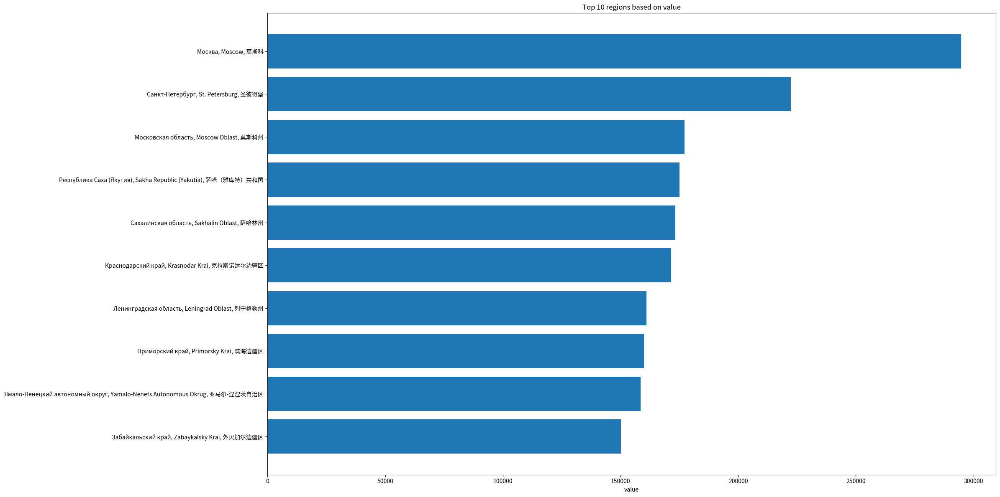

In [20]:
syv.plot_regions_barcharts(df=primary_deals,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_deals")


Построим диаграмму топ-10 регионов по стоимости квадратного метра предложений на первичном рынке.

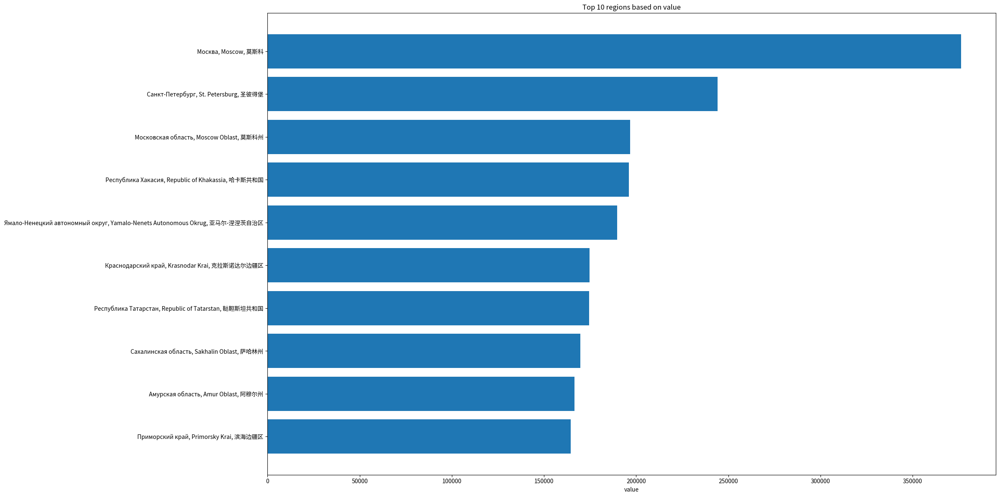

In [21]:
syv.plot_regions_barcharts(df=primary_offers,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_offers")

Построим диаграмму топ-10 регионов по стоимости квадратного метра сделок на вторичном рынке.

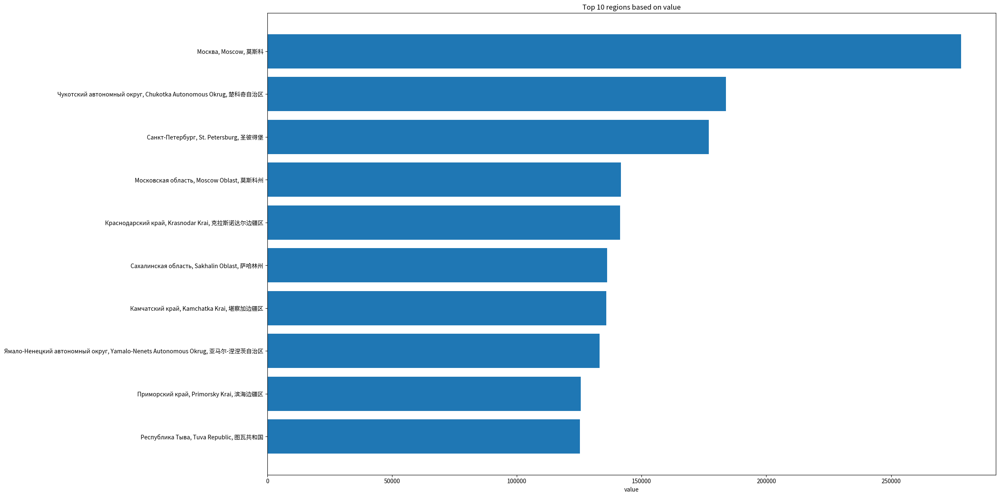

In [22]:
syv.plot_regions_barcharts(df=secondary_deals,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_deals")

Построим диаграмму топ-10 регионов по стоимости квадратного метра предложений на вторичном рынке.

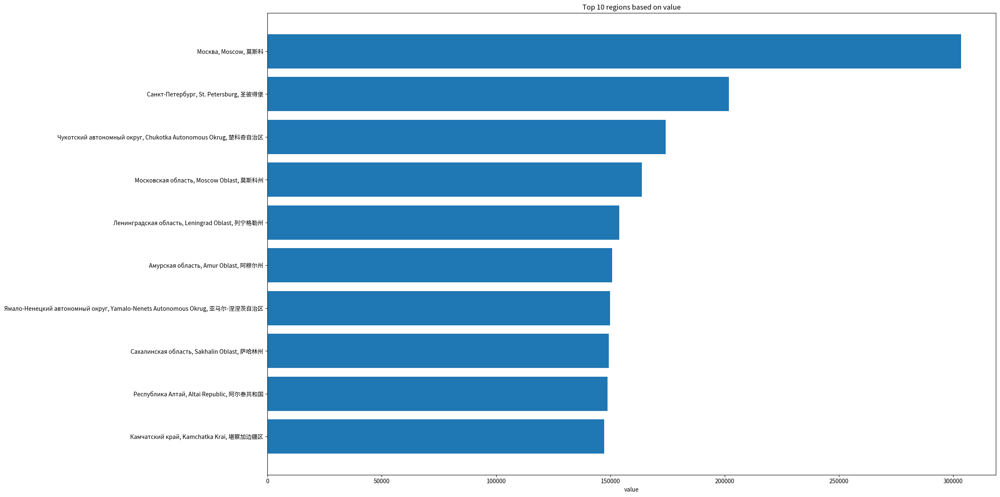

In [23]:
syv.plot_regions_barcharts(df=secondary_offers,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_offers")

Построим диаграмму объёмов предложений на первичном рынке.

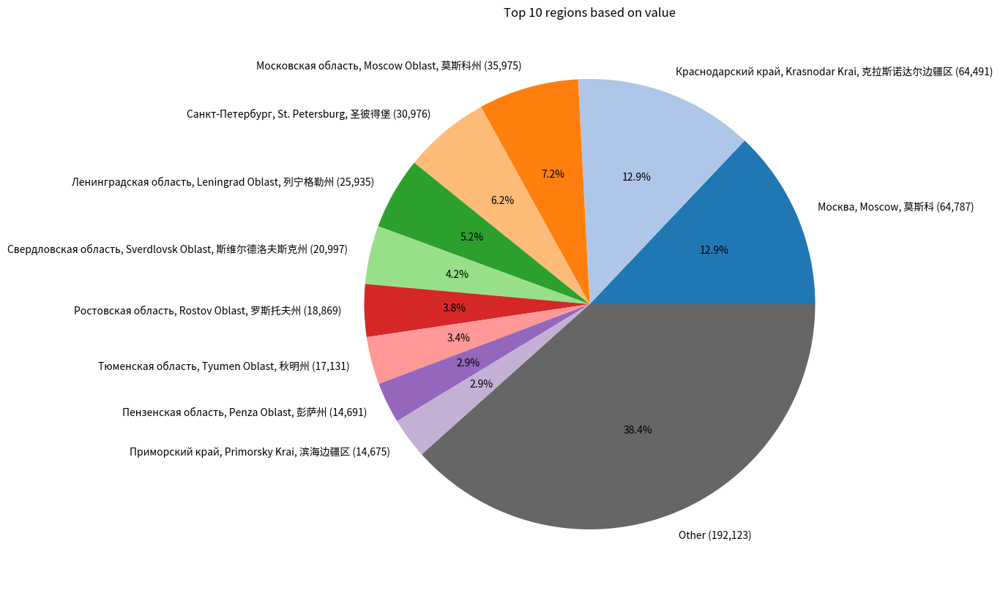

In [24]:
syv.plot_pie_chart(df=primary_volumes,\
                   column='value',\
                   exclude_regions=['Россия, Russia, 俄罗斯'],\
                   num_regions=10,\
                   data_frame_name="primary_volumes")


Построим диаграмму объёмов предложений на вторичном рынке.

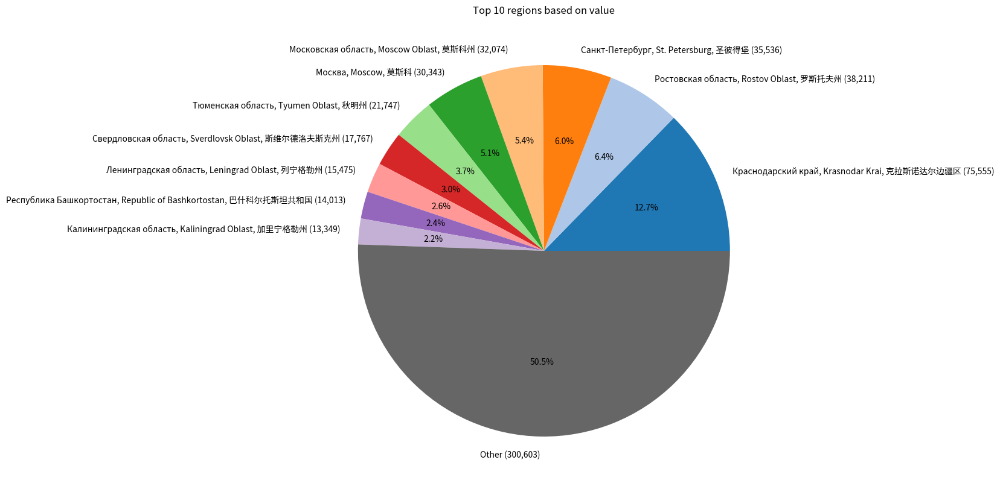

In [25]:
syv.plot_pie_chart(df=secondary_volumes,\
                   column='value',\
                   exclude_regions=['Россия, Russia, 俄罗斯'],\
                   num_regions=10,\
                   data_frame_name="secondary_volumes")

Построим диаграмму топ-10 регионов по ликвидности вторичной недвижимости.

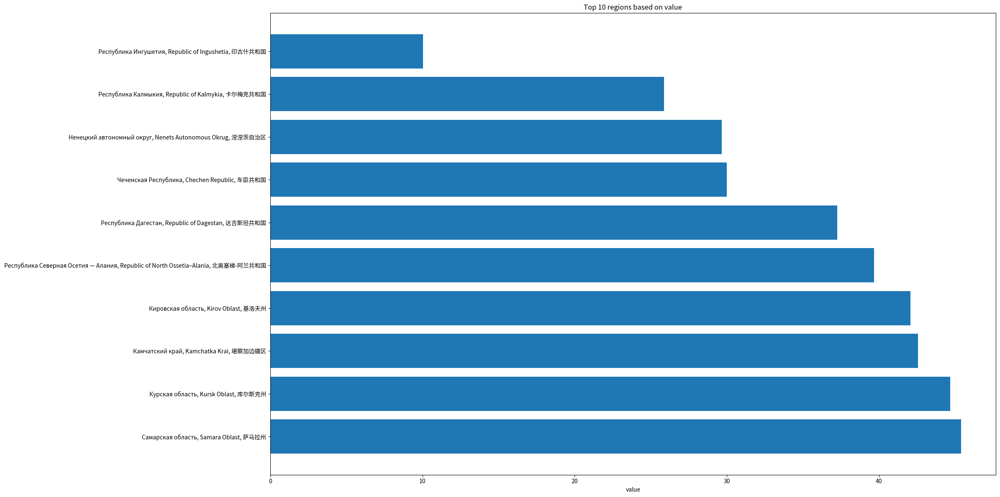

In [26]:
syv.plot_regions_barcharts(df=secondary_exposure,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="secondary_exposure")

Построим диаграмму регионов, где продавцы первичной недвижимости готовы дать наибольшие скидки от цены преложения.

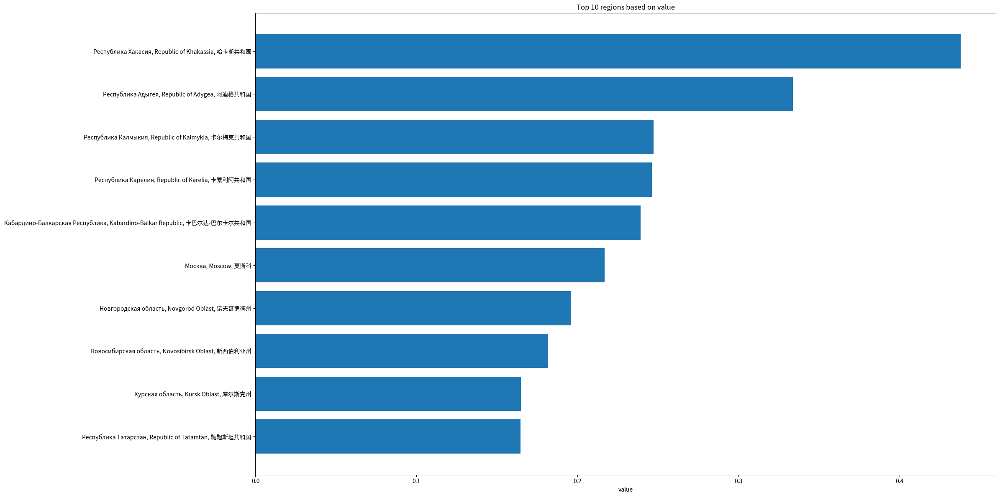

In [27]:
syv.plot_regions_barcharts(df=primary_discounts,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="primary_discounts")

Построим диаграмму регионов, где продавцы вторичной недвижимости готовы дать наибольшие скидки от цены преложения.

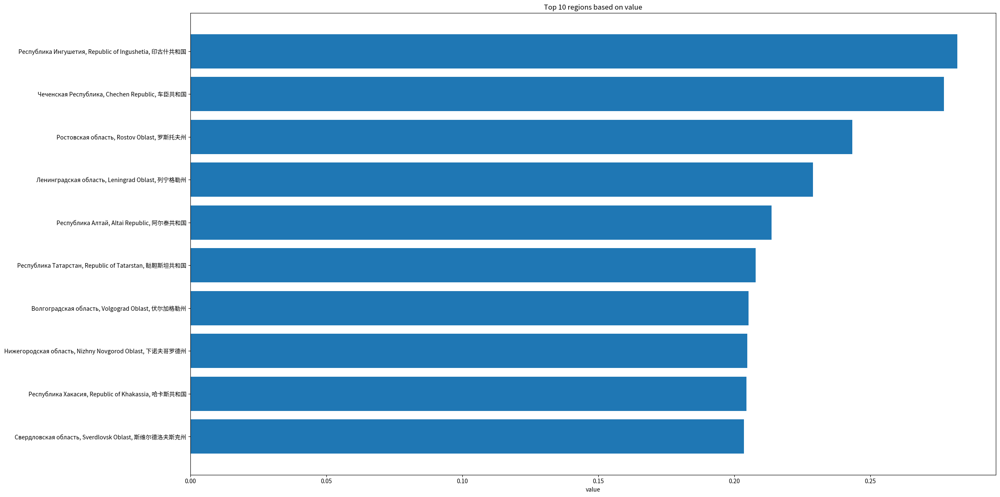

In [28]:
syv.plot_regions_barcharts(df=secondary_discounts,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="secondary_discounts")

Построим диаграмму топ-10 регионов с максимальным отношением цен сделок на первичном рынке к ценам сделок на вторичном рынке

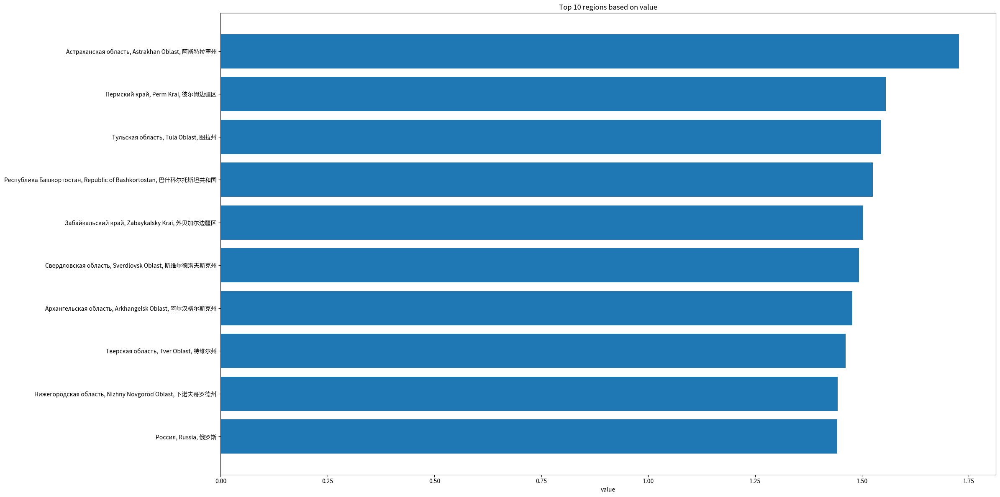

In [29]:
syv.plot_regions_barcharts(df=deals_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="deals_ratios")

Построим диаграмму топ-10 регионов с минимальным отношением цен сделок на первичном рынке к ценам сделок на вторичном рынке.

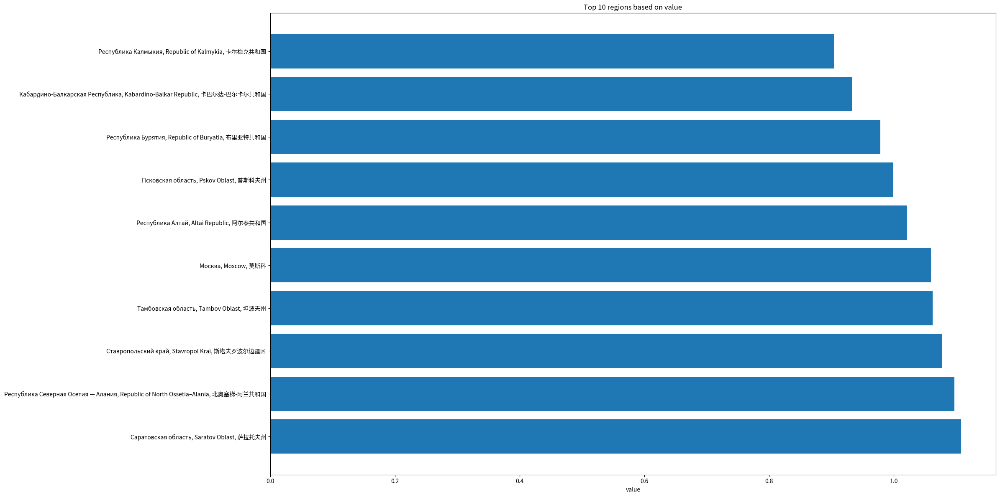

In [30]:
syv.plot_regions_barcharts(df=deals_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="deals_ratios")

Построим диаграмму топ-10 регионов с максимальным отношением цен предложений на первичном рынке к ценам сделок на вторичном рынке.

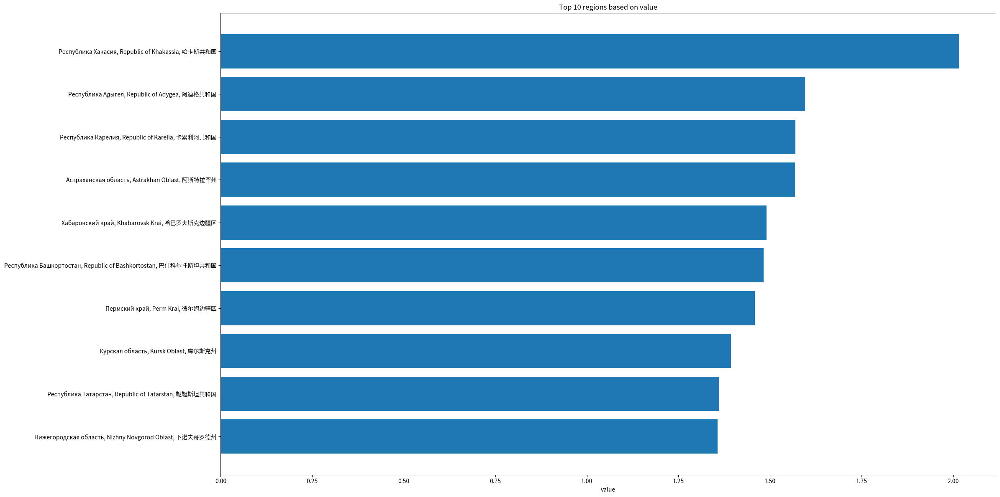

In [31]:
syv.plot_regions_barcharts(df=offers_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="offers_ratios")

Построим диаграмму топ-10 регионов с минимальным отношением цен предложений на первичном рынке к ценам сделок на вторичном рынке.

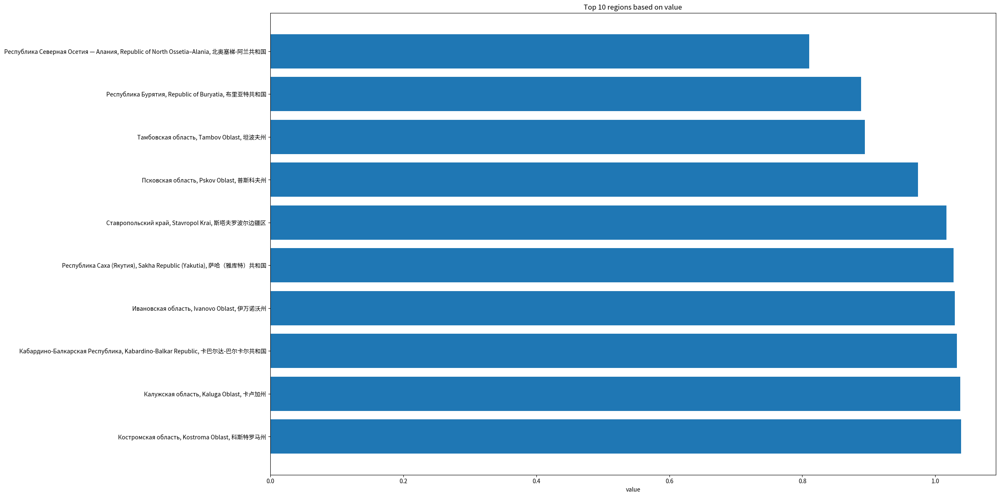

In [32]:
syv.plot_regions_barcharts(df=offers_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="offers_ratios")

Построим диаграмму топ-10 регионов с максимальным отношением объёма предложений на первичном рынке к объёму сделок на вторичном рынке.

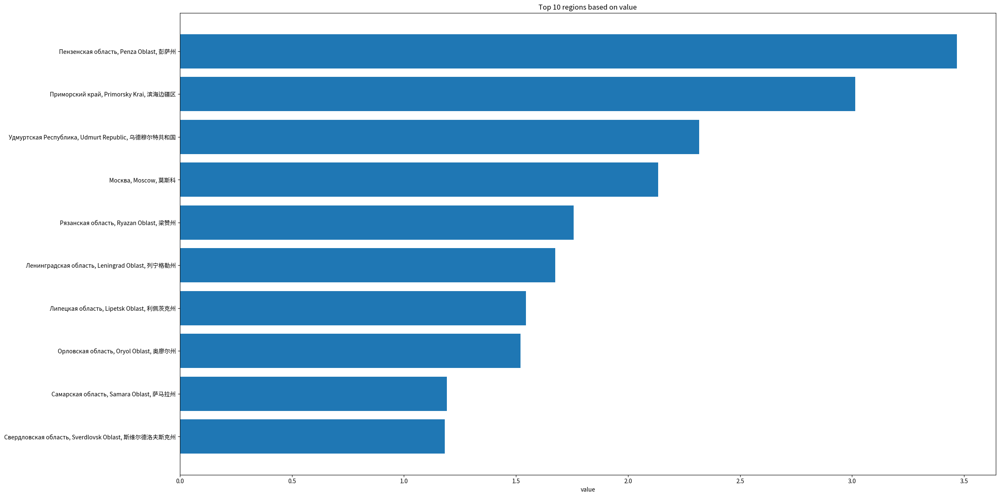

In [33]:
syv.plot_regions_barcharts(df=volumes_ratios,\
                       column='value',\
                       num_regions=10, orientation='top',\
                       data_frame_name="volumes_ratios")

Построим диаграмму топ-10 регионов с минимальным отношением объёма предложений на первичном рынке к объёму сделок на вторичном рынке.

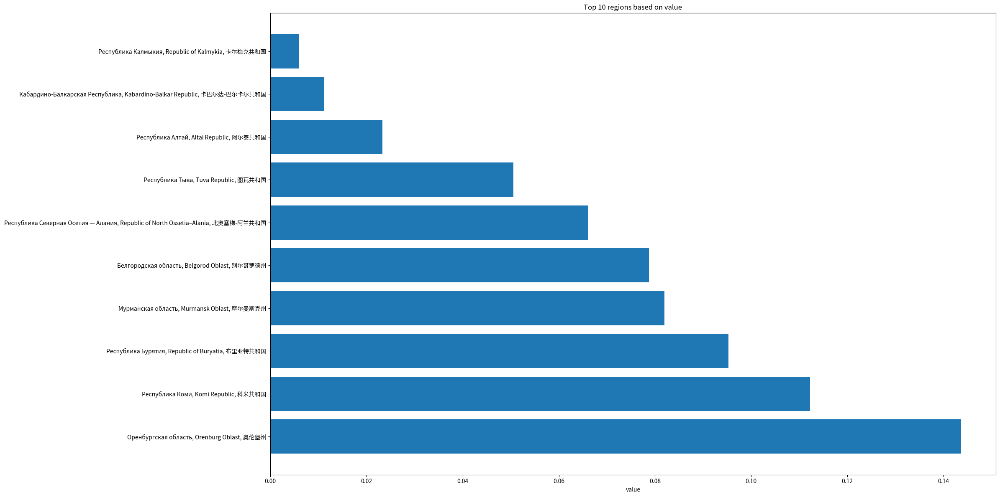

In [34]:
syv.plot_regions_barcharts(df=volumes_ratios,\
                       column='value',\
                       num_regions=10, orientation='bottom',\
                       data_frame_name="volumes_ratios")

### 2.3 Проблемы неравенства регионов

Для анализа неравенства регионов построим диаграммы ядерной оценки плотности (данные графики представляют собой улучшенную более современную версию гистограммы), а также вычислим значения коэффициента Джини для различных индикаторов рынка.

#### 2.3.1 Построение диаграмм ядерной оценки плотности

Построим диаграмму ядерной оценки плотности распределения цен сделок первичных рынков регионов. Синяя линия и закрашенная под ней область &mdash; эмпирические значения ядерной оценки плотности распределения; красная вертикальная прерывистая линиия &mdash; значения показателя для России в целом; красная кривая &mdash; теоретическая кривая нормального распределения, построенного на основе значения для России в качестве среднего и эмпирического стандартного отклонения, рассчитанного на основе данных по регионам.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


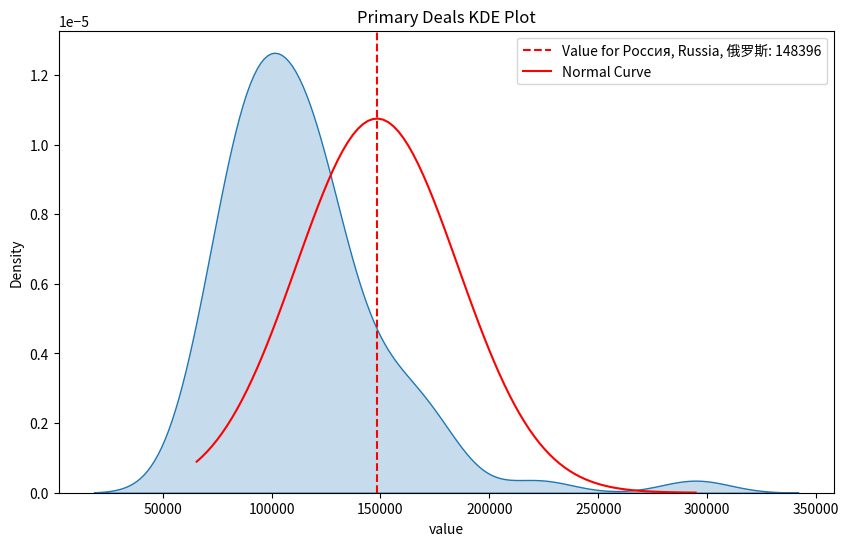

In [35]:
syv.plot_kde_single_column(df=primary_deals,\
                           title="Primary Deals KDE Plot")

Построим диаграмму ядерной оценки плотности распределения цен предложения первичных рынков регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


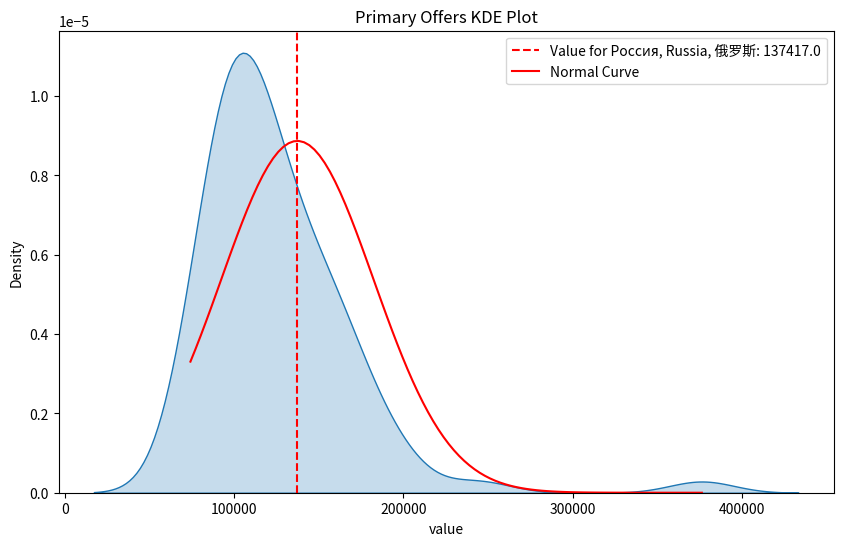

In [36]:
syv.plot_kde_single_column(df=primary_offers,\
                           title="Primary Offers KDE Plot")

Построим диаграмму ядерной оценки плотности распределения цен сделок вторичных рынков регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


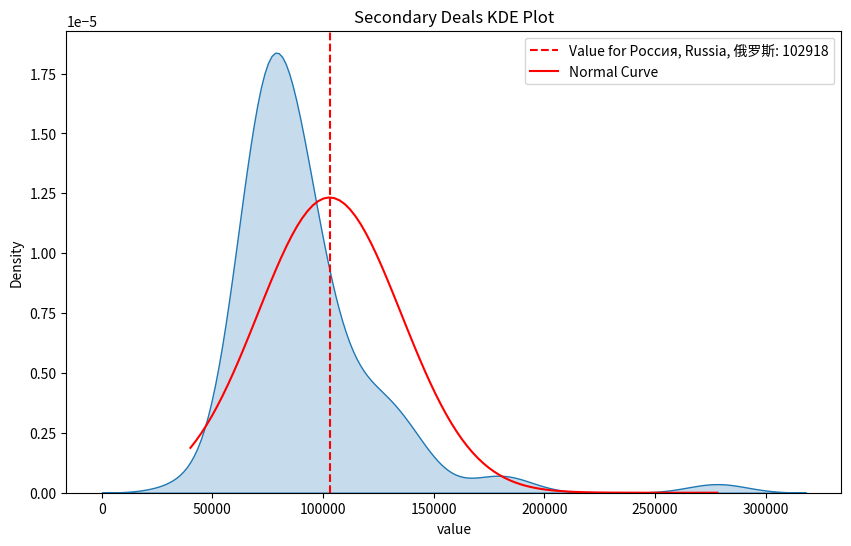

In [37]:
syv.plot_kde_single_column(df=secondary_deals,\
                           title="Secondary Deals KDE Plot")

Построим диаграмму ядерной оценки плотности распределения цен предложения вторичных рынков регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


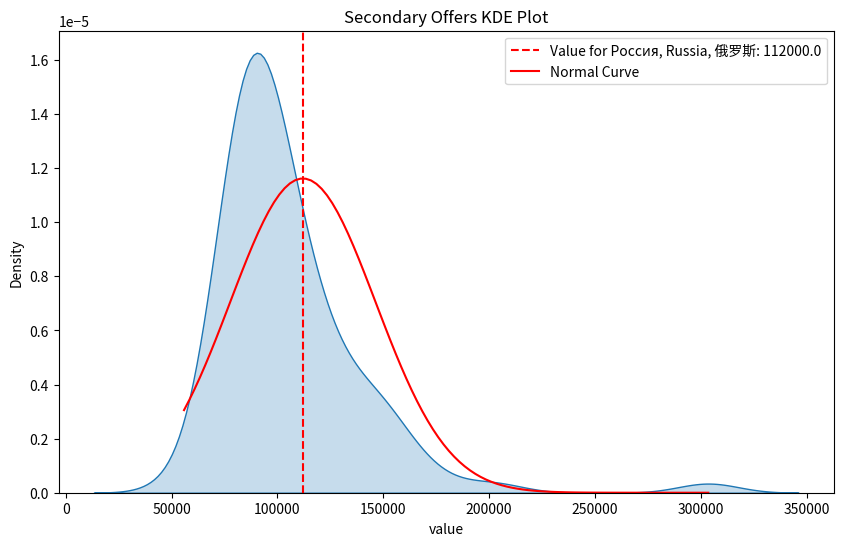

In [38]:
syv.plot_kde_single_column(df=secondary_offers,\
                           title="Secondary Offers KDE Plot")

Построим диаграмму ядерной оценки плотности распределения объёмов предложения первичных рынков регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


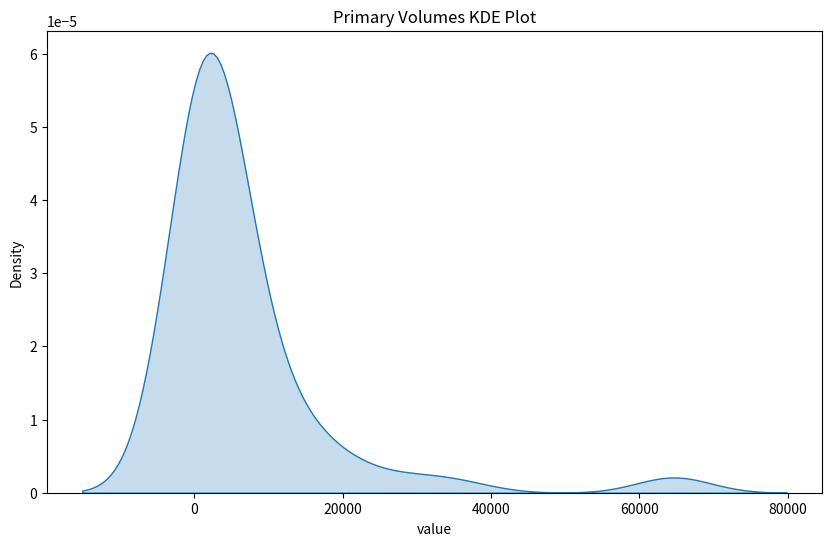

In [39]:
syv.plot_kde_single_column(df=primary_volumes,\
                           title="Primary Volumes KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Построим диаграмму ядерной оценки плотности распределения объёмов предложения вторичных рынков регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


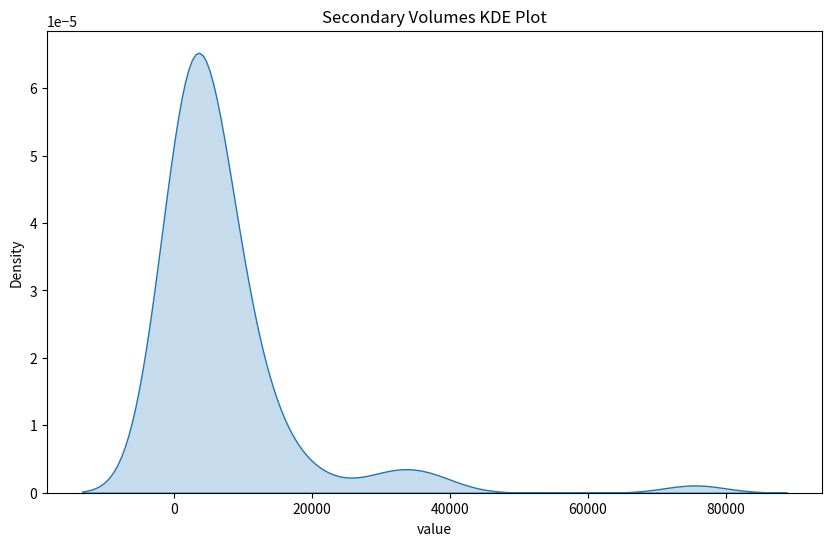

In [40]:
syv.plot_kde_single_column(df=secondary_volumes,\
                           title="Secondary Volumes KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Построим диаграмму ядерной оценки плотности распределения сроков экспозиции на вторичных рынках регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


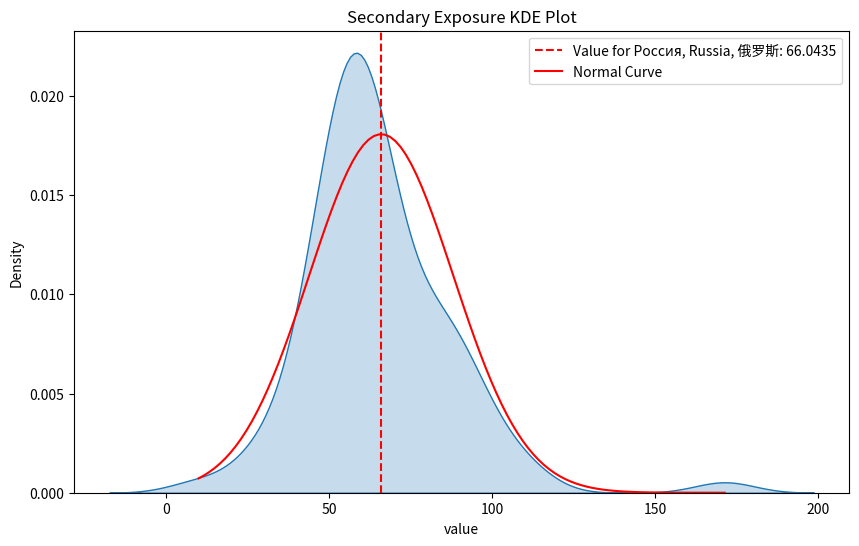

In [41]:
syv.plot_kde_single_column(df=secondary_exposure,\
                           title="Secondary Exposure KDE Plot")

Построим диаграмму ядерной оценки плотности распределения скидок при переходе от цен предложений к ценам сделок на первичных рынках регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


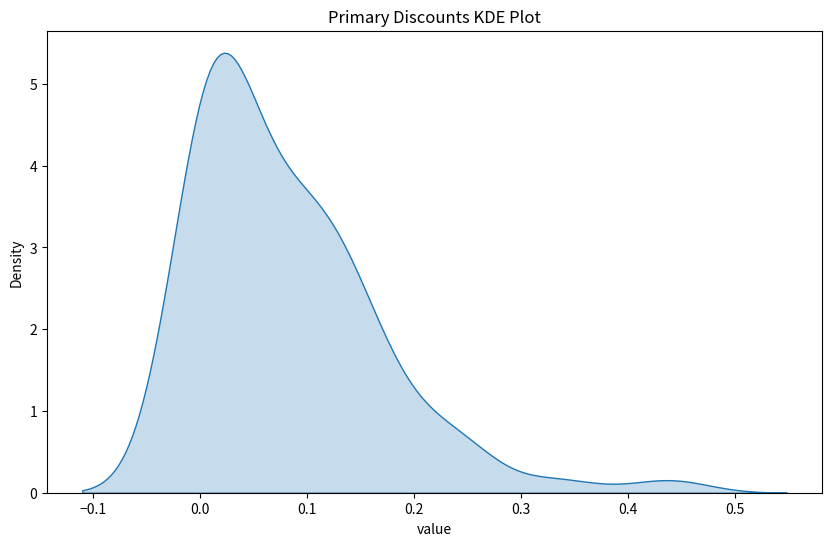

In [42]:
syv.plot_kde_single_column(df=primary_discounts,\
                           title="Primary Discounts KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Построим диаграмму ядерной оценки плотности распределения скидок при переходе от цен предложений к ценам сделок на вторичных рынках регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


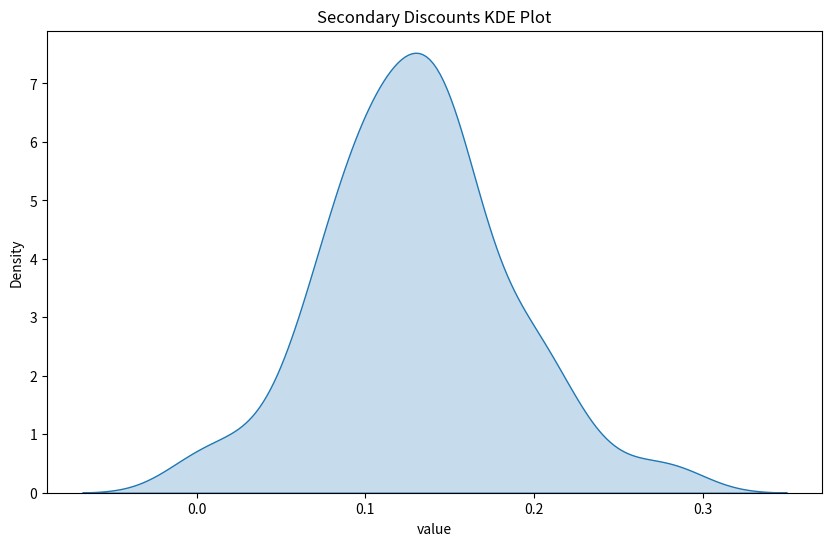

In [43]:
syv.plot_kde_single_column(df=secondary_discounts,\
                           title="Secondary Discounts KDE Plot",\
                           plot_russia_value=False,\
                           plot_normal_curve=False)

Построим диаграмму ядерной оценки плотности отношения средних цен сделок первичного к средним ценам вторичного рынка регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


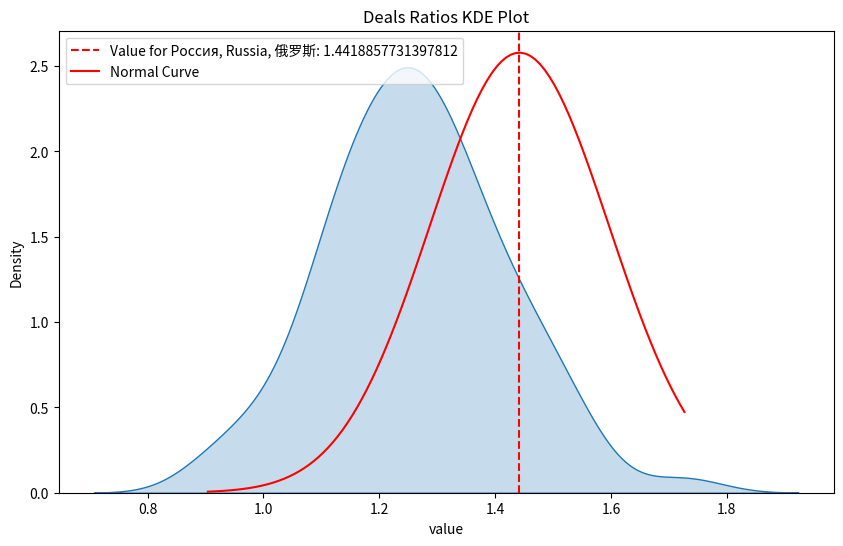

In [44]:
syv.plot_kde_single_column(df=deals_ratios,\
                           title="Deals Ratios KDE Plot")

Построим диаграмму ядерной оценки плотности отношения медианных цен предложений первичного к медианным ценам вторичного рынка регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


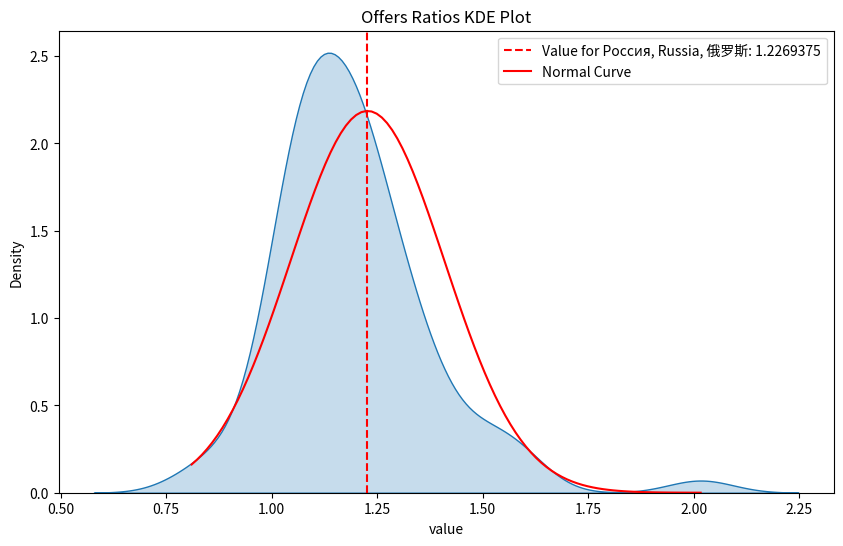

In [45]:
syv.plot_kde_single_column(df=offers_ratios,\
                           title="Offers Ratios KDE Plot")

Построим диаграмму ядерной оценки плотности отношения объёмов предложений первичного к объёмам предложеня вторичного рынка регионов.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


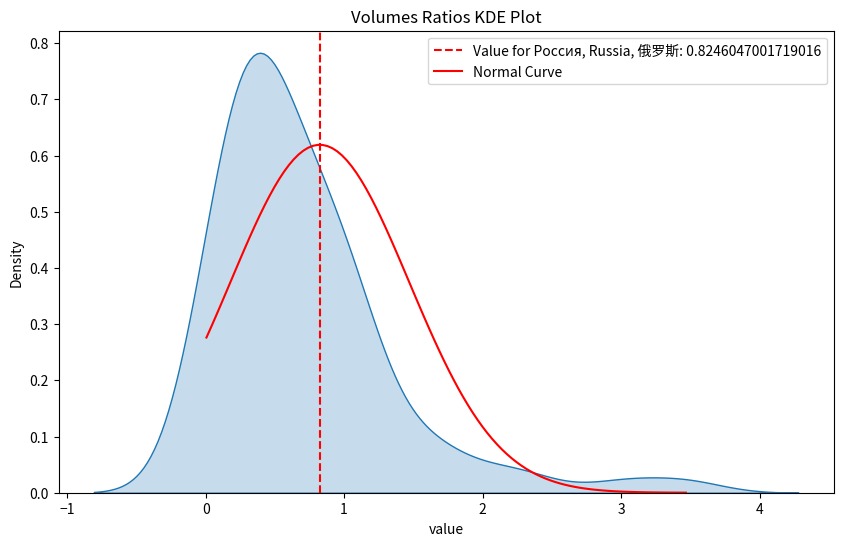

In [46]:
syv.plot_kde_single_column(df=volumes_ratios,\
                           title="Volumes Ratios KDE Plot")

#### 2.3.2 Расчёт коэффициента Джини

Рассчитаем значения коэффициента Джини для фактических и стандартизированных значений. 

In [47]:
gini_df = syv.calculate_gini_coefficients(
    [primary_deals, primary_offers, secondary_deals, secondary_offers,
     primary_volumes, secondary_volumes],
    names=['primary_deals', 'primary_offers', 'secondary_deals', 'secondary_offers',
           'primary_volumes', 'secondary_volumes']
)

gini_df


,data_frame,gini_value,gini_standardized_value
0,primary_deals,0.161416,0.377056
1,primary_offers,0.170702,0.418197
2,secondary_deals,0.158656,0.281014
3,secondary_offers,0.151551,0.322416
4,primary_volumes,0.689320,0.689133
5,secondary_volumes,0.577668,0.580856


## 3 Кластеризация

Кластеризация выполнялась иерархического кластерного анализа. Использовались евклидово расстояние между объектами и дистанция Варда между кластерами. Проведедём кластеризацию на основе стандартизированных значений четырёх ценовых и двух объёмных индикаторов рынков. Кластеризация была выполнена только для регионов, имеющих значения во всех вышеуказанных шести столбцах. 

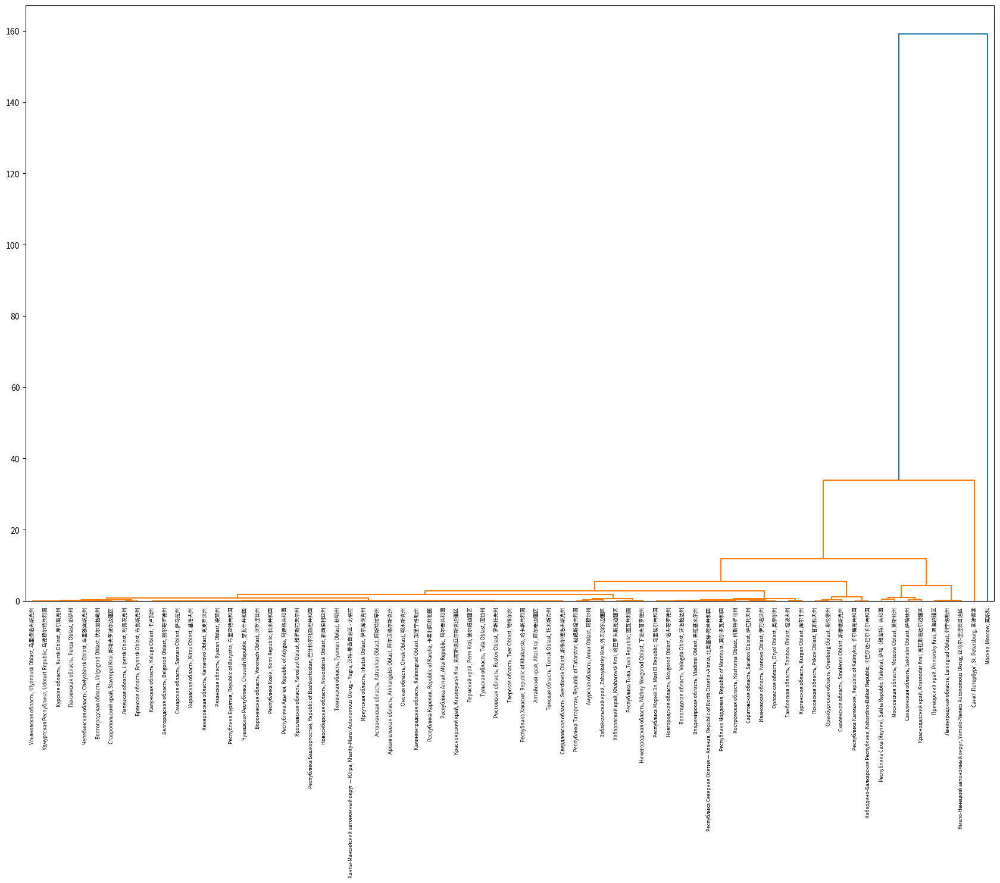

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/sklearn/cluster/_agglomerative.py:1006: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


,region,cluster_label
0,"Санкт-Петербург, St. Petersburg, 圣彼得堡",2
1,"Ленинградская область, Leningrad Oblast, 列宁格勒州",0
2,"Москва, Moscow, 莫斯科",3
3,"Московская область, Moscow Oblast, 莫斯科州",0
4,"Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区",0
5,"Алтайский край, Altai Krai, 阿尔泰边疆区",1
6,"Амурская область, Amur Oblast, 阿穆尔州",1
7,"Архангельская область, Arkhangelsk Oblast, 阿尔汉...",1
8,"Астраханская область, Astrakhan Oblast, 阿斯特拉罕州",1
9,"Белгородская область, Belgorod Oblast, 别尔哥罗德州",1


In [48]:
# List of data frames to be used in clustering
data_frames_to_cluster = [primary_deals, primary_offers, secondary_deals, secondary_offers, primary_volumes, secondary_volumes]

# Columns to be used in clustering
columns_to_cluster = ['standardized_value']

# Number of clusters
num_clusters = 5

# Affinity
affinity_type = 'euclidean'

# Linkage method
linkage_method = 'ward'

# Calling the hierarchical_clustering function
clustered_data_hier = syv.hierarchical_clustering(data_frames=data_frames_to_cluster, 
                                        columns=columns_to_cluster, 
                                        n_clusters=num_clusters, 
                                        affinity=affinity_type, 
                                        linkage_method=linkage_method)

# Displaying the resulting DataFrame with cluster labels
clustered_data_hier


Результаты кластеризации можно интерпретировать, в том числе, следующим образом:

|||
| --- | --- |
|Номер кластера|Описание|
|3|Данный кластер включает в себя единственный регион &mdash; город Москва, являющийся [глобальным альфа-городом](https://en.wikipedia.org/wiki/Global_city)  и имеющий исключительно высокие показатели развития рынка жилой недвижимости|
|2|Данный кластер включает в себя единственный регион &mdash; город Санкт-Петербург, являющийся [глобальным бета-городом](https://en.wikipedia.org/wiki/Globalization_and_World_Cities_Research_Network) и также имеющий высокие показатели развития рынка жилой недвижимости равно как и стандарты жизни|
|0|Даный кластер включает в себя как благополучные регионы с высоким уровнем жизни (например, Ленинградская область и Краснодарский край), так и регионы с 'северным' уровнем номинальных зарплат, увеличивающим номинальные цены без реального содержания с точки зрения качества жизни (например, Якутия) |
|1|Данный кластер включает основную массу регионов со средним уровнем развития рынка недвижимости|
|4|Данный кластер включает регионы с относительно низкими уровнем развития рынка недвижимости и качеством жизни|
|Без номера|Оставшиеся регионы характеризуются относительно малым количеством объектов недвижимости, вследствие чего их невозможно отнести к одномуиз кластеров|

Следует отметить, что нумерация кластеров сама по себе не имеет осмысленной трактовки и носит технический характер, связанный с моментом первого объединения регионов в кластере.

## 4 Геоанализ

Построим тепловые карты различных индикаторов в разрезе регионов. Версии карт в высоком разрешении, а также интерактивные масштабируемые карты доступны по ссылкам выше. Всего будет построено 13 тепловых карт. Ценовые индикаторы выражены в номинальных рублях.

|Индикатор|Название карты и соответсвующего файла в [каталоге](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg)|
| --- | --- |
|Средняя цена сделки на первичном рынке|Primary Deals|
|Средняя цена сделки на вторичном рынке|Secondary Deals|
|Медианная цена предложения на первичном рынке|Primary Offers|
|Медианная цена предложения на вторичном рынке|Secondary Offers|
|Объём предложения на первичном рынке|Primary Volumes|
|Объём предложения на вторичном рынке|Secondary Volumes|
|Средний срок экпозиции квартиры на вторичном рынке|Secondary Exposure|
|Типичная скидка при переходе от цены предложения к цене сделки на первичном рынке|Primary Discounts|
|Типичная скидка при переходе от цены предложения к цене сделки на вторичном рынке|Secondary Discounts|
|Отношение средних цен сделок на первичном рынке к аналогичному показателю на вторичном рынке|Deals Ratios|
|Отношение медианных цен предложения на первичном рынке к аналогичному показателю на вторичном рынке|Offers Ratios|
|Отношение объёма предложения на первичном рынке к аналогичному показателю на вторичном рынке|Volumes Ratios|
|Отношение типичной скидки при переходе от цены предложения к цене сделки на первичном рынке к аналогичному показателю на вторичном рынке|Discounts Ratios|


### 4.1 Статичные карты

Получаем GeoJSON с координатами границ и полигонами регионов.

In [49]:
# Load the default GeoJSON data
gdf = syv.get_rf_geojson()
# Keeping only the 'name' and 'geometry' columns
gdf = gdf[['name', 'geometry']]
# Unify column names
gdf.rename(columns={'name': 'region'}, inplace=True)


Проверка целостности данных.

In [50]:
primary_deals, secondary_deals, primary_offers, secondary_offers,\
primary_volumes, secondary_volumes, secondary_exposure,\
primary_discounts, secondary_discounts, deals_ratios,\
offers_ratios, volumes_ratios, discounts_ratios = syv.check_consistency(
    primary_deals, 
    secondary_deals, 
    primary_offers, 
    secondary_offers,
    primary_volumes,
    secondary_volumes,
    secondary_exposure,
    primary_discounts,
    secondary_discounts,
    deals_ratios,
    offers_ratios,
    volumes_ratios,
    discounts_ratios
)

Находим и испраляем несоответствия в названиях регионов из базы Sberindex и GeoJSON.

In [51]:
# Harmonize regions names
geojson_regions = syv.get_all_regions_from_geojson(gdf)
gdf = syv.harmonize_geojson_names(gdf)
primary_deals = syv.harmonize_sql_names(primary_deals)
secondary_deals = syv.harmonize_sql_names(secondary_deals)
primary_offers = syv.harmonize_sql_names(primary_offers)
secondary_offers = syv.harmonize_sql_names(secondary_offers)
primary_volumes = syv.harmonize_sql_names(primary_volumes)
secondary_volumes = syv.harmonize_sql_names(secondary_volumes)
secondary_exposure = syv.harmonize_sql_names(secondary_exposure)
primary_discounts = syv.harmonize_sql_names(primary_discounts)
secondary_discounts = syv.harmonize_sql_names(secondary_discounts)
deals_ratios = syv.harmonize_sql_names(deals_ratios)
offers_ratios = syv.harmonize_sql_names(offers_ratios)
volumes_ratios = syv.harmonize_sql_names(volumes_ratios)
discounts_ratios = syv.harmonize_sql_names(discounts_ratios)

# Create object
sberindex_regions = syv.get_all_regions_from_sql(primary_deals,\
                                                 secondary_deals,\
                                                 primary_offers,\
                                                 secondary_offers,\
                                                 primary_volumes,\
                                                 secondary_volumes,\
                                                 secondary_exposure,\
                                                 primary_discounts,\
                                                 secondary_discounts,\
                                                 deals_ratios,\
                                                 offers_ratios,\
                                                 volumes_ratios,\
                                                 discounts_ratios
                                                )

# Remove redundant regions
gdf = syv.remove_redundant_from_geojson(gdf)

# Create list of regions from GeoJSON
geojson_regions = syv.get_all_regions_from_geojson(gdf)

# Recreate object
sberindex_regions = syv.get_all_regions_from_sql(primary_deals,\
                                                 secondary_deals,\
                                                 primary_offers,\
                                                 secondary_offers,\
                                                 primary_volumes,\
                                                 secondary_volumes,\
                                                 secondary_exposure,\
                                                 primary_discounts,\
                                                 secondary_discounts,\
                                                 deals_ratios,\
                                                 offers_ratios,\
                                                 volumes_ratios,\
                                                 discounts_ratios
                                                )

Сравним перечни регионов от Sberindex и в GeoJSON.

In [52]:
mismatches_sql_geojson, mismatches_geojson_sql = syv.find_region_mismatches(sberindex_regions, geojson_regions)

print("Regions in data frames but not in GeoJSON:", mismatches_sql_geojson)
print("Regions in GeoJSON but not in data frames:", mismatches_geojson_sql)

Regions in data frames but not in GeoJSON: ['Россия, Russia, 俄罗斯']
Regions in GeoJSON but not in data frames: []


Определим перечень карт для построения

In [53]:
# Add to datasets
datasets_plt = [
    (primary_deals, 'value', 'Primary Deals', 'primary_deals.png'),
    (secondary_deals, 'value', 'Secondary Deals', 'secondary_deals.png'),
    (primary_offers, 'value', 'Primary Offers', 'primary_offers.png'),
    (secondary_offers, 'value', 'Secondary Offers', 'secondary_offers.png'),
    (primary_volumes, 'value', 'Primary Volume', 'primary_volumes.png'),
    (secondary_volumes, 'value', 'Secondary Volume', 'secondary_volumes.png'),
    (secondary_exposure, 'value', 'Secondary Exposure', 'secondary_exposure.png'),
    (primary_discounts, 'value', 'Primary Discount Rate', 'primary_discount.png'),
    (secondary_discounts, 'value', 'Secondary Discount Rate', 'secondary_discount.png'),
    (deals_ratios, 'value', 'Primary to Secondary Market Deals Ratios', 'deals_ratios.png'),
    (offers_ratios, 'value', 'Primary to Secondary Market Offers Ratios', 'offers_ratios.png'),
    (volumes_ratios, 'value', 'Primary to Secondary Market Volumes Ratios', 'volumes_ratios.png'),
    (discounts_ratios, 'value', 'Primary to Secondary Market Discounts Ratios', 'discounts_ratios.png')
]


Скорректируем координаты для построения карты с Чукоткой, частично расположенной в другом полушарии.

In [54]:
shifted_gdf = syv.shift_geometry(gdf.copy())

Построим статичные тепловые карты 13 индикаторов рынка жилой недвижимости в России на дату исследования. Данные карты в виде отдельных файлов доступны по [ссылке](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg).

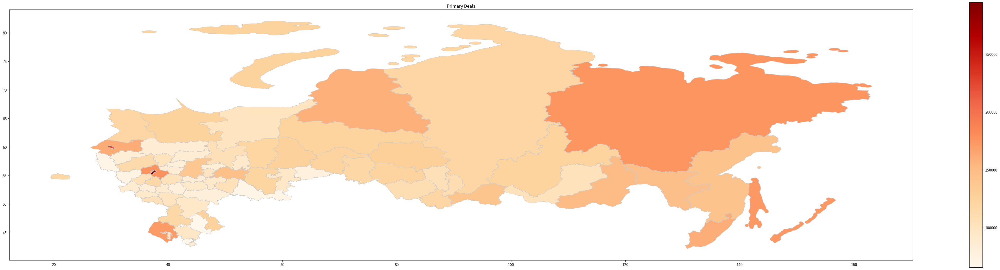

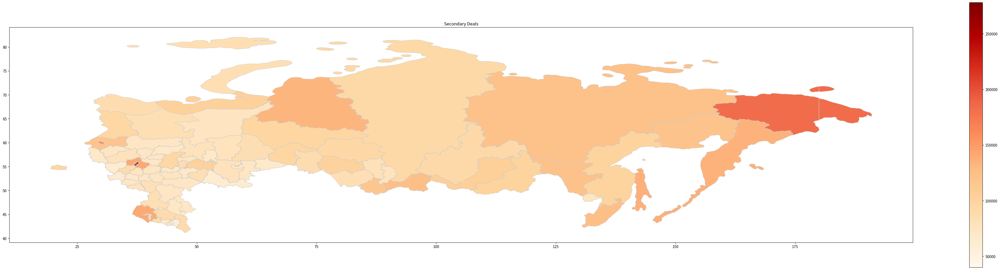

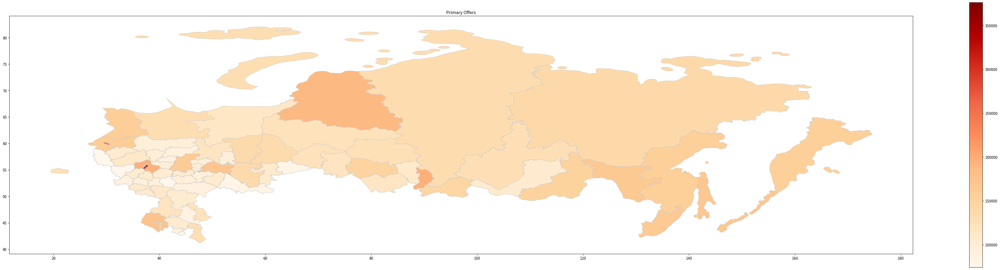

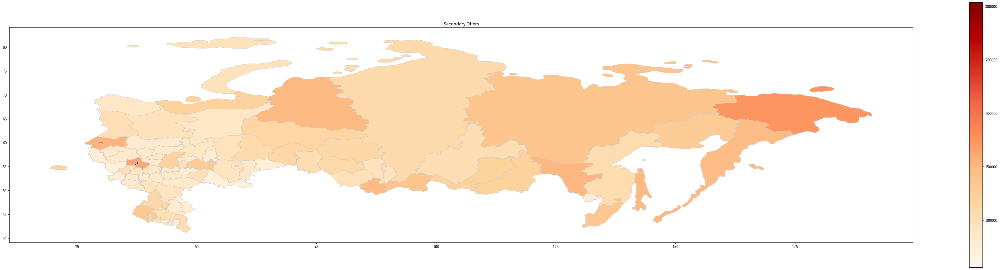

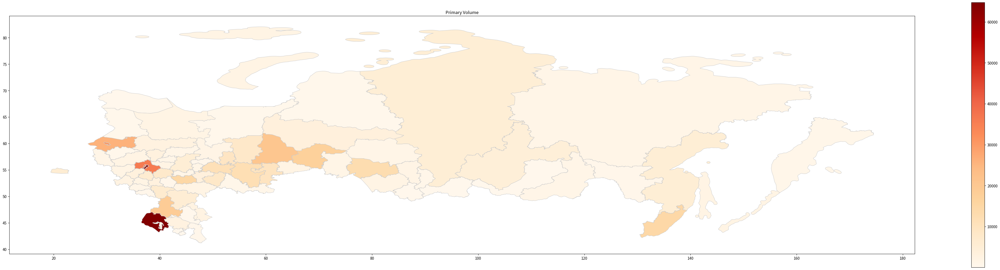

...

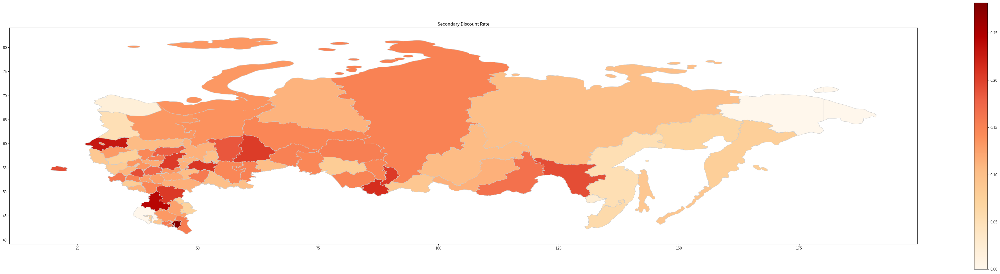

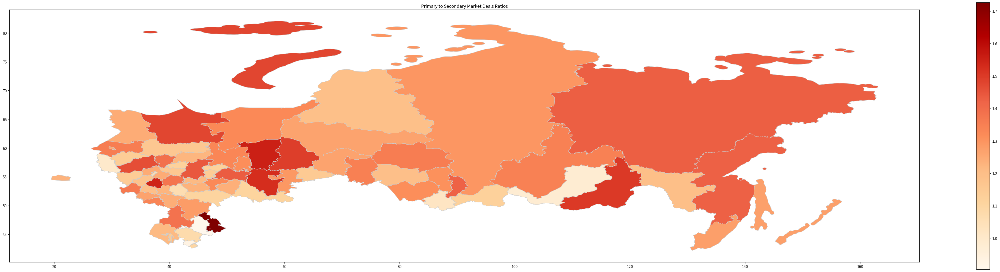

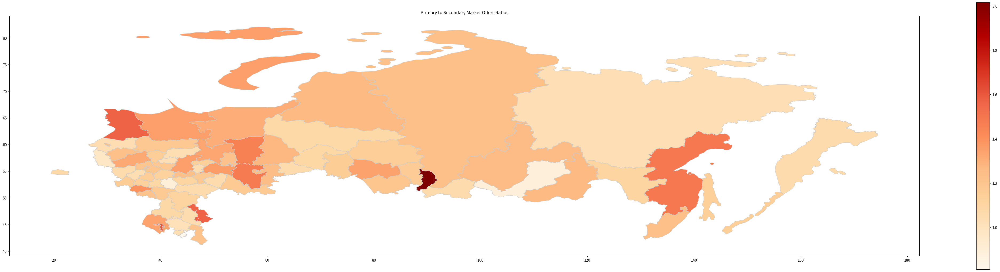

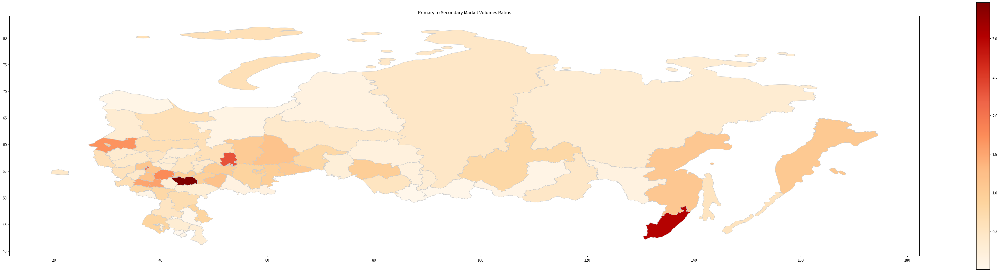

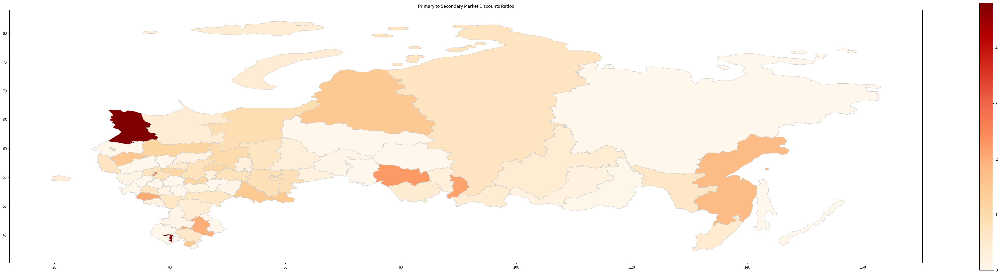

In [55]:
# Looping over each dataset in datasets_plt
for data, column_name, display_name, filename in datasets_plt:
    # Calling the function with the appropriate arguments
    syv.create_and_display_heatmaps_sberindex(data, column_name, display_name, filename, shifted_gdf)


### 4.2 Интерактивные карты

Построим также интерактивные карты. Они доступны по [ссылке](https://web.tresorit.com/l/RTdE4#_8WMDnK6hjXgVfSPD5-mlg).

In [56]:
# Add to datasets
datasets_folium = [
    (primary_deals, 'value', 'Primary Deals', 'primary_deals.png'),
    (secondary_deals, 'value', 'Secondary Deals', 'secondary_deals.png'),
    (primary_offers, 'value', 'Primary Offers', 'primary_offers.png'),
    (secondary_offers, 'value', 'Secondary Offers', 'secondary_offers.png'),
    (primary_volumes, 'value', 'Primary Volume', 'primary_volumes.png'),
    (secondary_volumes, 'value', 'Secondary Volume', 'secondary_volumes.png'),
    (secondary_exposure, 'value', 'Secondary Exposure', 'secondary_exposure.png'),
    (primary_discounts, 'value', 'Primary Discount Rate', 'primary_discount.png'),
    (secondary_discounts, 'value', 'Secondary Discount Rate', 'secondary_discount.png'),
    (deals_ratios, 'value', 'Primary to Secondary Market Deals Ratios', 'deals_ratios.png'),
    (offers_ratios, 'value', 'Primary to Secondary Market Offers Ratios', 'offers_ratios.png'),
    (volumes_ratios, 'value', 'Primary to Secondary Market Volumes Ratios', 'volumes_ratios.png'),
    (discounts_ratios, 'value', 'Primary to Secondary Market Discounts Ratios', 'discounts_ratios.png')
]

In [57]:
for data, column_name, display_name, filename in datasets_folium:
    syv.create_and_save_choropleth_sberindex(data, column_name, display_name, gdf, display_name)


## 5 Анализ временных рядов

### 5.1 Подготовка данных

Создание дата фреймов, содержащих данные за весь период наблюдений на стороне Sberindex. Проверка целостности.

In [58]:
# Fetch data for the entire period
primary_deals_ts, secondary_deals_ts, primary_offers_ts,\
secondary_offers_ts, primary_volumes_ts, secondary_volumes_ts,\
secondary_exposure_ts = syv.read_sberindex_flats()

# Check data
primary_deals_ts, secondary_deals_ts, primary_offers_ts,\
secondary_offers_ts, primary_volumes_ts, secondary_volumes_ts,\
secondary_exposure_ts = syv.check_consistency(primary_deals_ts,\
                                              secondary_deals_ts,\
                                              primary_offers_ts,\
                                              secondary_offers_ts,\
                                              primary_volumes_ts,\
                                              secondary_volumes_ts,\
                                              secondary_exposure_ts)


Расчёт скидок при переходе от цен предложений к ценам сделок.

In [59]:
primary_discount_rates_ts = syv.calculate_discount_rates_ts(primary_deals_ts, primary_offers_ts, 'primary')
secondary_discount_rates_ts = syv.calculate_discount_rates_ts(secondary_deals_ts, secondary_offers_ts, 'secondary')

Расчёт соотношений между первичным и вторичным рынками.

In [60]:
deals_ratios_ts = syv.calculate_market_ratios_ts(primary_deals_ts, secondary_deals_ts, 'value')
offers_ratios_ts = syv.calculate_market_ratios_ts(primary_offers_ts, secondary_offers_ts, 'value')
volumes_ratios_ts = syv.calculate_market_ratios_ts(primary_volumes_ts, secondary_volumes_ts, 'value')
discounts_ratios_ts = syv.calculate_market_ratios_ts(primary_discount_rates_ts, secondary_discount_rates_ts, 'value')

Расчёт гэпов между первичным и вторичным рынками.

In [61]:
deals_gaps_ts = syv.calculate_market_gaps_ts(primary_deals_ts, secondary_deals_ts, 'value')
offers_gaps_ts = syv.calculate_market_gaps_ts(primary_offers_ts, secondary_offers_ts, 'value')
volumes_gaps_ts = syv.calculate_market_gaps_ts(primary_volumes_ts, secondary_volumes_ts, 'value')
discounts_gaps_ts = syv.calculate_market_gaps_ts(primary_discount_rates_ts, secondary_discount_rates_ts, 'value')

Расчёт коэффициента Джини для индикаторов.

In [62]:
primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.calculate_gini_over_time(primary_deals_ts,\
                                                          primary_offers_ts,\
                                                          secondary_deals_ts,\
                                                          secondary_offers_ts,\
                                                          primary_volumes_ts,\
                                                          secondary_volumes_ts,\
                                                          secondary_exposure_ts)

primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.sort_dataframe_by_date(primary_deals_gini_ts,\
                                                            primary_offers_gini_ts,\
                                                            secondary_deals_gini_ts,\
                                                            secondary_offers_gini_ts,\
                                                            primary_volumes_gini_ts,\
                                                            secondary_volumes_gini_ts,\
                                                            secondary_exposure_gini_ts)

primary_deals_gini_ts, primary_offers_gini_ts, secondary_deals_gini_ts,\
secondary_offers_gini_ts, primary_volumes_gini_ts, secondary_volumes_gini_ts,\
secondary_exposure_gini_ts = syv.convert_date_to_month_year(primary_deals_gini_ts,\
                                                            primary_offers_gini_ts,\
                                                            secondary_deals_gini_ts,\
                                                            secondary_offers_gini_ts,\
                                                            primary_volumes_gini_ts,\
                                                            secondary_volumes_gini_ts,\
                                                            secondary_exposure_gini_ts)

### 5.2 Анализ номинальных рублёвых и физических индикаторов

#### 5.2.1 Номинальные рублёвые цены

Построим графики динамики номинальных цен для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

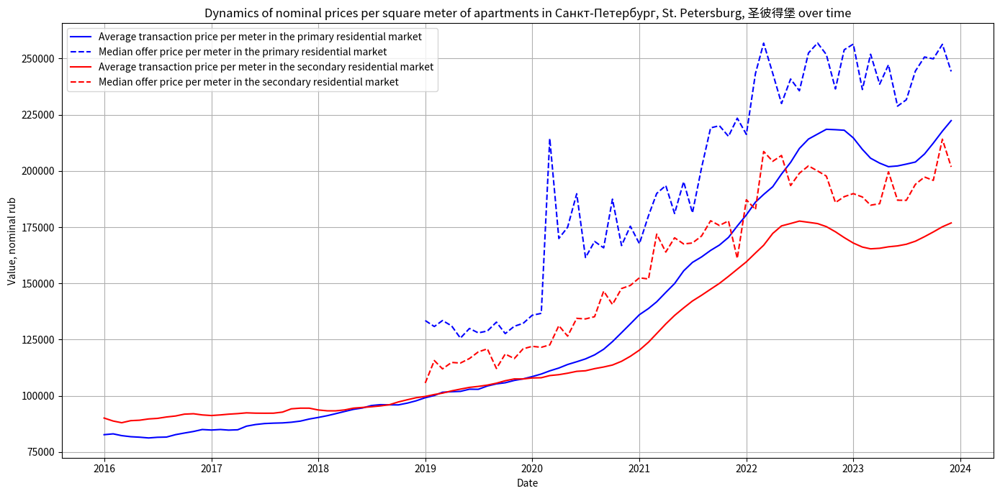

In [63]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Санкт-Петербург, St. Petersburg, 圣彼得堡')

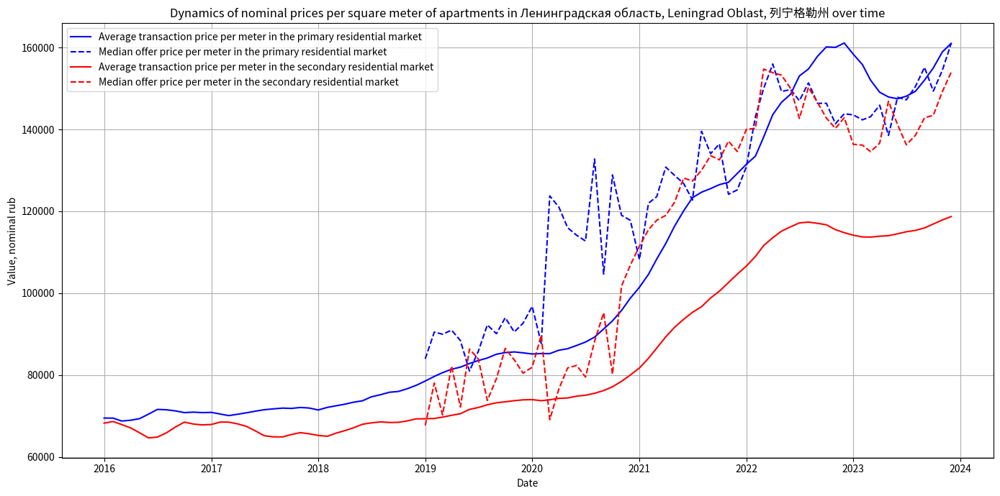

In [64]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Ленинградская область, Leningrad Oblast, 列宁格勒州')

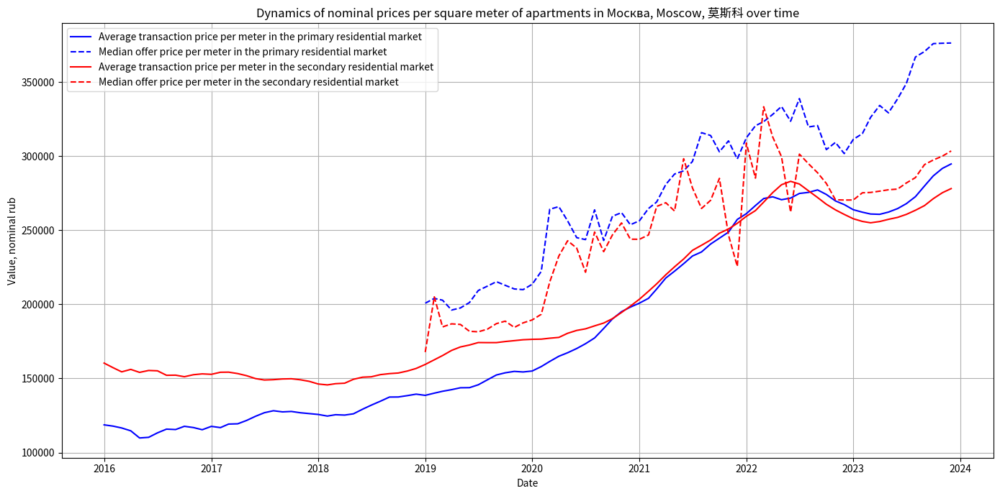

In [65]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Москва, Moscow, 莫斯科')

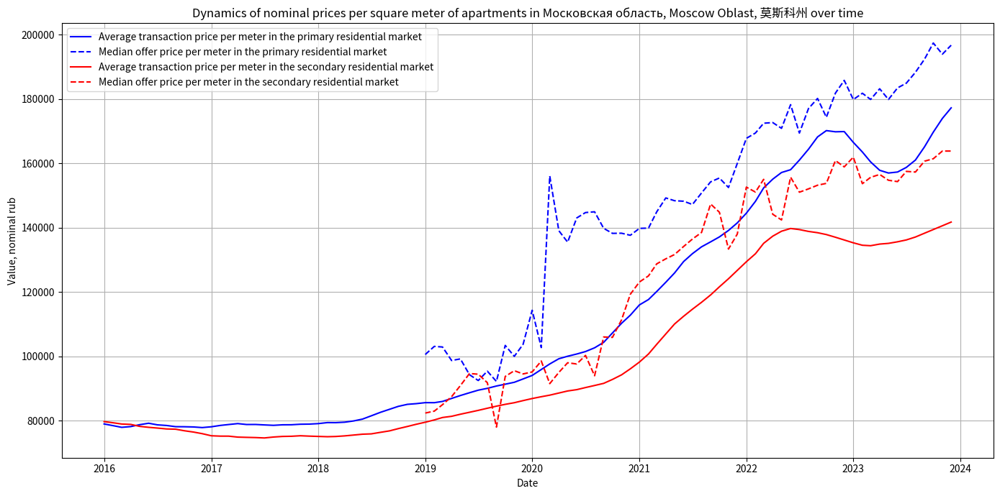

In [66]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Московская область, Moscow Oblast, 莫斯科州')

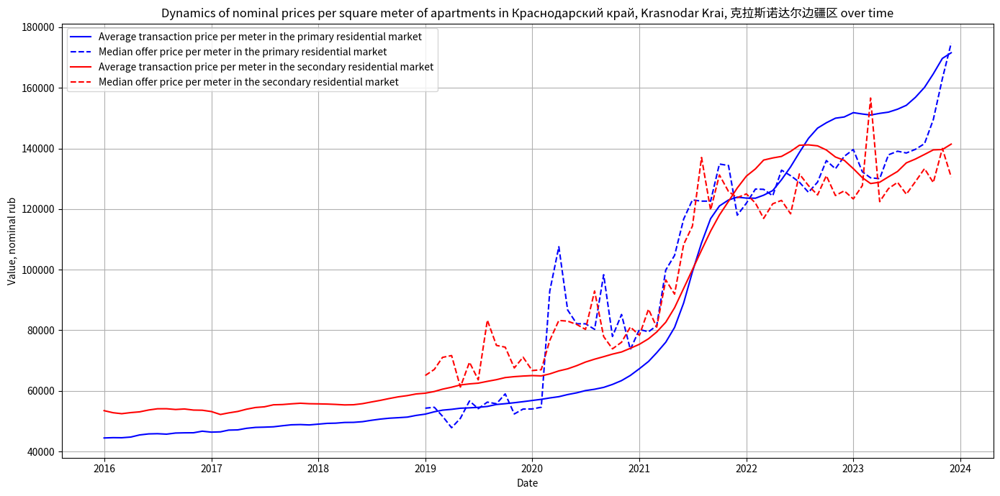

In [67]:
syv.plot_market_price_indicators(primary_deals_ts,
                                 primary_offers_ts,
                                 secondary_deals_ts,
                                 secondary_offers_ts,
                                 'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [68]:
syv.save_prices_plots(primary_deals_ts, primary_offers_ts,\
                      secondary_deals_ts, secondary_offers_ts,\
                      column_name='value')

#### 5.2.2 Объёмы

Построим графики динамики объёмов в лотах для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

In [69]:
volume_labels = ['Primary market', 'Secondary market']

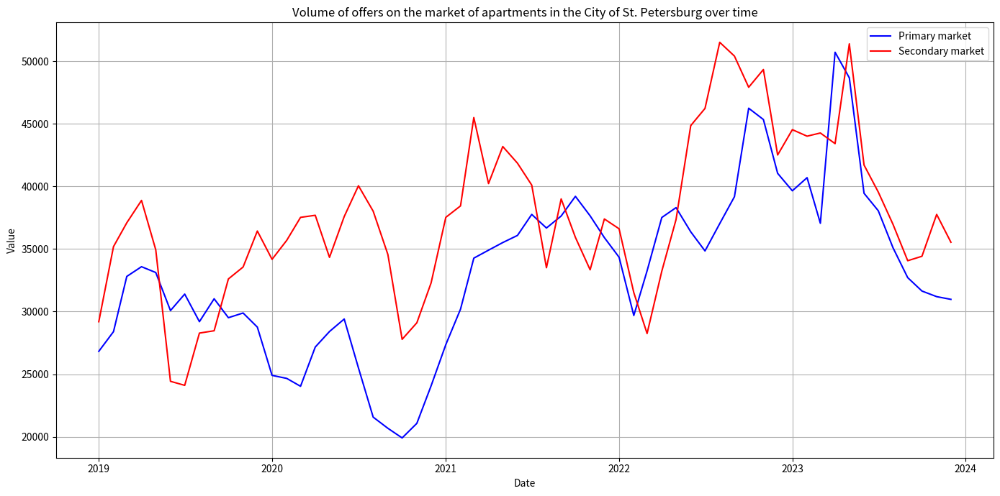

In [70]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in the City of St. Petersburg over time')

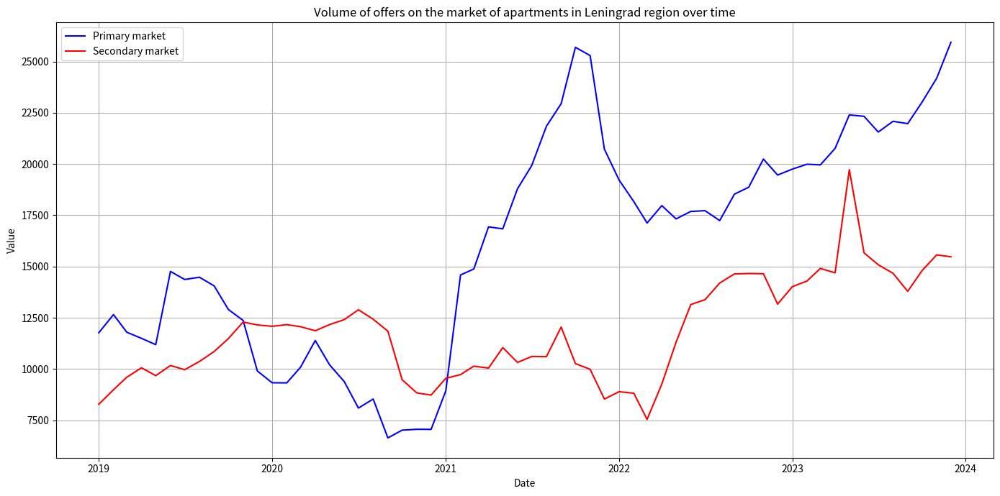

In [71]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Leningrad region over time')

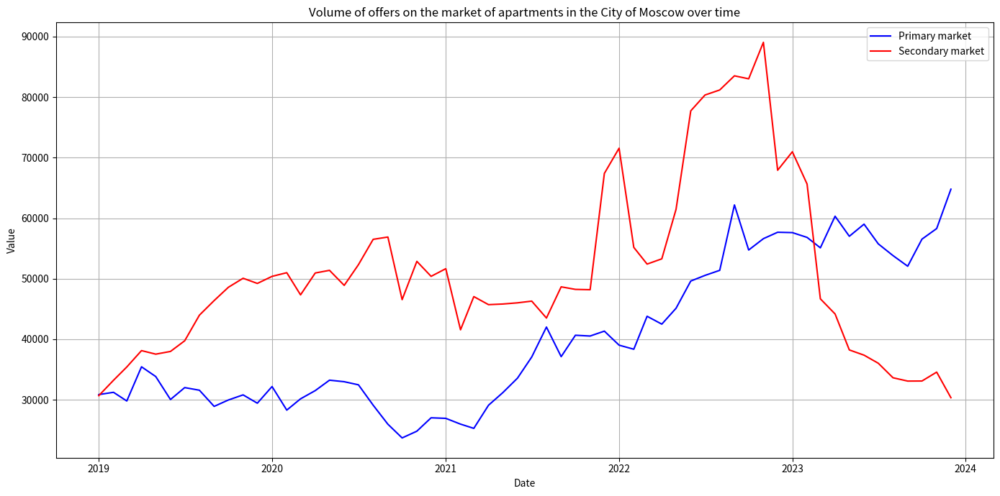

In [72]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in the City of Moscow over time')

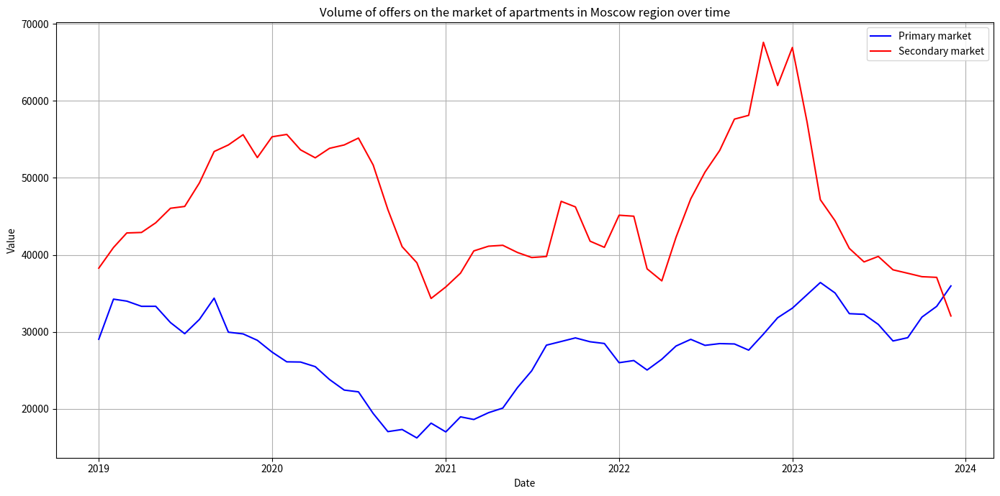

In [73]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Moscow region over time')

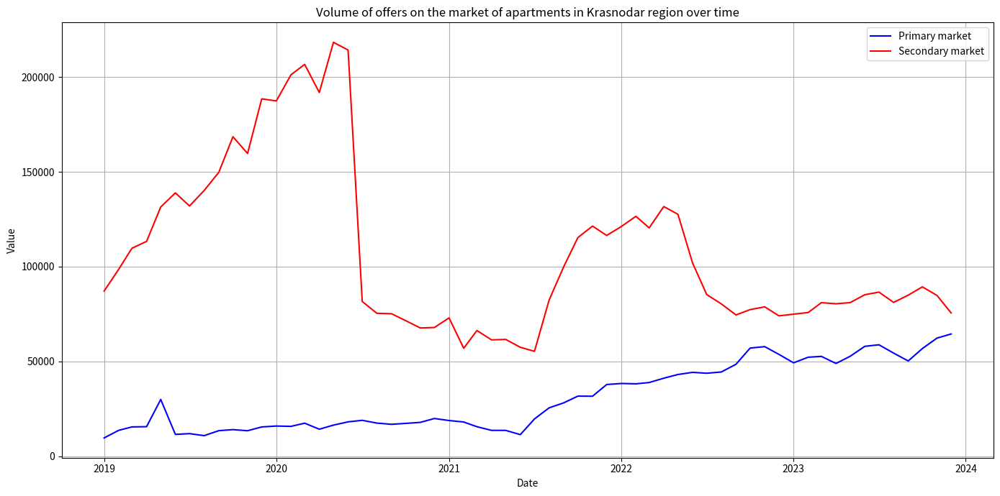

In [74]:
syv.plot_market_indicators(primary_volumes_ts, secondary_volumes_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=volume_labels, colors=['blue', 'red'],
                           linestyles=['-', '-'],
                           title=f'Volume of offers on the market of apartments in Krasnodar region over time')

Графики для всех регионов доступны по [ссылке](https://drive.google.com/drive/folders/1a4Dtq4SqnMK-l3tvplbQ4QAu0WH-VM2T?usp=drive_link).


In [75]:
syv.save_volumes_plots(primary_volumes_ts,\
                       secondary_volumes_ts,\
                       column_name='value')

#### 5.2.3 Сроки экпозиции на вторичных рынках

Построим графики динамики сроков экпозиции на вторичных рынках для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

In [76]:
exposure_labels = ['Secondary market']

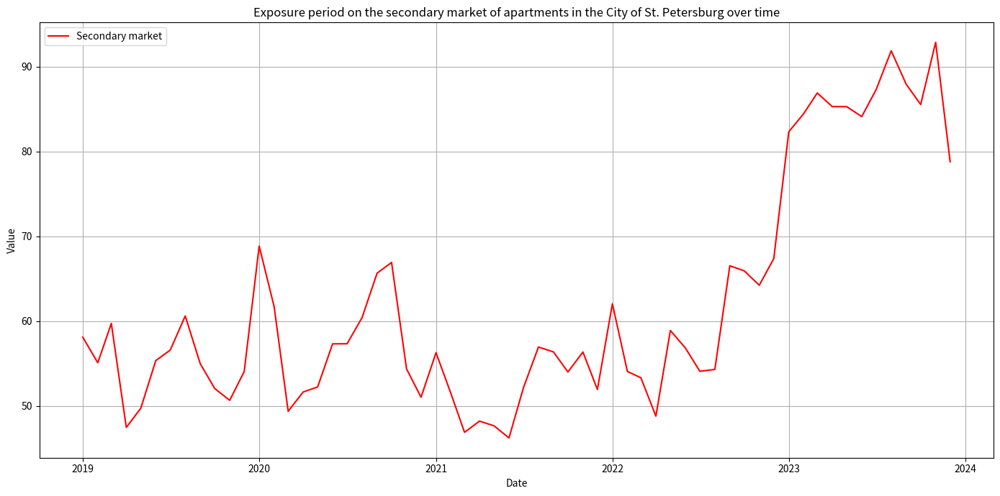

In [77]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in the City of St. Petersburg over time')

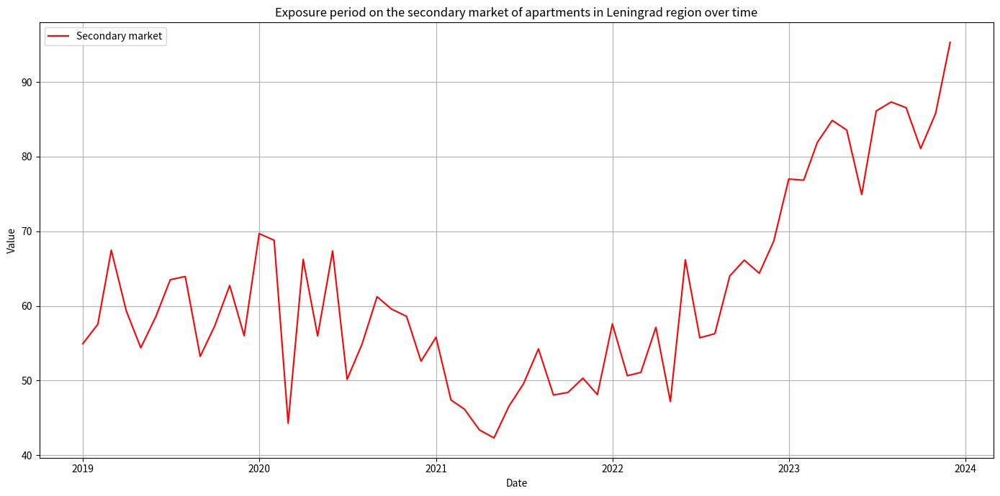

In [78]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Leningrad region over time')

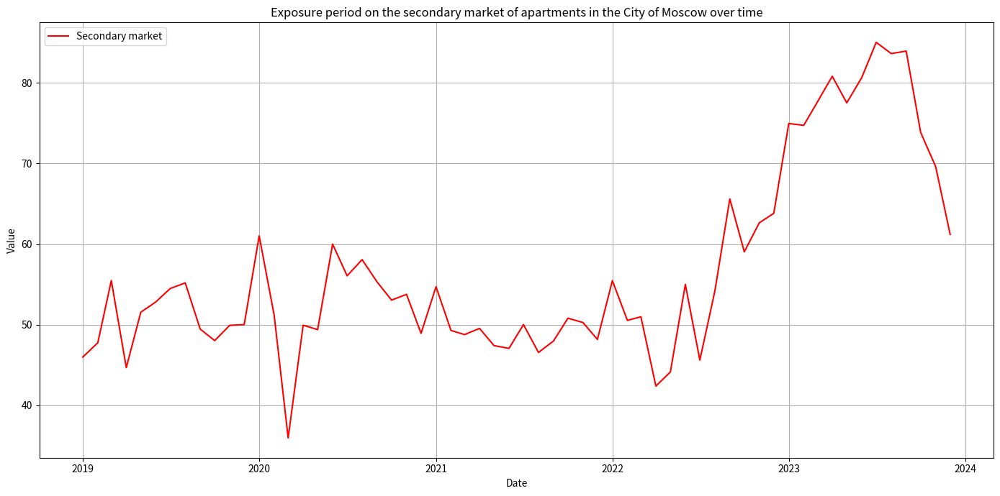

In [79]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in the City of Moscow over time')

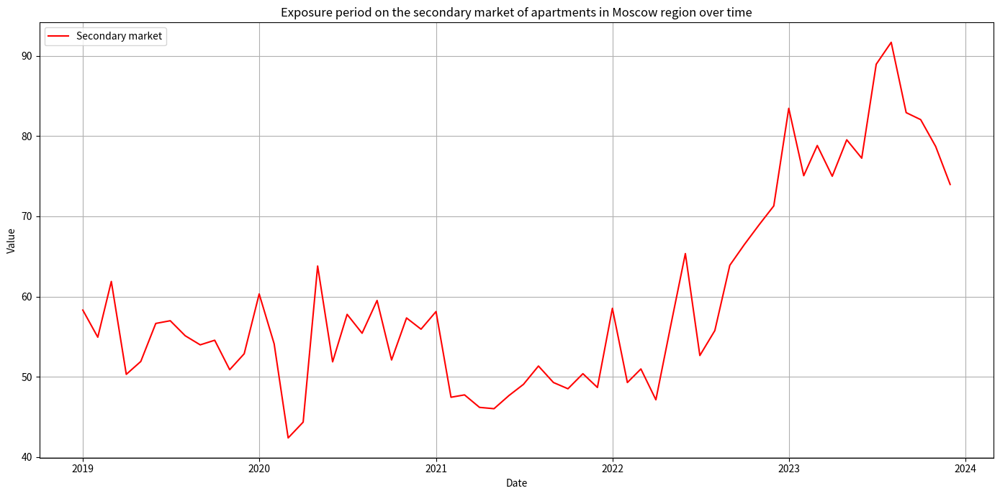

In [80]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=exposure_labels, colors=['red'],
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Moscow region over time')

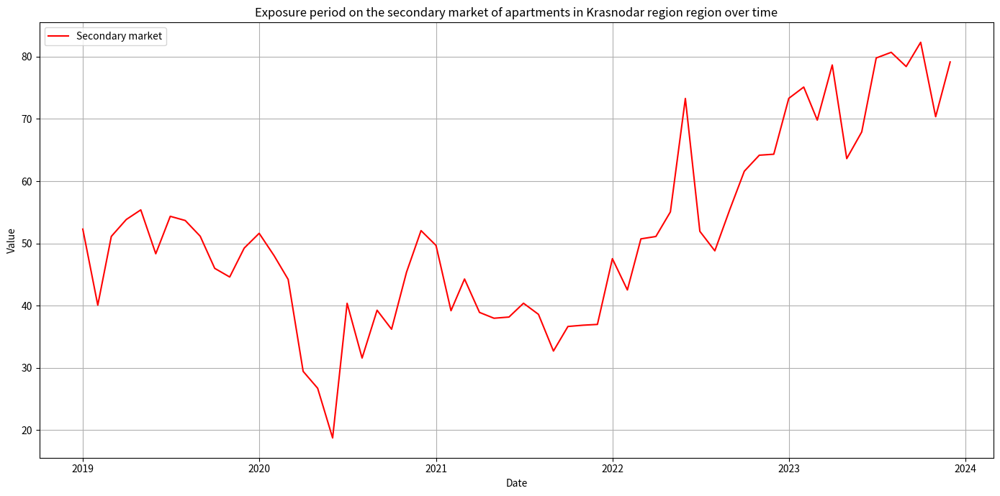

In [81]:
syv.plot_market_indicators(secondary_exposure_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',\
                           labels=exposure_labels, colors=['red'],\
                           linestyles=['-'],
                           title=f'Exposure period on the secondary market of apartments in Krasnodar region region over time')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [82]:
syv.save_exposure_plots(secondary_exposure_ts,\
                       column_name='value')

#### 5.2.4 Скидки при переходе от цен предложений к ценам сделок

Построим графики динамики скидок при переходе от цен предложений к ценам сделок для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

In [83]:
discounts_labels = ['Primary Market',
                   'Secondary market']

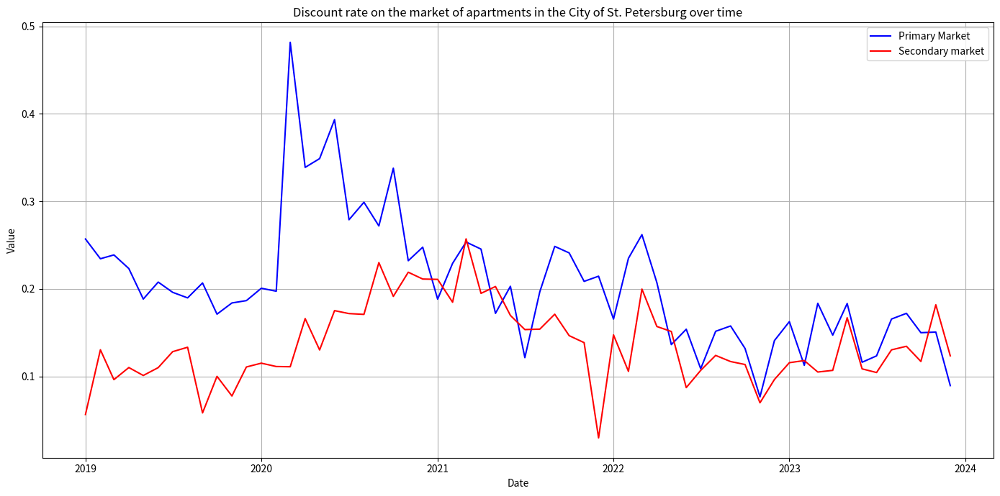

In [84]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in the City of St. Petersburg over time')

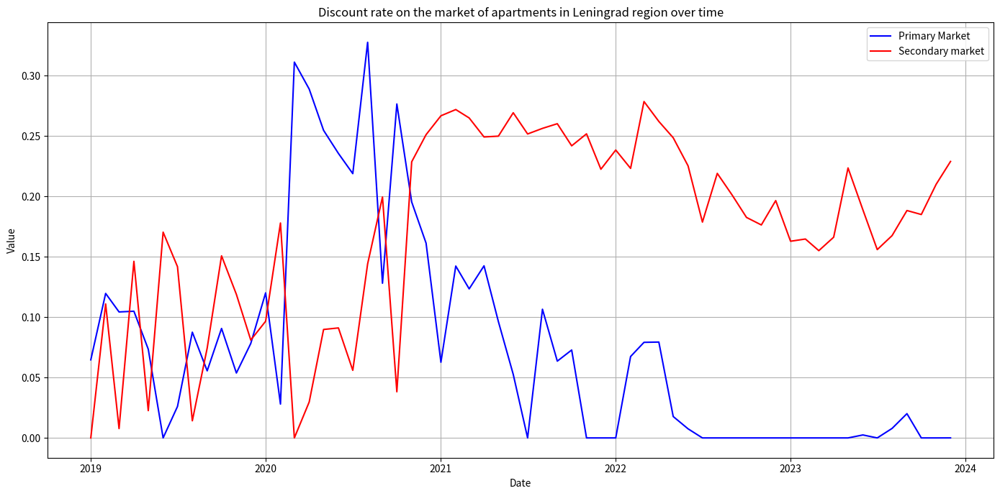

In [85]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',\
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],\
                           title=f'Discount rate on the market of apartments in Leningrad region over time')

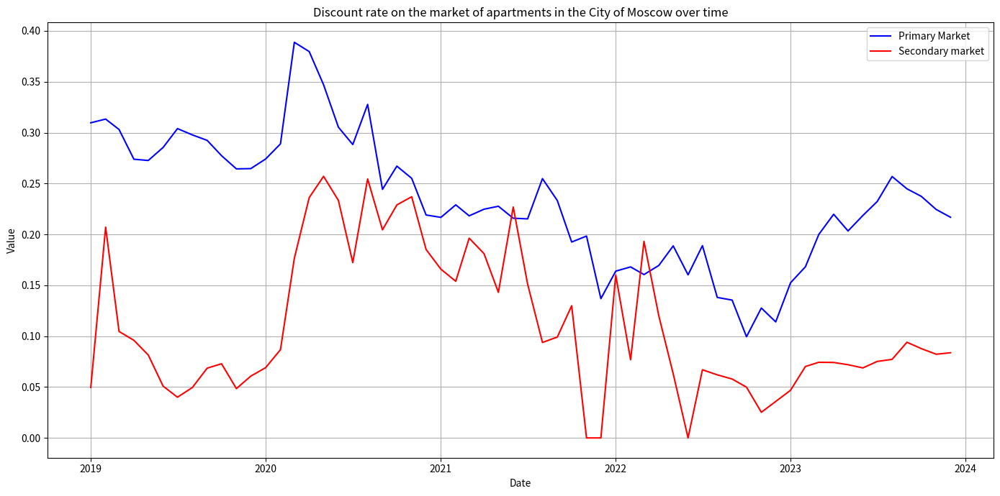

In [86]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in the City of Moscow over time')

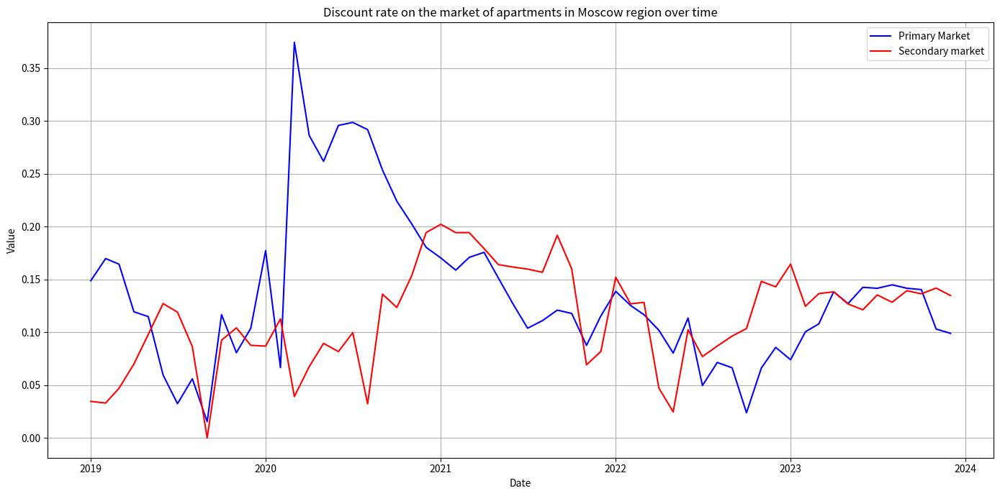

In [87]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in Moscow region over time')

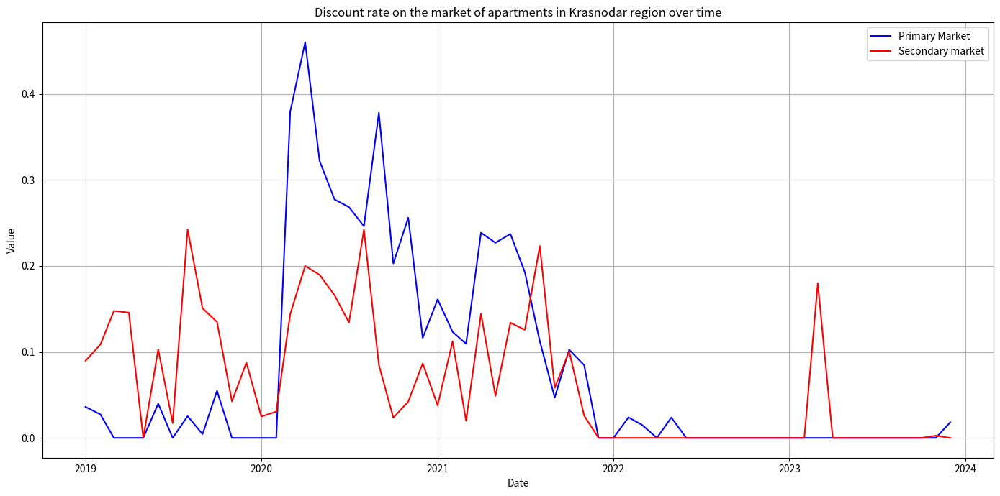

In [88]:
syv.plot_market_indicators(primary_discount_rates_ts, secondary_discount_rates_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=discounts_labels, colors=['blue', 'red'], linestyles=['-', '-'],
                           title=f'Discount rate on the market of apartments in Krasnodar region over time')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [89]:
syv.save_discounts_plots(primary_discount_rates_ts,
                         secondary_discount_rates_ts,
                         column_name='value')

#### 5.2.5 Соотношения показателей первичного и вторичного рынков

Построим графики соотношений индикаторов цен, объёмов и скидок первичного и вторичного рынков пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край. При расчёте показателя соотношения данные первичного рынка используются в числителе, таким образом значение показателя, например, в 1.21 означает, что значение индикатора первичного рынка больше на 0.21 относительно аналогичного индикатора вторичного рынка.

In [90]:
ratios_labels_1 = ['Deals',
                  'Offers']
ratios_labels_2 = ['Offers']
ratios_labels_3 = ['Mean deal price/Median offer price']

##### 5.2.5.1 Соотношения индикаторов цен

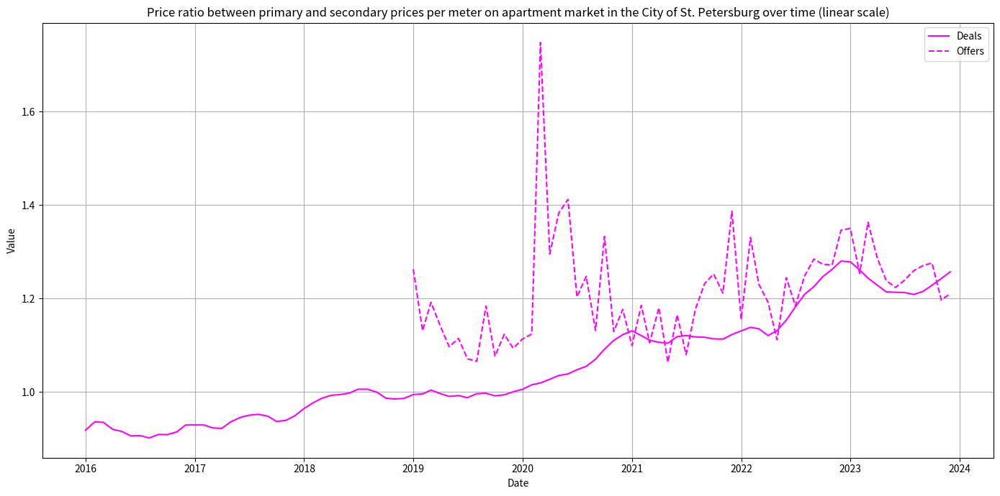

In [91]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in the City of St. Petersburg over time (linear scale)')

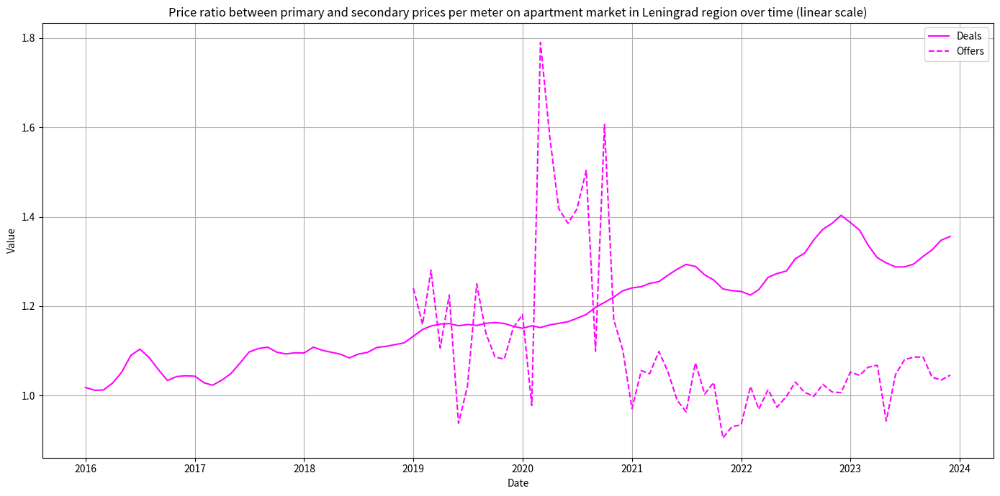

In [92]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Leningrad region over time (linear scale)')

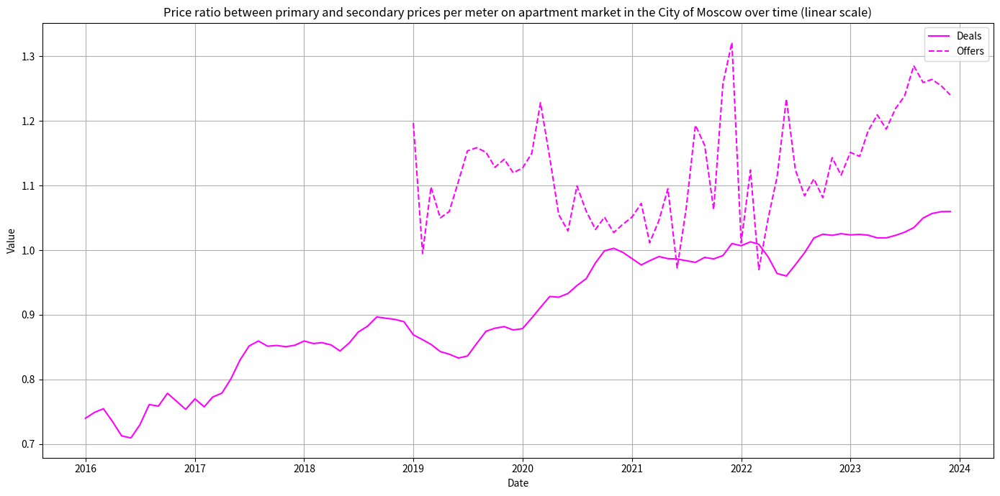

In [93]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in the City of Moscow over time (linear scale)')

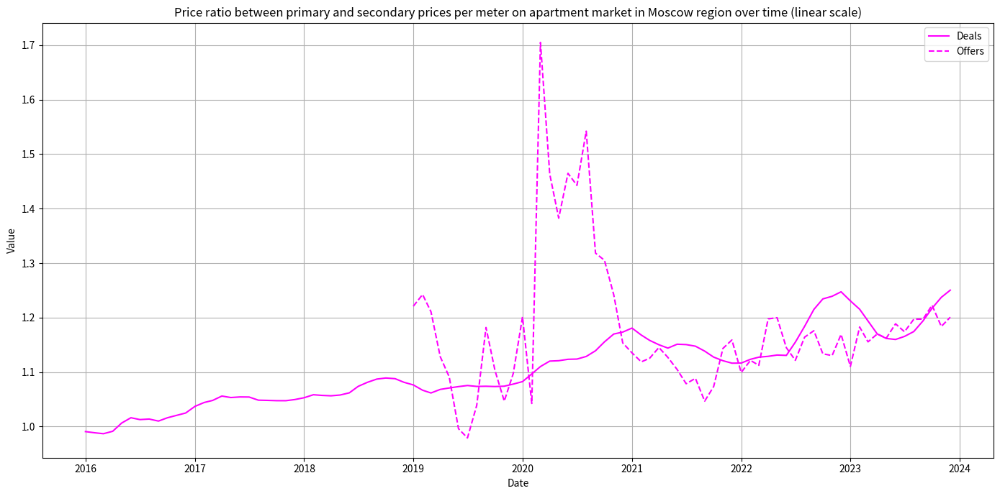

In [94]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Moscow region over time (linear scale)')

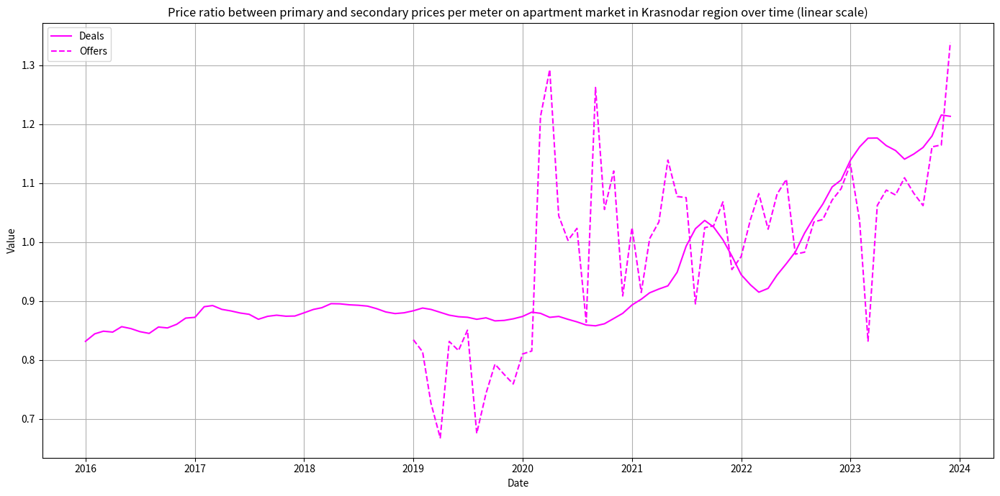

In [95]:
syv.plot_market_indicators(deals_ratios_ts, offers_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_1, colors=['magenta', 'magenta'], linestyles=['-', '--'],
                           title=f'Price ratio between primary and secondary prices per meter on apartment market in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [96]:
syv.save_price_ratios_plots(deals_ratios_ts,
                         offers_ratios_ts,
                         column_name='value')

##### 5.2.5.2 Соотношения индикаторов объёмов

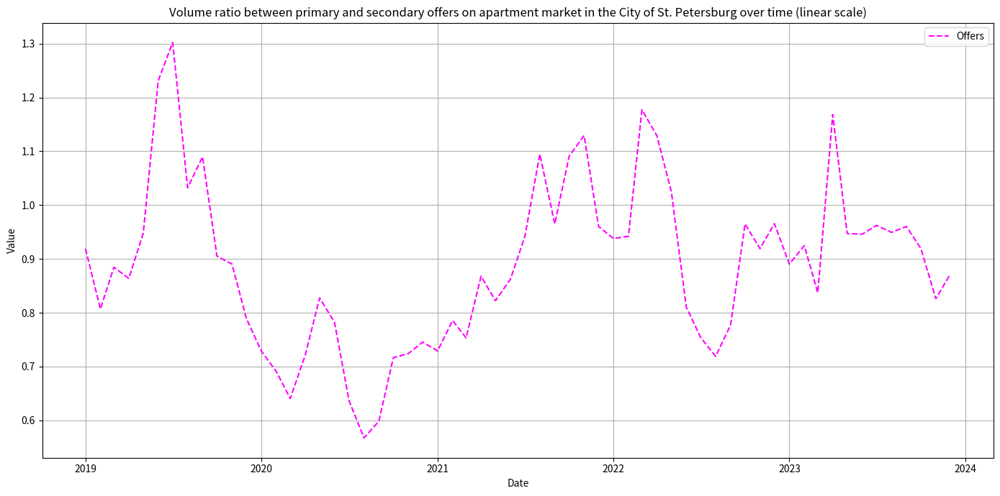

In [97]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

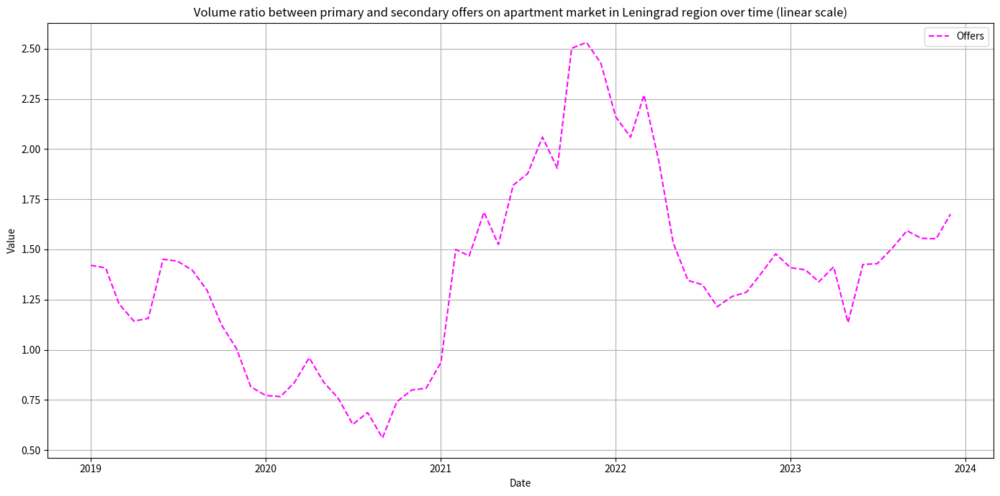

In [98]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

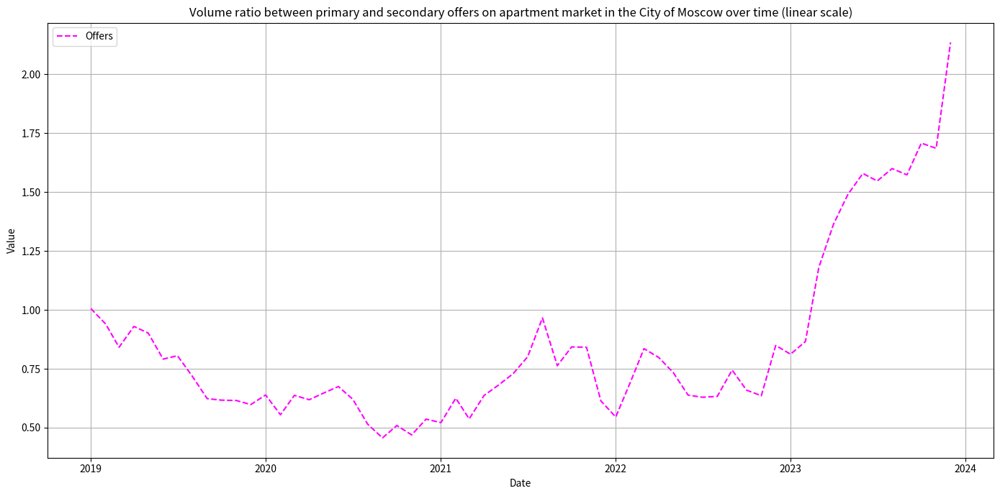

In [99]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

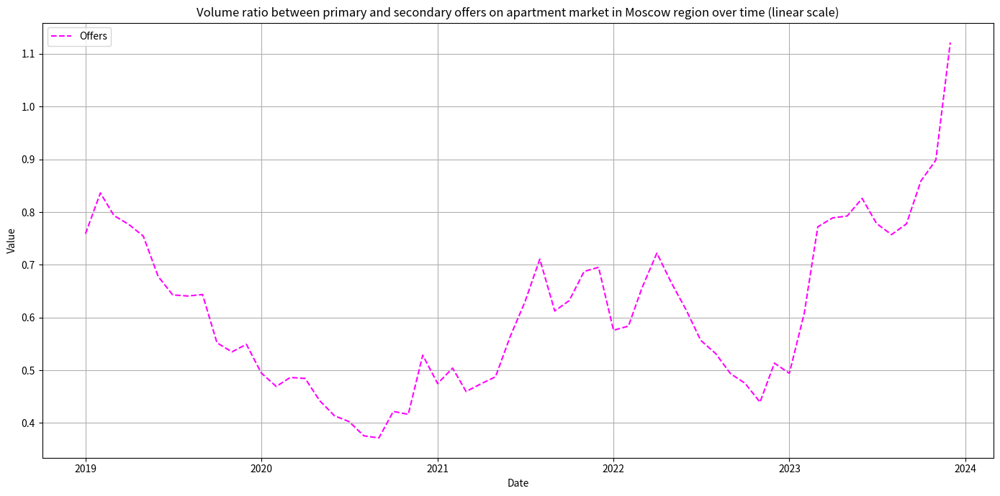

In [100]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

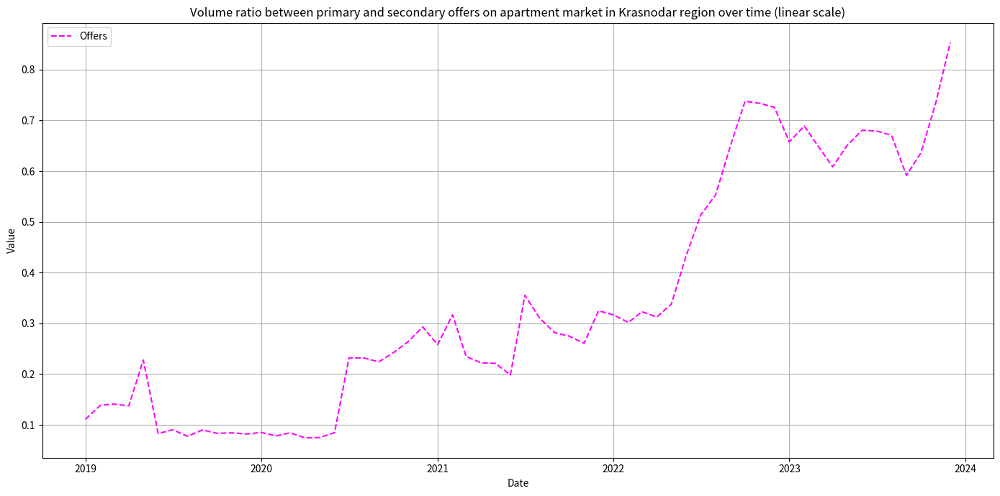

In [101]:
syv.plot_market_indicators(volumes_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_2, colors=['magenta'], linestyles=['--'],
                           title=f'Volume ratio between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [102]:
syv.save_volume_ratios_plots(volumes_ratios_ts,
                           column_name='value')

##### 5.2.5.3 Соотношения индикаторов скидок

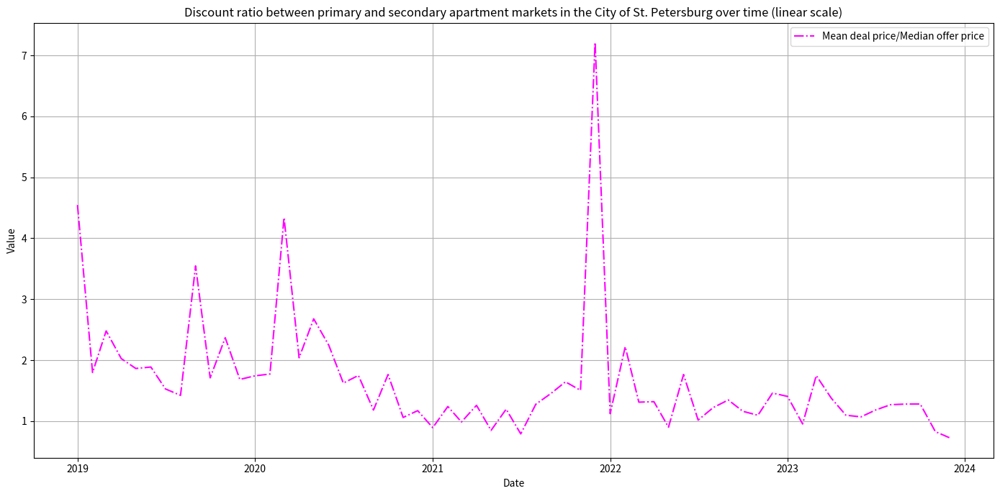

In [103]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in the City of St. Petersburg over time (linear scale)')

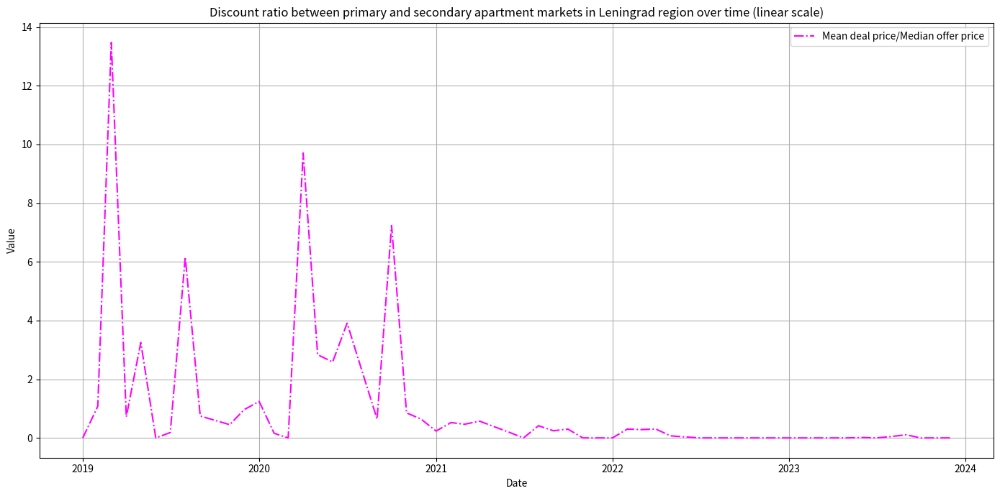

In [104]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Leningrad region over time (linear scale)')

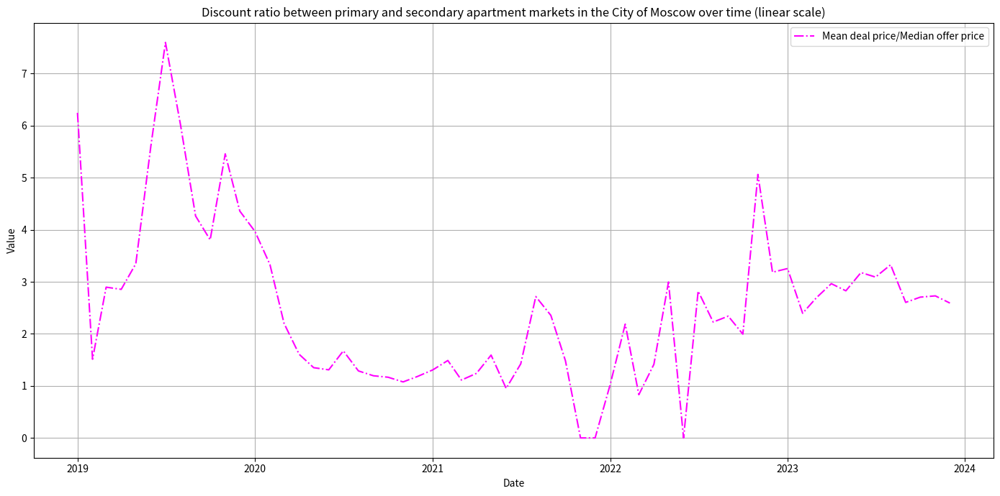

In [105]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in the City of Moscow over time (linear scale)')

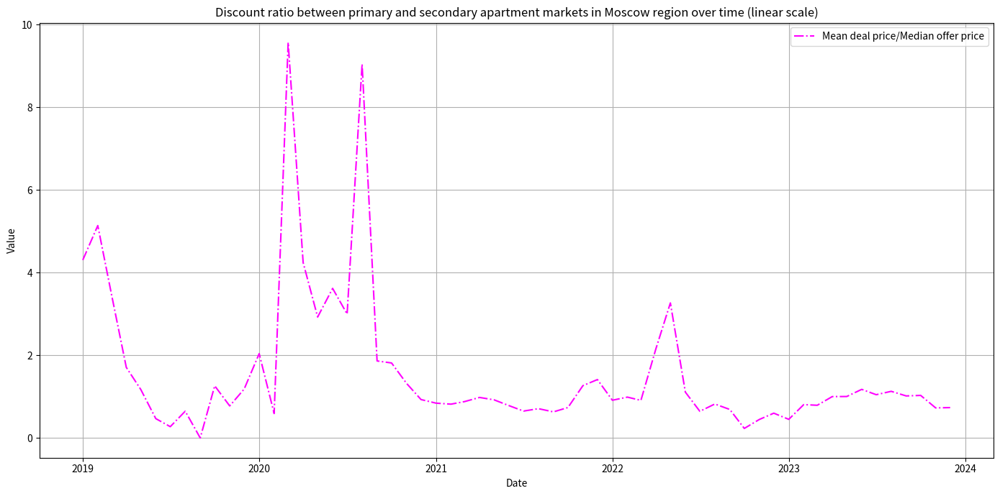

In [106]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Moscow region over time (linear scale)')

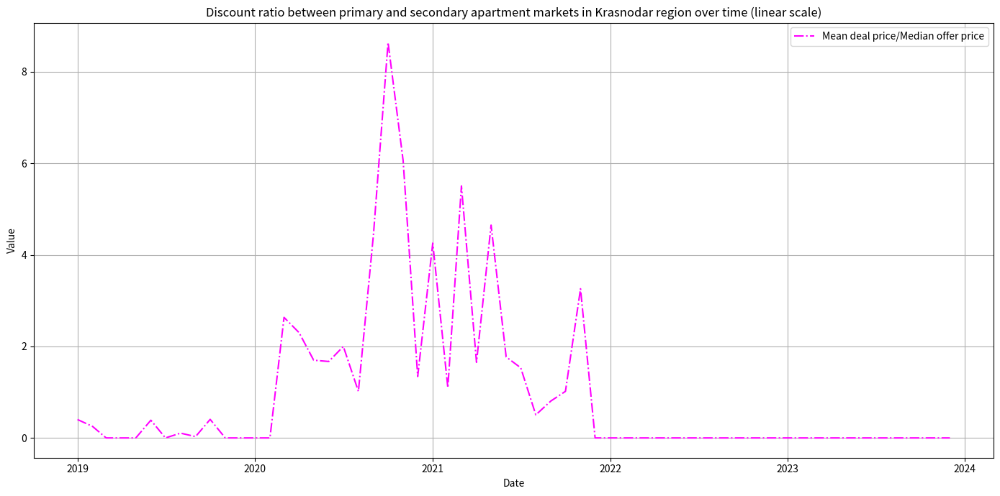

In [107]:
syv.plot_market_indicators(discounts_ratios_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=ratios_labels_3, colors=['magenta'], linestyles=['-.'],
                           title=f'Discount ratio between primary and secondary apartment markets in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [108]:
syv.save_discount_ratios_plots(discounts_ratios_ts,\
                           column_name='value')

#### 5.2.6 Гэпы между индикаторами первичного и вторичного рынков

Построим графики гэпов между индикаторми цен, объёмов и скидок первичного и вторичного рынков пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край. При расчёте показателя соотношения данные первичного рынка используются в уменьшаемом, таким образом значение показателя больше нуля означает, что значение индикатора первичного рынка больше аналогичного индикатора вторичного рынка.

In [109]:
gaps_labels_1 = ['Deals',
                  'Offers']
gaps_labels_2 = ['Offers']
gaps_labels_3 = ['Mean deal price - Median offer price']

##### 5.2.6.1 Гэпы между индикаторами цен

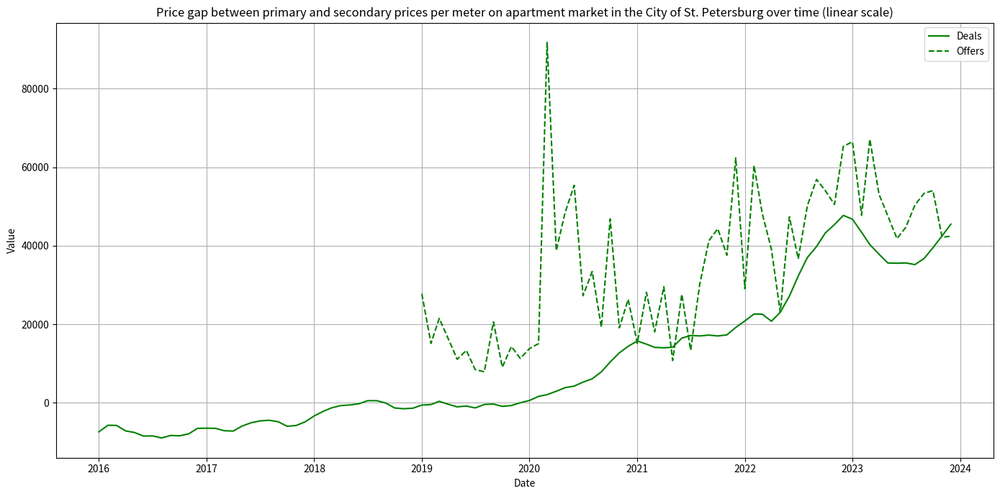

In [110]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in the City of St. Petersburg over time (linear scale)')

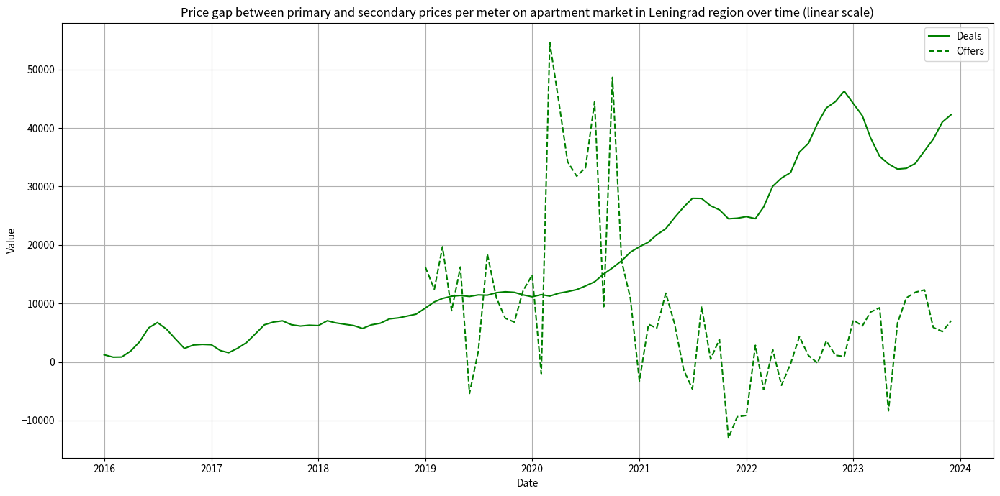

In [111]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Leningrad region over time (linear scale)')

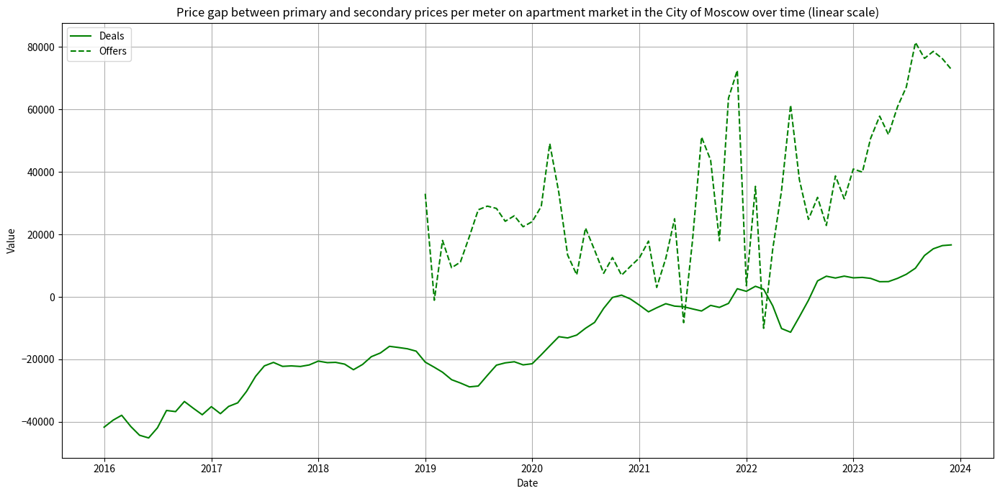

In [112]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in the City of Moscow over time (linear scale)')

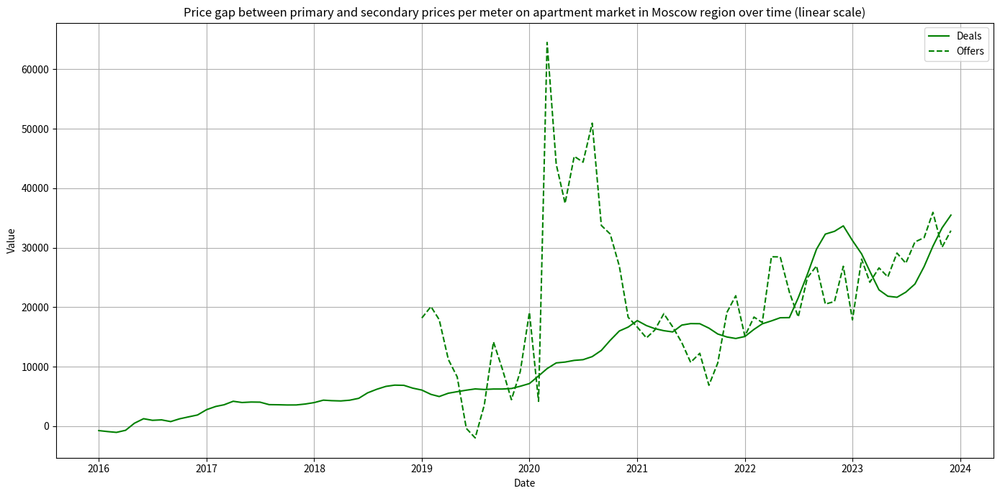

In [113]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Moscow region over time (linear scale)')

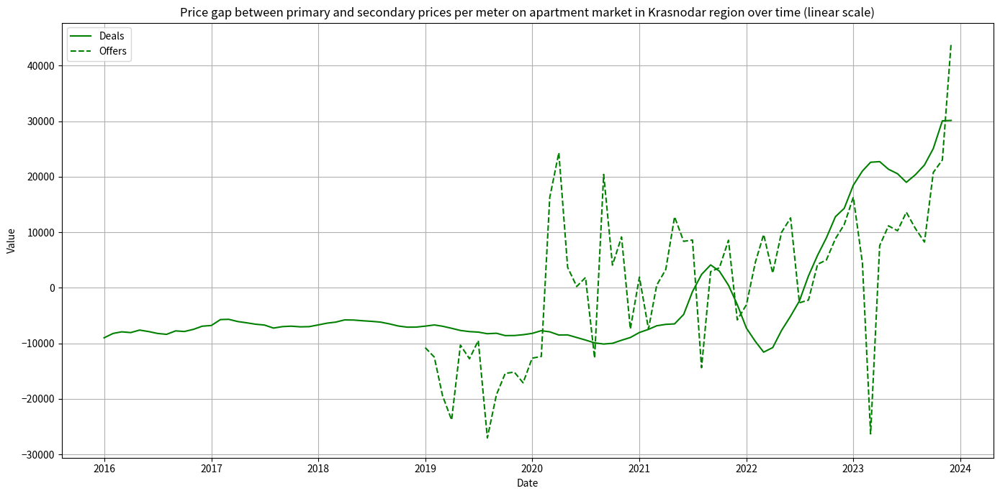

In [114]:
syv.plot_market_indicators(deals_gaps_ts, offers_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_1, colors=['green', 'green'], linestyles=['-', '--'],
                           title=f'Price gap between primary and secondary prices per meter on apartment market in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [115]:
syv.save_price_gaps_plots(deals_gaps_ts,\
                         offers_gaps_ts,\
                         column_name='value')

##### 5.2.6.2 Гэпы между индикаторами объёма

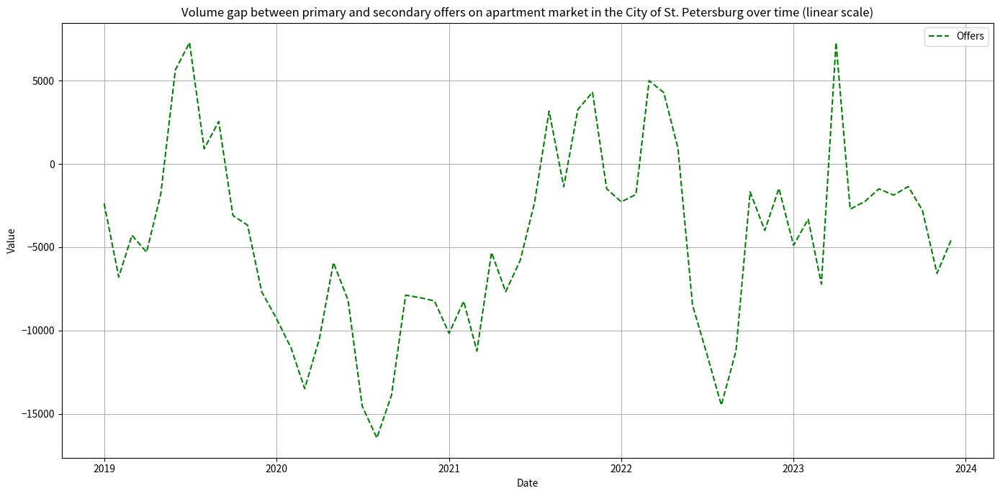

In [116]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

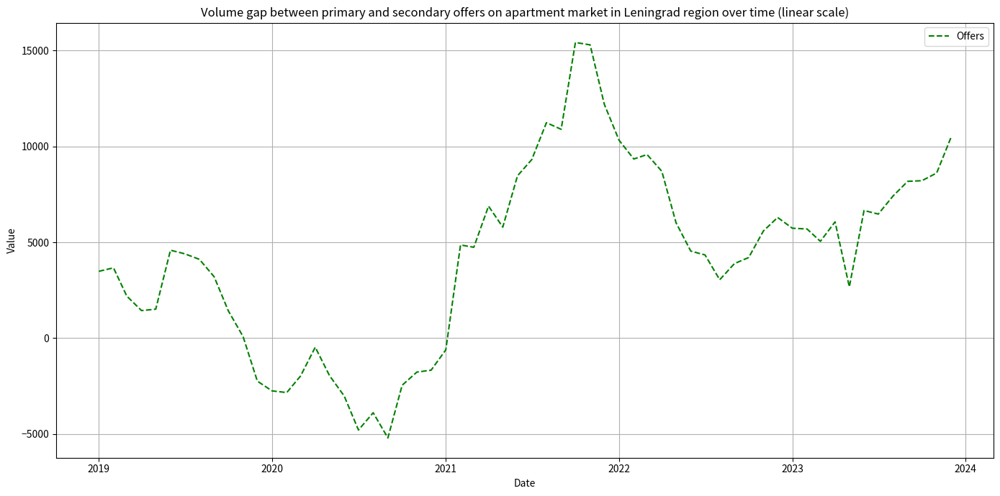

In [117]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

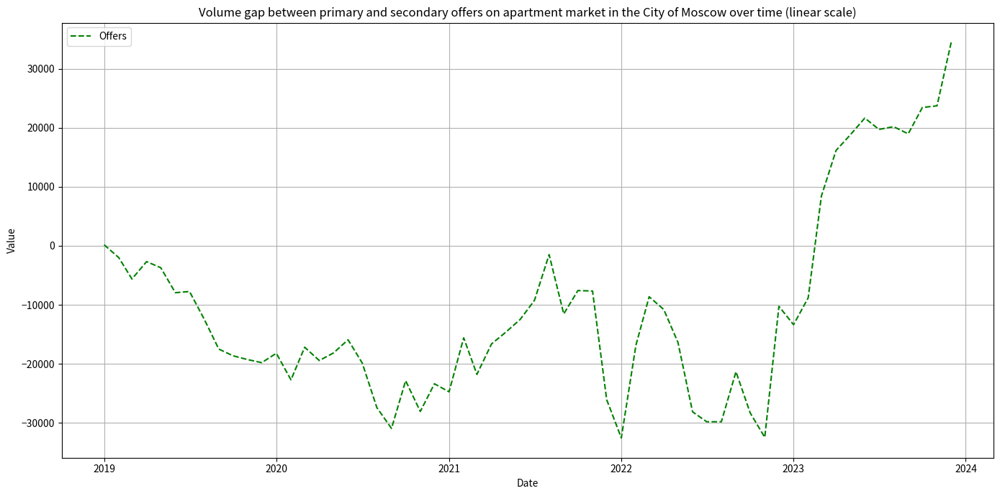

In [118]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

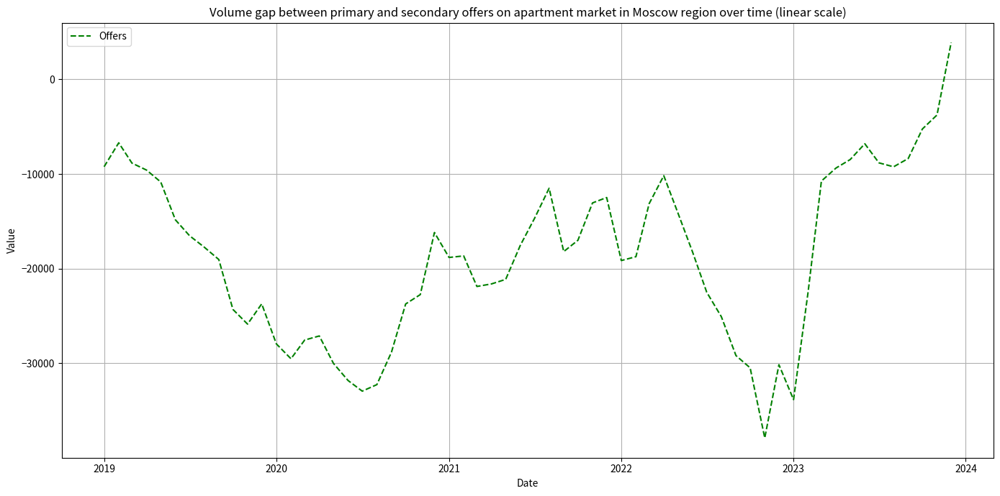

In [119]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

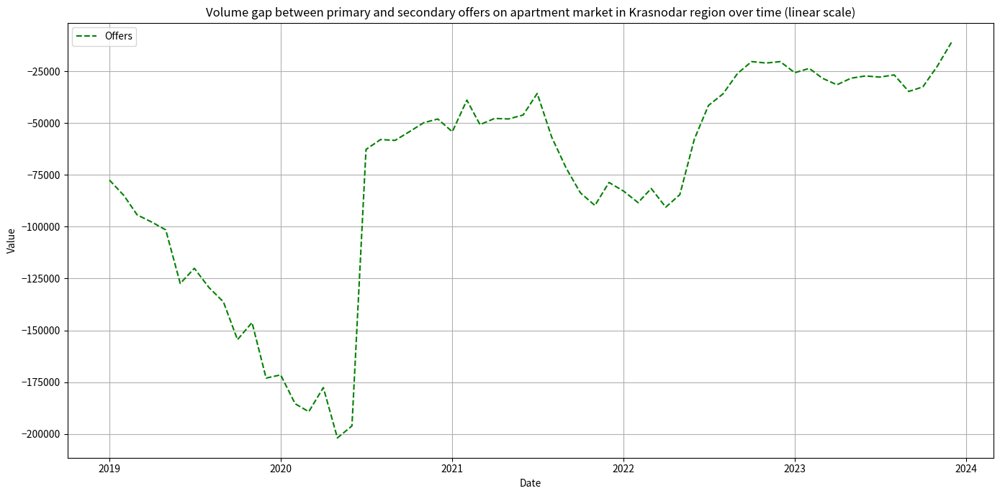

In [120]:
syv.plot_market_indicators(volumes_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_2, colors=['green'], linestyles=['--'],
                           title=f'Volume gap between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [121]:
syv.save_volume_gaps_plots(volumes_gaps_ts,
                          column_name='value')

##### 5.2.6.3 Гэпы между индикаторами скидок

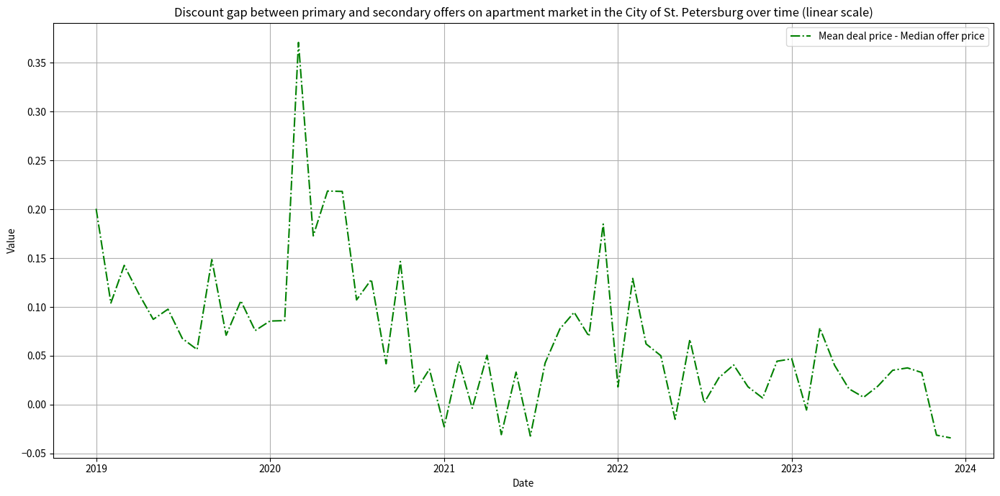

In [122]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in the City of St. Petersburg over time (linear scale)')

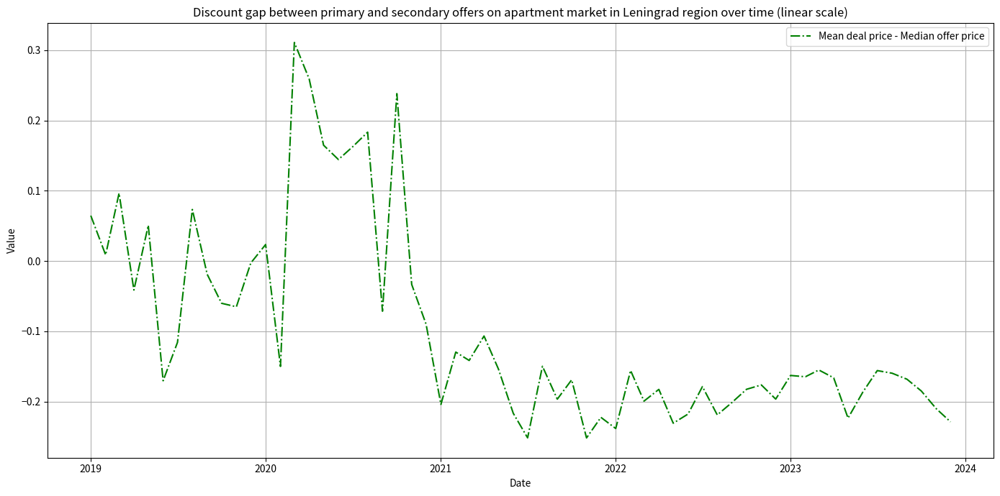

In [123]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Leningrad region over time (linear scale)')

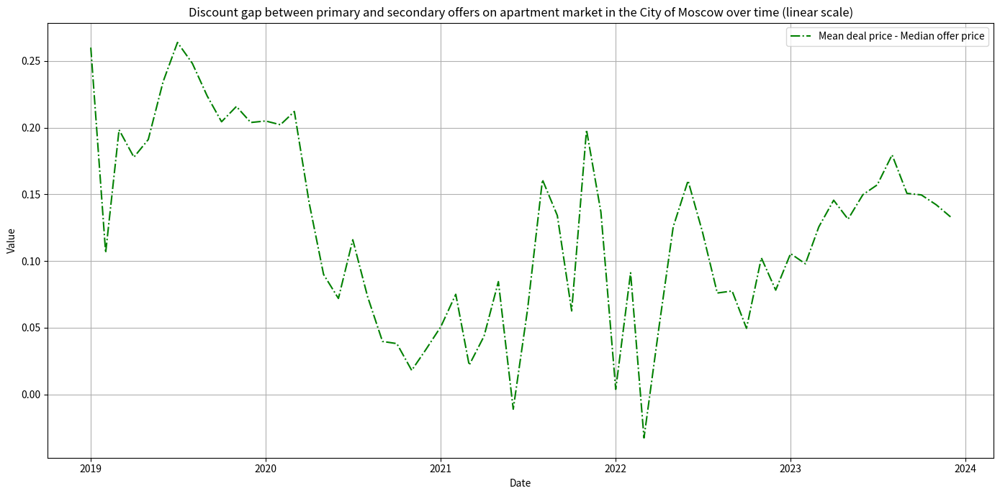

In [124]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Москва, Moscow, 莫斯科',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in the City of Moscow over time (linear scale)')

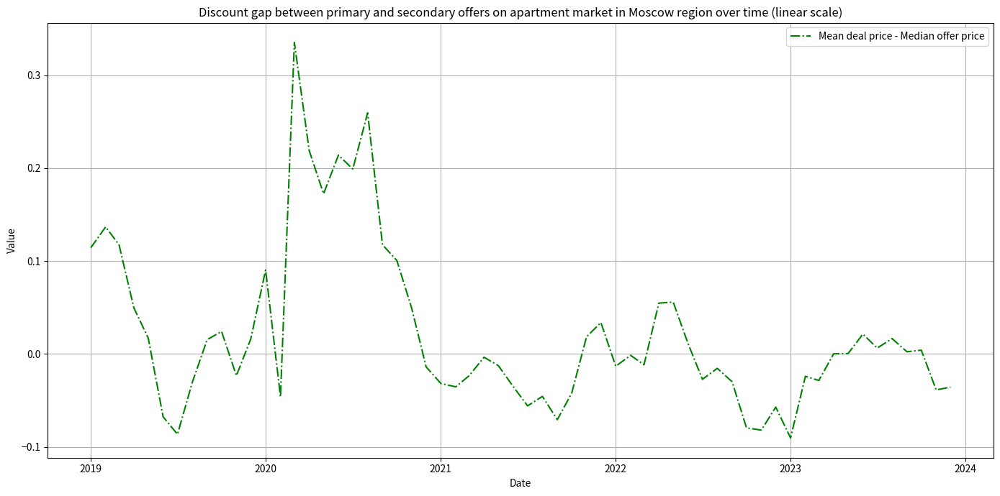

In [125]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Московская область, Moscow Oblast, 莫斯科州',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Moscow region over time (linear scale)')

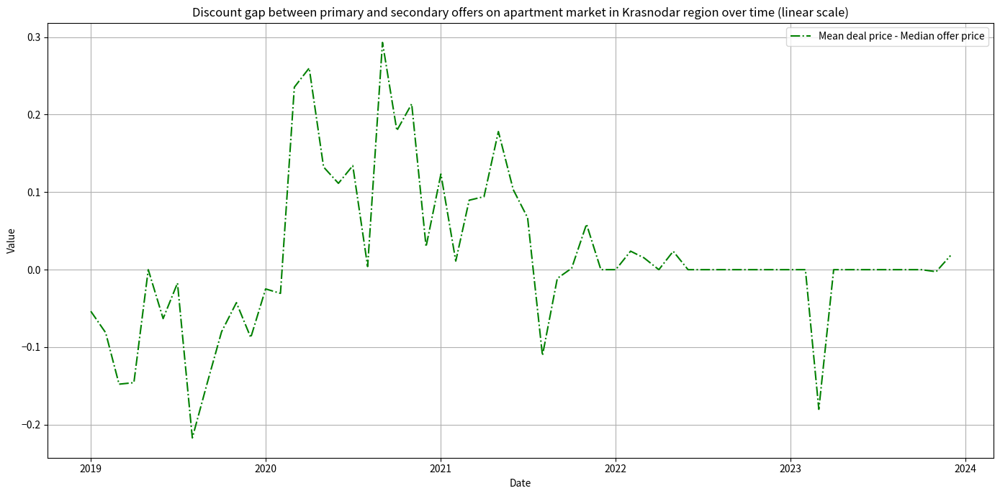

In [126]:
syv.plot_market_indicators(discounts_gaps_ts,
                           region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
                           labels=gaps_labels_3, colors=['green'], linestyles=['-.'],
                           title=f'Discount gap between primary and secondary offers on apartment market in Krasnodar region over time (linear scale)')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [127]:
syv.save_discount_gaps_plots(discounts_gaps_ts,\
                            column_name='value')

### 5.3 Анализ динамики неравенства регионов

График динамики коэффициента Джини для средних цен сделок и медианных цен предложений на первичном рынке.

In [128]:
labels_gini_ts_1 = ['Deals', 'Offers']
labels_gini_ts_2 = ['Primary market', 'Secondary market']
labels_gini_ts_3 = ['Secondary market']

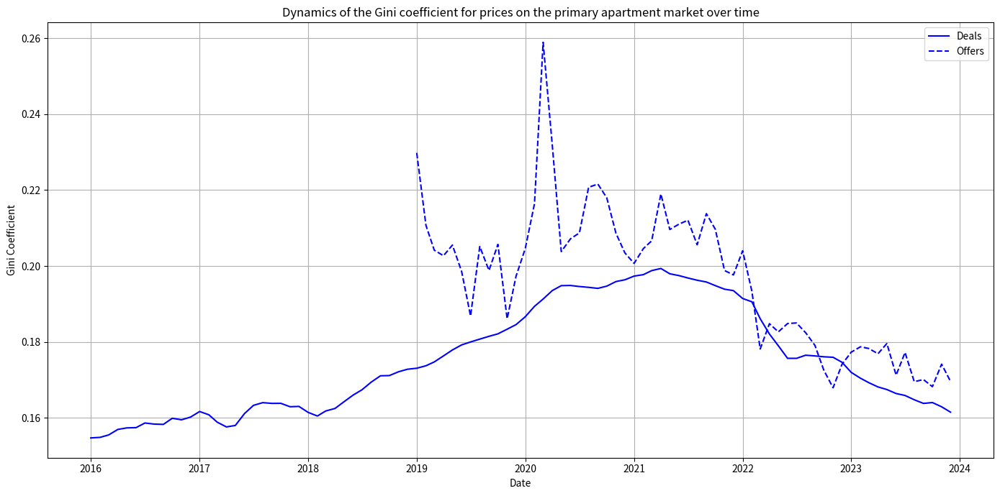

In [129]:
syv.plot_gini_ts(primary_deals_gini_ts, primary_offers_gini_ts,
                           labels=labels_gini_ts_1, colors=['blue', 'blue'], linestyles=['-', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for prices on the primary apartment market over time')

График динамики коэффициента Джини для средних цен сделок и медианных цен предложений на вторичном рынке.

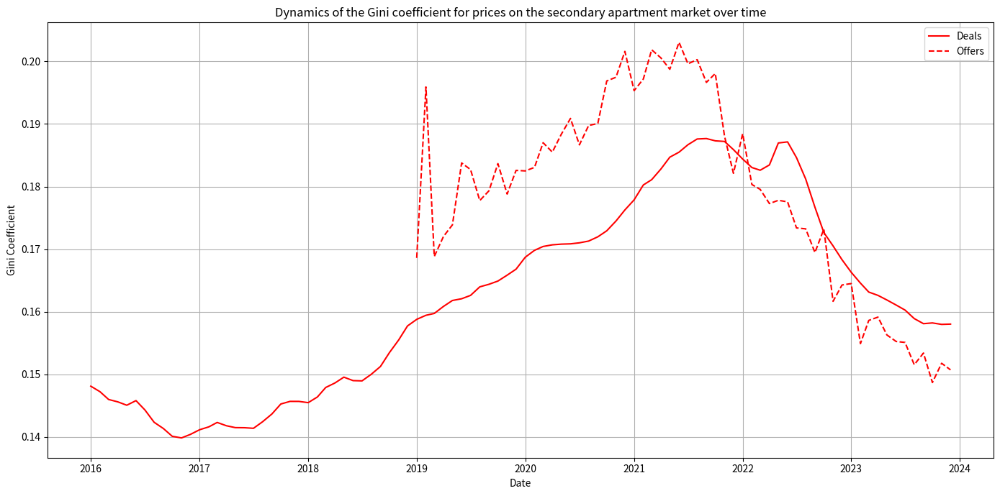

In [130]:
syv.plot_gini_ts(secondary_deals_gini_ts, secondary_offers_gini_ts,
                           labels=labels_gini_ts_1, colors=['red', 'red'], linestyles=['-', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for prices on the secondary apartment market over time')

График динамики коэффициента Джини для объёмов предложения на первичном и вторичном рынках.

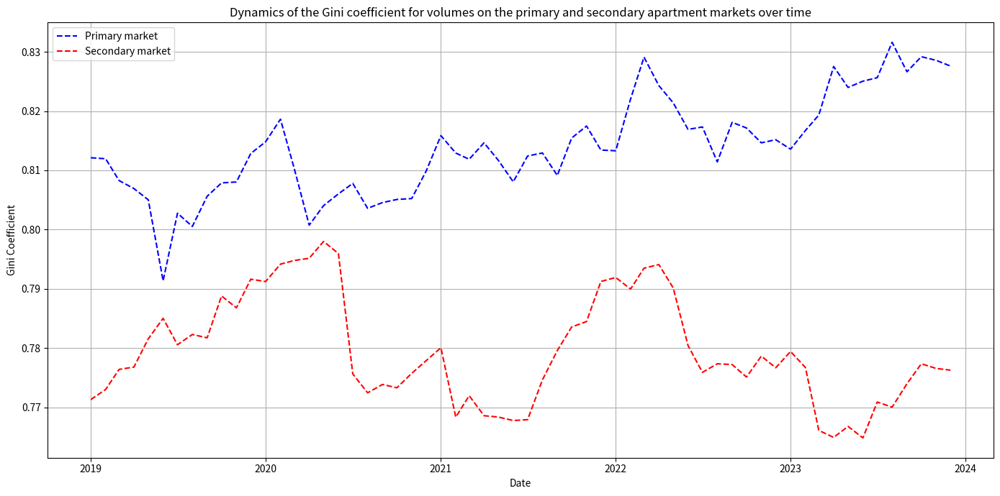

In [131]:
syv.plot_gini_ts(primary_volumes_gini_ts, secondary_volumes_gini_ts,
                           labels=labels_gini_ts_2, colors=['blue', 'red'], linestyles=['--', '--'],
                           plot_title=f'Dynamics of the Gini coefficient for volumes on the primary and secondary apartment markets over time')

График динамики коэффициента Джини для сроков экспозиции на вторичном рынке.

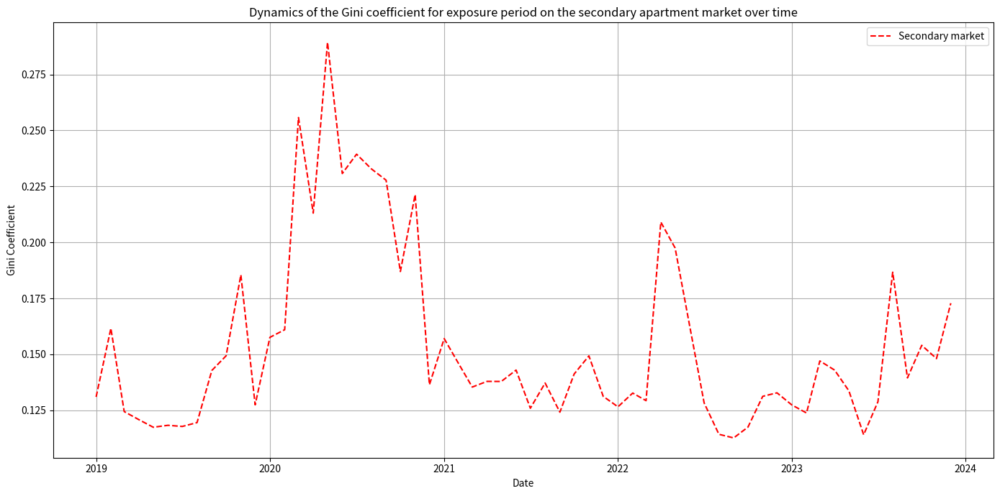

In [132]:
syv.plot_gini_ts(secondary_exposure_gini_ts,
                           labels=labels_gini_ts_3, colors=['red'], linestyles=['--'],
                           plot_title=f'Dynamics of the Gini coefficient for exposure period on the secondary apartment market over time')

Графики в виде файлов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [133]:
# Save plot for the primary market prices
syv.save_gini_ts_plot(primary_deals_gini_ts, primary_offers_gini_ts,
                  labels = labels_gini_ts_1,
                  file_name = 'primary_prices_gini_ts',
                  colors=['blue', 'blue'],
                  linestyles=['-', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for prices on the primary apartment market over time")

# Save plot for the secondary market prices
syv.save_gini_ts_plot(secondary_deals_gini_ts, secondary_offers_gini_ts,
                  labels = labels_gini_ts_1,
                  file_name = 'secondary_prices_gini_ts',
                  colors=['red', 'red'],
                  linestyles=['-', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for prices on the secondary apartment market over time")

# Save plot for the primary and secondary markets volumes
syv.save_gini_ts_plot(primary_volumes_gini_ts, secondary_volumes_gini_ts,
                  labels = labels_gini_ts_2,
                  file_name = 'volumes_gini_ts',
                  colors=['blue', 'red'],
                  linestyles=['--', '--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for volumes on the primary and secondary apartment markets over time")

# Save plot for the secondary market exposure period
syv.save_gini_ts_plot(secondary_exposure_gini_ts,
                  labels = labels_gini_ts_3,
                  file_name = 'secondary_exposure_gini_ts',
                  colors=['red'],
                  linestyles=['--'],
                  yscale='linear',
                  value_column='gini_coefficient',
                  plot_title="Dynamics of the Gini coefficient for exposure period on the secondary apartment market over time")

### 5.4 Анализ реальных рублёвых ценовых индикаторов

#### 5.4.1 Обработка данных о годовых темпах инфляции

В качестве источника данных об инфляции в России используются [данные](https://databank.worldbank.org/source/world-development-indicators/Series/NY.GDP.DEFL.KD.ZG#) Всемирного банка.

In [134]:
annual_inflation_rus = syv.read_inflation_data_rus()

Выполним сглаживание данных с помощью метода [LOWESS](https://en.wikipedia.org/wiki/Local_regression).

In [135]:
annual_inflation_rus_smoothed = syv.smooth_lowess(annual_inflation_rus, 'year', 'inflation', frac=0.3)


Построим график инфляции в линейной шкале.

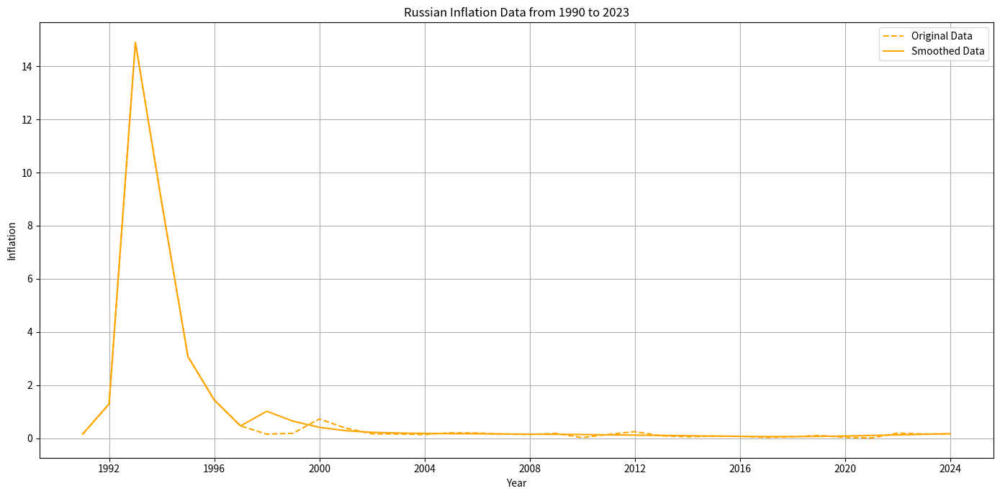

In [136]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'linear')

Построим график инфляции в логарифмической шкале.

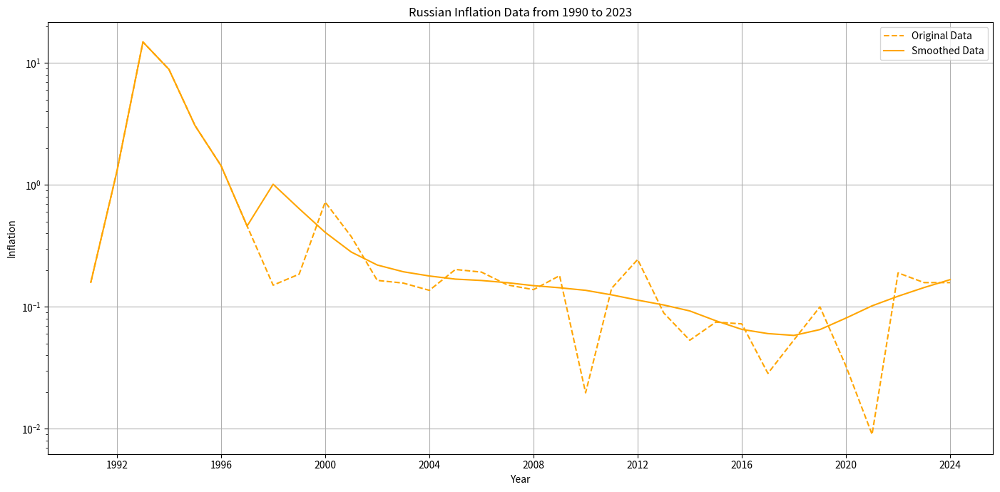

In [137]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'log')

Построим график инфляции с 2002 по 2023 год включительно.

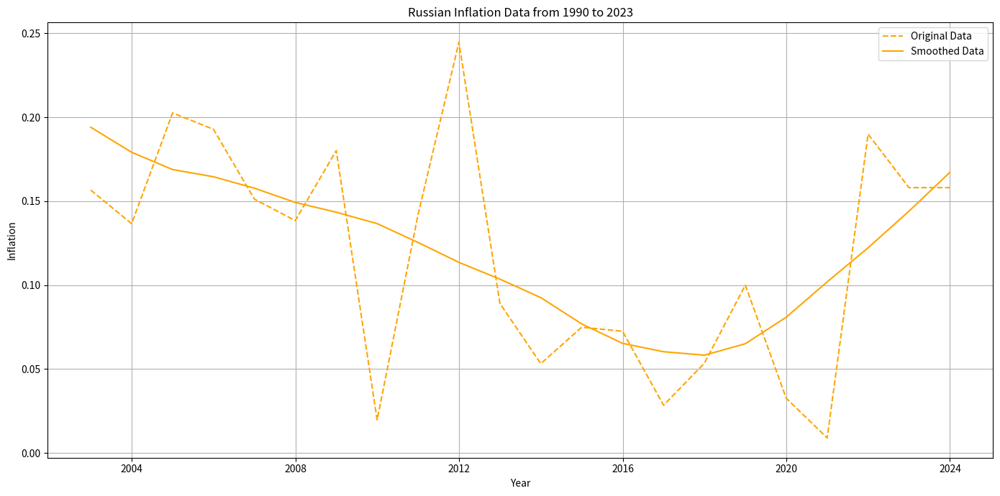

In [138]:
syv.plot_inflation_data(annual_inflation_rus, annual_inflation_rus_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="Russian Inflation Data from 1990 to 2023",
                        yscale = 'linear', start_date="2002-01-01", end_date="2023-12-31")

Графики доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [139]:
# Plot inflation from 1990 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_1990_2023_linear',
                        start_date="1990-01-01", end_date="2023-12-31", 
                        yscale='linear', title="Russian Inflation Data from 1990 to 2023 (linear scale)")

# Plot inflation from 1990 to 2023 in logarithmic scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_1990_2023_log',
                        start_date="1990-01-01", end_date="2023-12-31", 
                        yscale='log', title="Russian Inflation Data from 1990 to 2023 (logarithmic scale)")

# Plot inflation from 2002 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_rus, annual_inflation_rus_smoothed,
                        file_name='annual_inflation_2002_2023_linear',
                        start_date="2002-01-01", end_date="2023-12-31", 
                        yscale='linear', title="Russian Inflation Data from 2002 to 2023 (linear scale)")

#### 5.4.2 Расчёт месячной инфляции

Рассчитаем месячные темпы инфляции.

In [140]:
monthly_inflation_rus = syv.calculate_monthly_inflation(annual_inflation_rus_smoothed,
                                                       inflation_column='smoothed_inflation')
monthly_inflation_rus = syv.filter_date_range(monthly_inflation_rus, start_date="2016-01", end_date="2023-12")
monthly_inflation_rus = syv.convert_date_to_month_year(monthly_inflation_rus)
monthly_inflation_rus = monthly_inflation_rus[0]
monthly_inflation_rus = monthly_inflation_rus.reset_index(drop=True)

Рассчитаем индексы инфляции относительно базовой даты 2020-01-01.

In [141]:
monthly_inflation_rus_relative = syv.calculate_relative_inflation(monthly_inflation_rus.copy())

#### 5.4.3 Расчёт реальных цен для каждого региона и месяца

Рассчитаем реальные рублёвые цены сделок и предложений.

In [142]:
# Read data
primary_deals_ts, primary_offers_ts,\
secondary_deals_ts, secondary_offers_ts = syv.sort_dataframe_by_date(primary_deals_ts,\
                                                            primary_offers_ts,\
                                                            secondary_deals_ts,\
                                                            secondary_offers_ts)

# Set the appropriate date format
monthly_inflation_rus_relative['date'] = monthly_inflation_rus_relative['date'].dt.to_timestamp()
primary_deals_ts['date'] = pd.to_datetime(primary_deals_ts['date'])
primary_deals_ts['date'] = primary_deals_ts['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
primary_offers_ts['date'] = primary_offers_ts['date'].dt.to_period('M').dt.to_timestamp()
secondary_deals_ts['date'] = pd.to_datetime(secondary_deals_ts['date'])
secondary_deals_ts['date'] = secondary_deals_ts['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
primary_offers_ts['date'] = primary_offers_ts['date'].dt.to_period('M').dt.to_timestamp()


In [143]:
# Calculate real prices
primary_deals_real, primary_offers_real, secondary_deals_real, secondary_offers_real = \
    syv.calculate_real_prices(monthly_inflation_rus_relative, 
                              'cumulative_inflation',
                              primary_deals_ts,
                              primary_offers_ts,
                              secondary_deals_ts,
                              secondary_offers_ts,
                              value_column='value')


In [144]:
# Round real prices
primary_deals_real['value_real'] = primary_deals_real['value_real'].round(0).astype(int)
primary_offers_real['value_real'] = primary_offers_real['value_real'].round(0).astype(int)
secondary_deals_real['value_real'] = secondary_deals_real['value_real'].round(0).astype(int)
secondary_offers_real['value_real'] = secondary_offers_real['value_real'].round(0).astype(int)


#### 5.4.4 Визуализация реальных цен

Построим графики динамики реальных цен для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

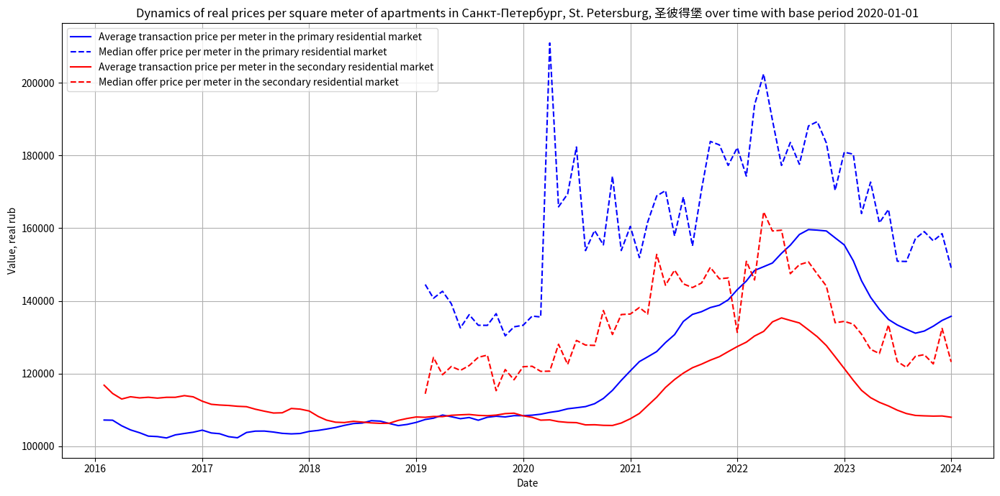

In [145]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Санкт-Петербург, St. Petersburg, 圣彼得堡')

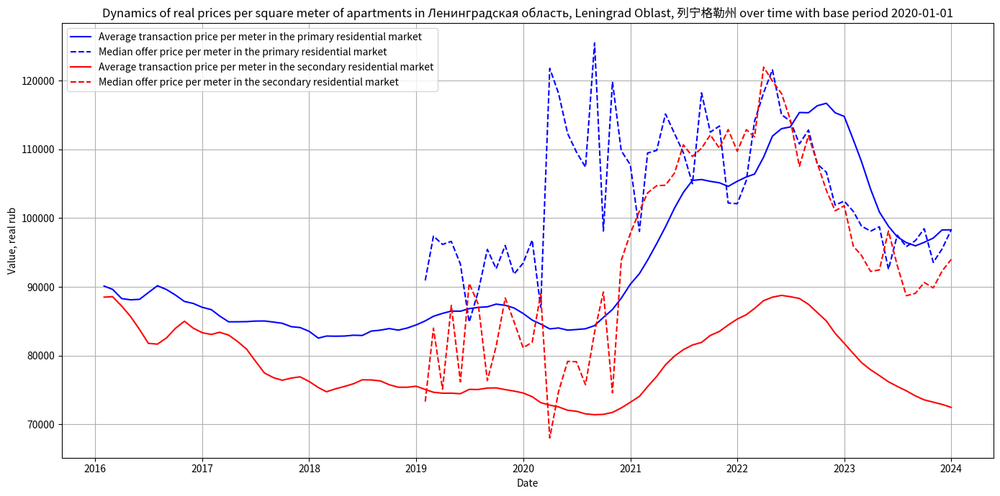

In [146]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Ленинградская область, Leningrad Oblast, 列宁格勒州')

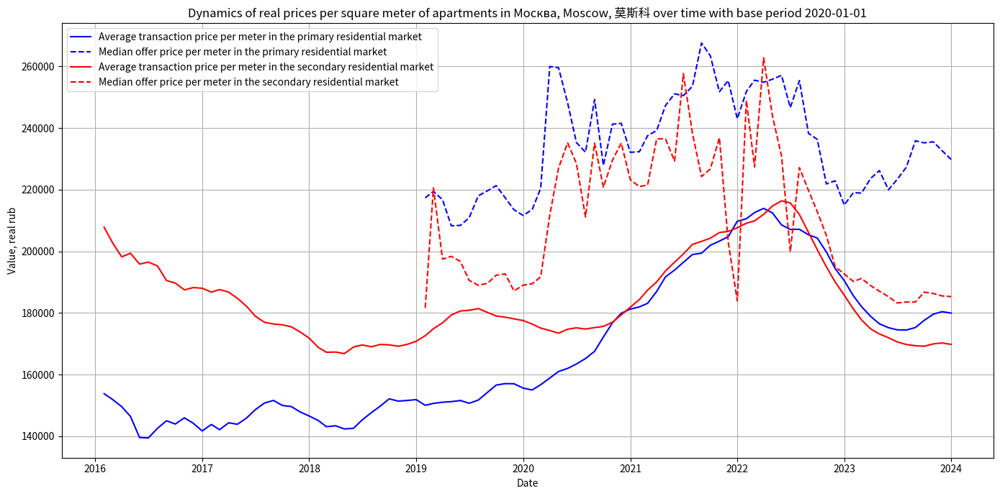

In [147]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Москва, Moscow, 莫斯科')

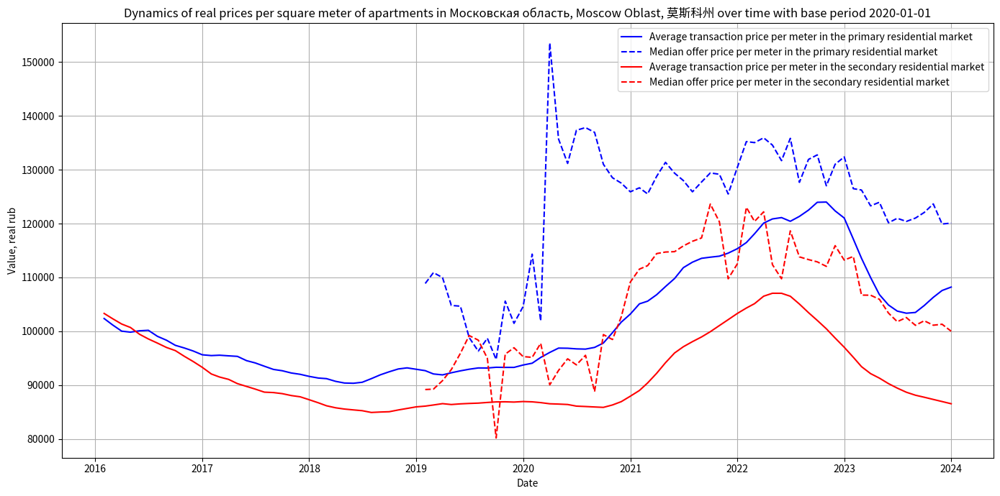

In [148]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Московская область, Moscow Oblast, 莫斯科州')

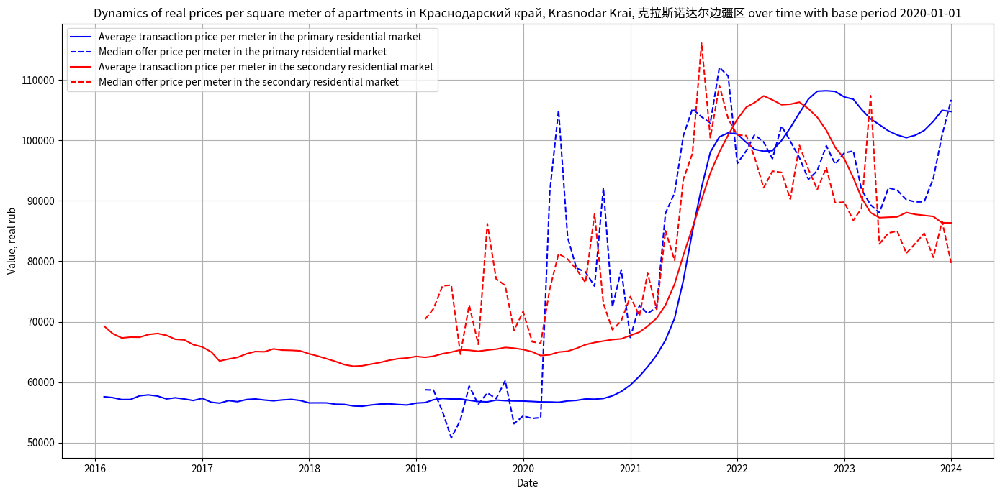

In [149]:
syv.plot_market_real_price_indicators(primary_deals_real,
                                      primary_offers_real,
                                      secondary_deals_real,
                                      secondary_offers_real,
                                      'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [150]:
syv.save_real_prices_plots(primary_deals_real,
                           primary_offers_real,
                           secondary_deals_real,
                           secondary_offers_real)

## 5.5 Анализ номинальных долларовых ценовых индикаторов

В качестве источника данных о курсе доллара США на заданные даты используются [данные](https://www.cbr.ru/currency_base/dynamics/) ЦБ РФ.

### 5.5.1 Подготовка данных

Загрузка данных о курсе рубля относительно долллара. Все курсы приводятся к номиналу, существующему после [денежной реформы 1998 года](https://en.wikipedia.org/wiki/Monetary_reform_in_Russia,_1998). 

In [151]:
usd_rub_rates = syv.get_usd_rub_ex_rate()

Сглаживание данных методом LOWESS.

In [152]:
usd_rub_rates = syv.smooth_exchange_rate(usd_rub_rates)

Визуализация исходных и сглаженных данных динамики курса валютной пары доллар-рубль.

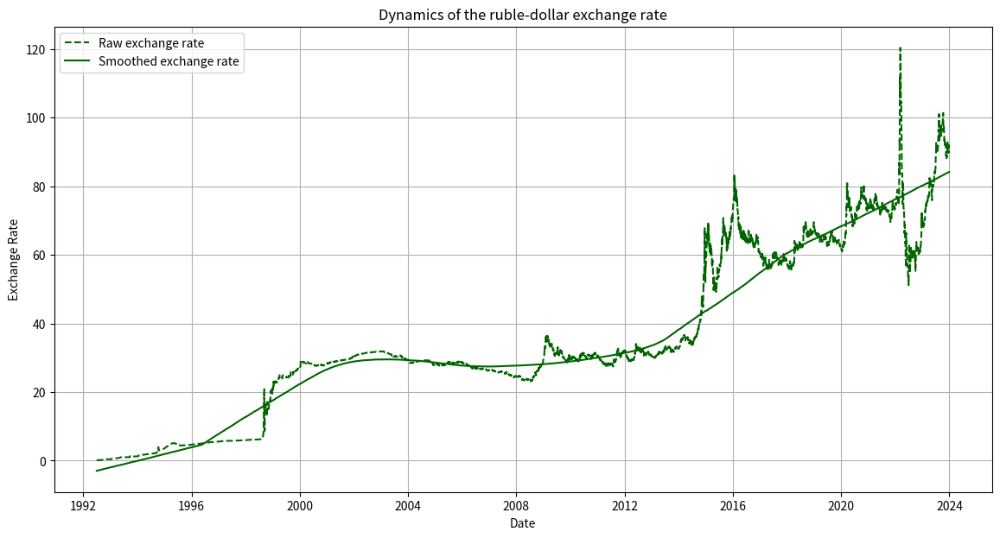

In [153]:
syv.plot_and_save_exchange_rate(usd_rub_rates)


Поскольку данные о ценах представлены помесячно, рассчитаем средние значения курса по месяцам.

In [154]:
monthly_avg_ex_rates = syv.calculate_monthly_avg_ex_rate(usd_rub_rates.copy())
monthly_avg_ex_rates['last_day_of_month'] = monthly_avg_ex_rates['date'].dt.to_timestamp('M') + pd.DateOffset(months=-0, days=-0)
monthly_avg_ex_rates = monthly_avg_ex_rates[['last_day_of_month', 'smoothed_rate']]

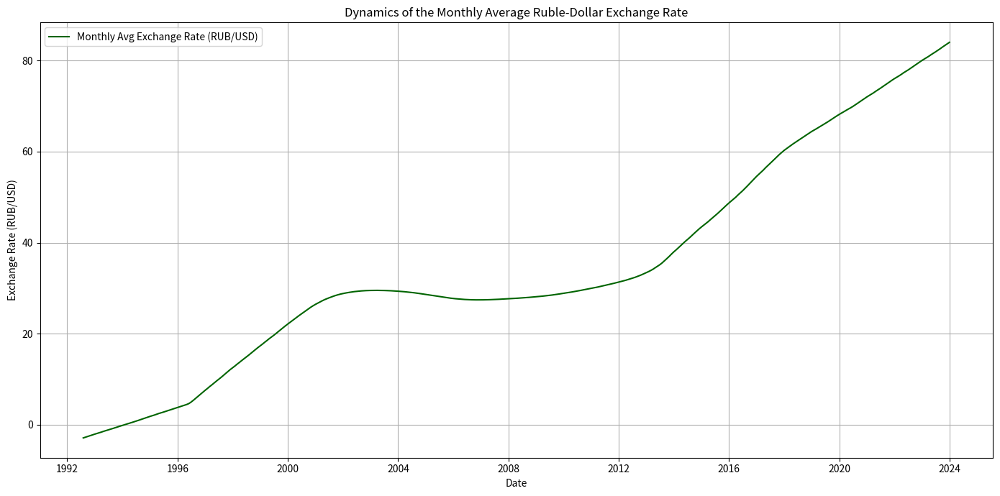

In [155]:
syv.plot_and_save_monthly_avg_exchange_rate(monthly_avg_ex_rates)

Рассчитаем номинальные долларовые цены.

In [156]:
# Convert dates to datetime format
primary_deals_ts['date'] = pd.to_datetime(primary_deals_ts['date'])
primary_offers_ts['date'] = pd.to_datetime(primary_offers_ts['date'])
secondary_deals_ts['date'] = pd.to_datetime(secondary_deals_ts['date'])
secondary_offers_ts['date'] = pd.to_datetime(secondary_offers_ts['date'])


# Calculate prices in dollars
primary_deals_ts_usd = syv.convert_to_usd(primary_deals_ts, monthly_avg_ex_rates, 'value')
primary_offers_ts_usd = syv.convert_to_usd(primary_offers_ts, monthly_avg_ex_rates, 'value')
secondary_deals_ts_usd = syv.convert_to_usd(secondary_deals_ts, monthly_avg_ex_rates, 'value')
secondary_offers_ts_usd = syv.convert_to_usd(secondary_offers_ts, monthly_avg_ex_rates, 'value')

# Round 'value_usd' column to 0 decimal places
primary_deals_ts_usd['value_usd'] = primary_deals_ts_usd['value_usd'].round(0)
primary_offers_ts_usd['value_usd'] = primary_offers_ts_usd['value_usd'].round(0)
secondary_deals_ts_usd['value_usd'] = secondary_deals_ts_usd['value_usd'].round(0)
secondary_offers_ts_usd['value_usd'] = secondary_offers_ts_usd['value_usd'].round(0)

# Convert 'value_usd' column to integer
primary_deals_ts_usd['value_usd'] = primary_deals_ts_usd['value_usd'].astype(int)
primary_offers_ts_usd['value_usd'] = primary_offers_ts_usd['value_usd'].astype(int)
secondary_deals_ts_usd['value_usd'] = secondary_deals_ts_usd['value_usd'].astype(int)
secondary_offers_ts_usd['value_usd'] = secondary_offers_ts_usd['value_usd'].astype(int)

# Sort data frames by date
primary_deals_ts_usd, primary_offers_ts_usd,secondary_deals_ts_usd,\
secondary_offers_ts_usd = syv.sort_dataframe_by_date(primary_deals_ts_usd,\
                                                     primary_offers_ts_usd,\
                                                     secondary_deals_ts_usd,\
                                                     secondary_offers_ts_usd)

### 5.5.2 Визуализация

Построим графики динамики номинальных долларовых цен для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

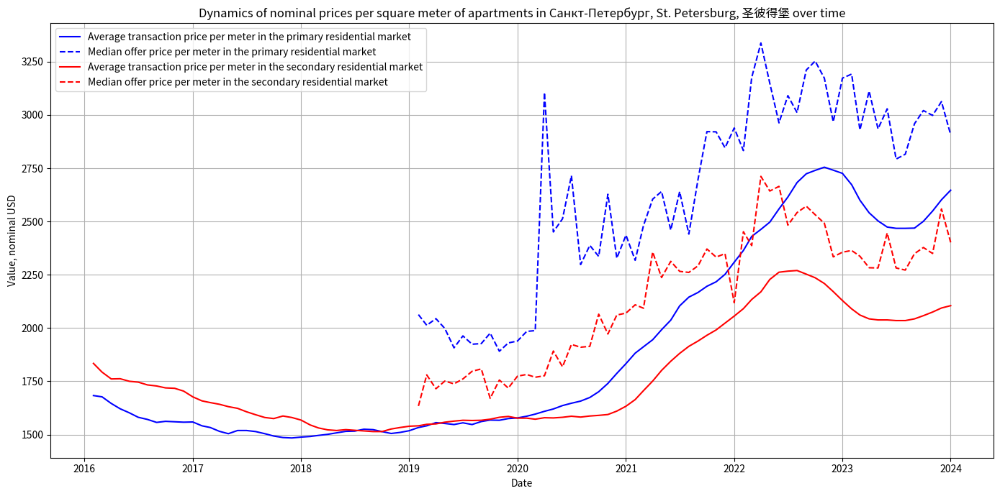

In [157]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Санкт-Петербург, St. Petersburg, 圣彼得堡')

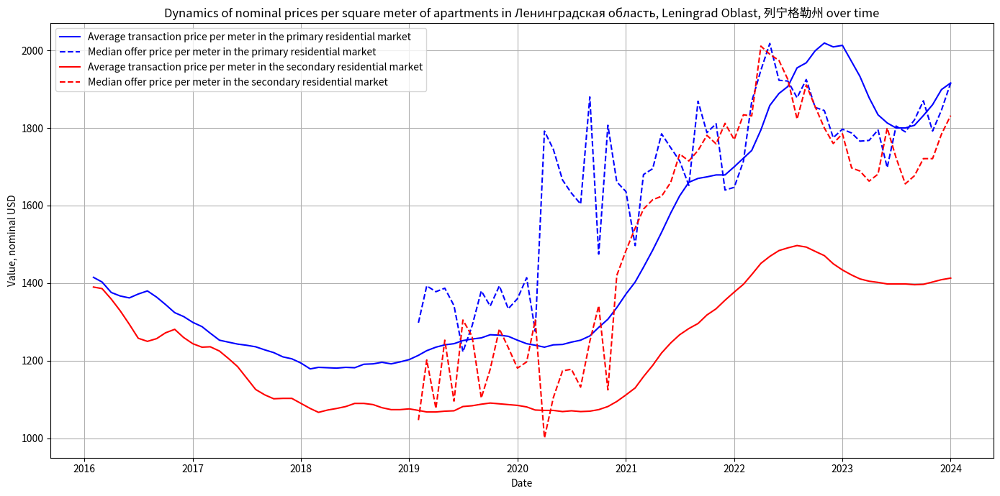

In [158]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Ленинградская область, Leningrad Oblast, 列宁格勒州')

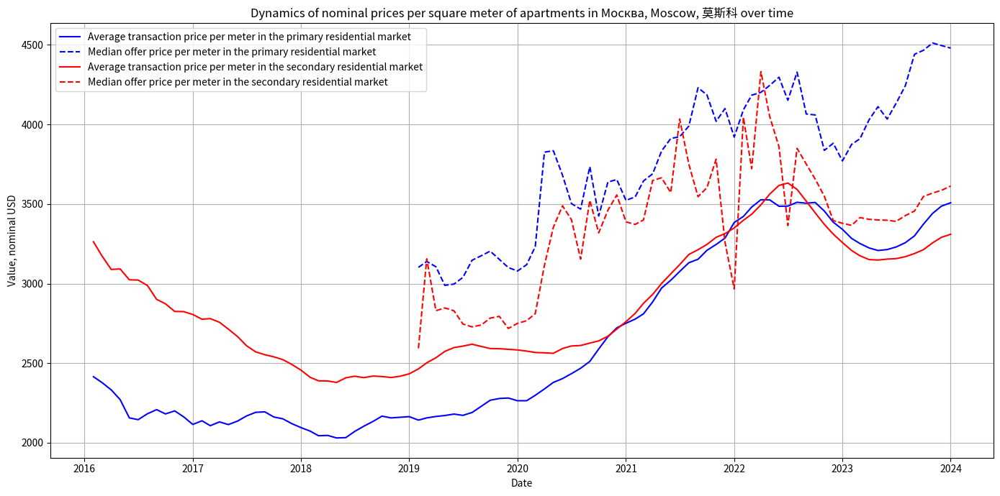

In [159]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Москва, Moscow, 莫斯科')

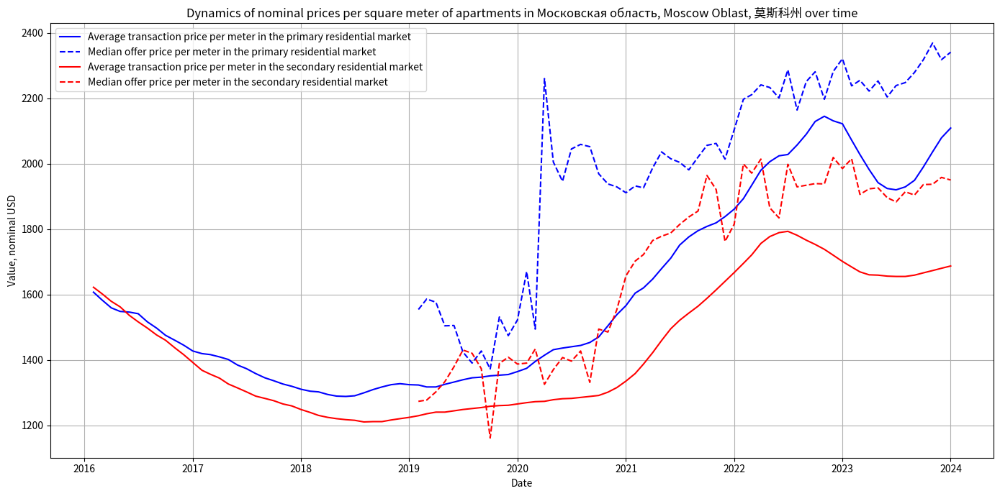

In [160]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Московская область, Moscow Oblast, 莫斯科州')

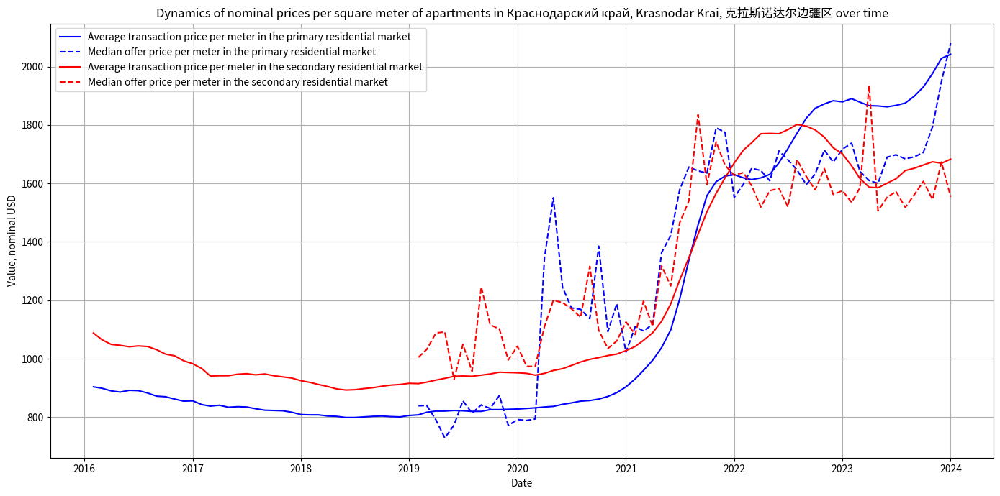

In [161]:
syv.plot_market_nomimal_usd_price_indicators(primary_deals_ts_usd,
                                             primary_offers_ts_usd,
                                             secondary_deals_ts_usd,
                                             secondary_offers_ts_usd,
                                             'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [162]:
syv.save_nominal_usd_prices_plots(primary_deals_ts_usd,
                              primary_offers_ts_usd,
                              secondary_deals_ts_usd,
                              secondary_offers_ts_usd)

## 5.6 Анализ реальных долларовых ценовых индикаторов

#### 5.6.1 Обработка данных о годовых темпах инфляции

В качестве источника данных об инфляции в США используются [данные](https://databank.worldbank.org/source/world-development-indicators/Series/NY.GDP.DEFL.KD.ZG#) Всемирного банка.

In [163]:
annual_inflation_usd = syv.read_inflation_data_usa()

Выполним сглаживание данных с помощью метода [LOWESS](https://en.wikipedia.org/wiki/Local_regression).

In [164]:
annual_inflation_usd_smoothed = syv.smooth_lowess(annual_inflation_usd, 'year', 'inflation', frac=0.3)

Построим график инфляции в линейной шкале.

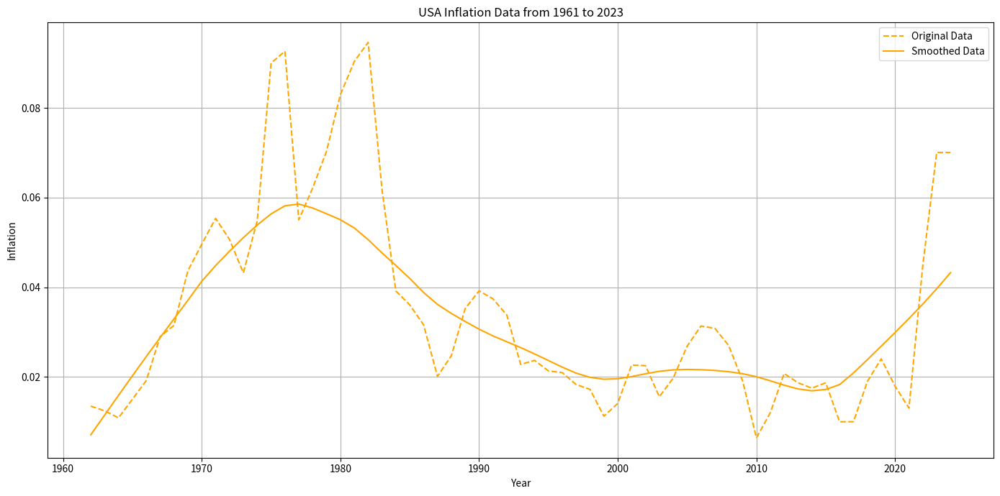

In [165]:
syv.plot_inflation_data(annual_inflation_usd, annual_inflation_usd_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="USA Inflation Data from 1961 to 2023",
                        start_date="1961-01-01",
                        end_date="2023-12-31",
                        yscale = 'linear')

Построим график инфляции с 2002 по 2023 год включительно.

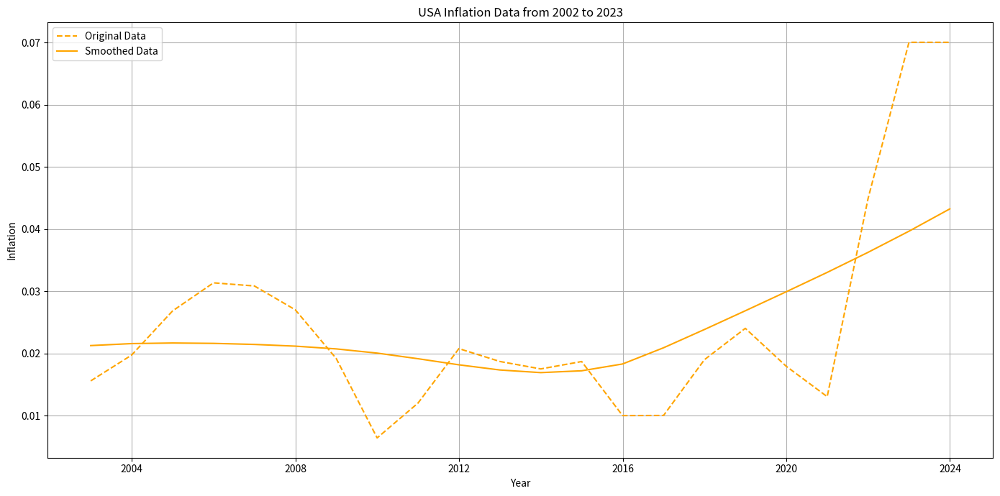

In [166]:
syv.plot_inflation_data(annual_inflation_usd, annual_inflation_usd_smoothed,
                        raw_label='Original Data', smoothed_label='Smoothed Data',
                        title="USA Inflation Data from 2002 to 2023",
                        start_date="2002-01-01",
                        end_date="2023-12-31",
                        yscale = 'linear')

Графики доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [167]:
# Plot inflation from 1961 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_usd, annual_inflation_usd_smoothed,
                        file_name='usa_annual_inflation_1961_2023_linear',
                        start_date="1961-01-01", end_date="2023-12-31", 
                        yscale='linear', title="U.S. inflation data from 1990 to 2023 (linear scale)")

# Plot inflation from 2002 to 2023 in linear scale
syv.save_inflation_plot(annual_inflation_usd, annual_inflation_usd_smoothed,
                        file_name='usa_annual_inflation_2002_2023_linear',
                        start_date="2002-01-01", end_date="2023-12-31", 
                        yscale='linear', title="U.S. inflation data from 2002 to 2023 (linear scale)")

#### 5.6.2 Расчёт месячной инфляции

Рассчитаем месячные темпы инфляции.

In [168]:
monthly_inflation_usd = syv.calculate_monthly_inflation(annual_inflation_usd_smoothed,
                                                       inflation_column='smoothed_inflation')
monthly_inflation_usd = syv.filter_date_range(monthly_inflation_usd, start_date="2016-01", end_date="2023-12")
monthly_inflation_usd = syv.convert_date_to_month_year(monthly_inflation_usd)
monthly_inflation_usd = monthly_inflation_usd[0]
monthly_inflation_usd = monthly_inflation_usd.reset_index(drop=True)

Рассчитаем индексы инфляции относительно базовой даты 2020-01-01.

In [169]:
monthly_inflation_usd_relative = syv.calculate_relative_inflation(monthly_inflation_usd.copy())

#### 5.6.3 Расчёт реальных цен для каждого региона и месяца

Рассчитаем реальные рублёвые цены сделок и предложений.

In [170]:
# Read data
primary_deals_ts_usd, primary_offers_ts_usd,\
secondary_deals_ts_usd, secondary_offers_ts_usd = syv.sort_dataframe_by_date(primary_deals_ts_usd,\
                                                            primary_offers_ts_usd,\
                                                            secondary_deals_ts_usd,\
                                                            secondary_offers_ts_usd)

# Set the appropriate date format
monthly_inflation_usd_relative['date'] = monthly_inflation_usd_relative['date'].dt.to_timestamp()
primary_deals_ts_usd['date'] = pd.to_datetime(primary_deals_ts_usd['date'])
primary_deals_ts_usd['date'] = primary_deals_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts_usd['date'] = pd.to_datetime(primary_offers_ts_usd['date'])
primary_offers_ts_usd['date'] = primary_offers_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
secondary_deals_ts_usd['date'] = pd.to_datetime(secondary_deals_ts_usd['date'])
secondary_deals_ts_usd['date'] = secondary_deals_ts_usd['date'].dt.to_period('M').dt.to_timestamp()
primary_offers_ts_usd['date'] = pd.to_datetime(primary_offers_ts_usd['date'])
primary_offers_ts_usd['date'] = primary_offers_ts_usd['date'].dt.to_period('M').dt.to_timestamp()

In [171]:
# Calculate real prices
primary_deals_real_usd, primary_offers_real_usd,\
secondary_deals_real_usd, secondary_offers_real_usd = \
    syv.calculate_real_prices(monthly_inflation_usd_relative, 
                              'cumulative_inflation',
                              primary_deals_ts_usd,
                              primary_offers_ts_usd,
                              secondary_deals_ts_usd,
                              secondary_offers_ts_usd,
                              value_column='value_usd')

In [172]:
# Round real prices
primary_deals_real_usd['value_usd_real'] = primary_deals_real_usd['value_usd_real'].round(0).astype(int)
primary_offers_real_usd['value_usd_real'] = primary_offers_real_usd['value_usd_real'].round(0).astype(int)
secondary_deals_real_usd['value_usd_real'] = secondary_deals_real_usd['value_usd_real'].round(0).astype(int)
secondary_offers_real_usd['value_usd_real'] = secondary_offers_real_usd['value_usd_real'].round(0).astype(int)

#### 5.6.4 Визуализация реальных долларовых цен

Построим графики динамики реальных цен для пяти ключевых регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

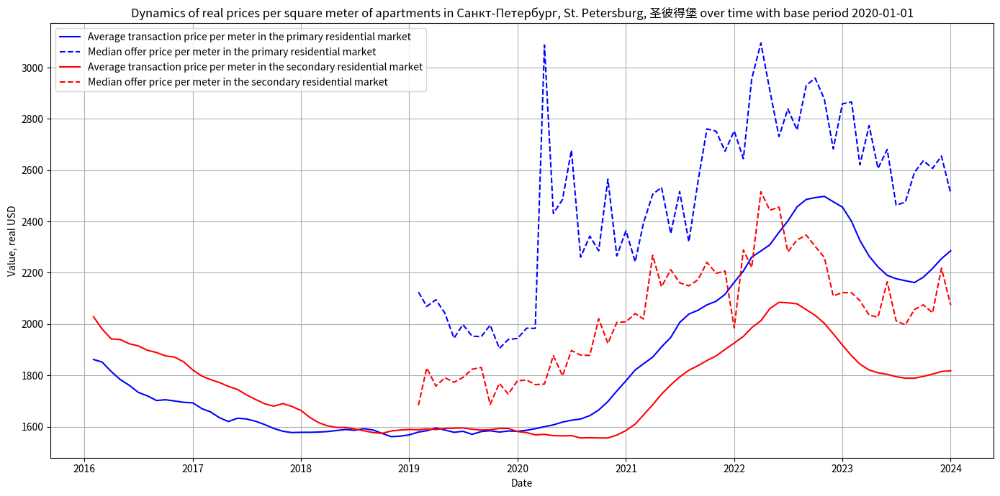

In [173]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Санкт-Петербург, St. Petersburg, 圣彼得堡')

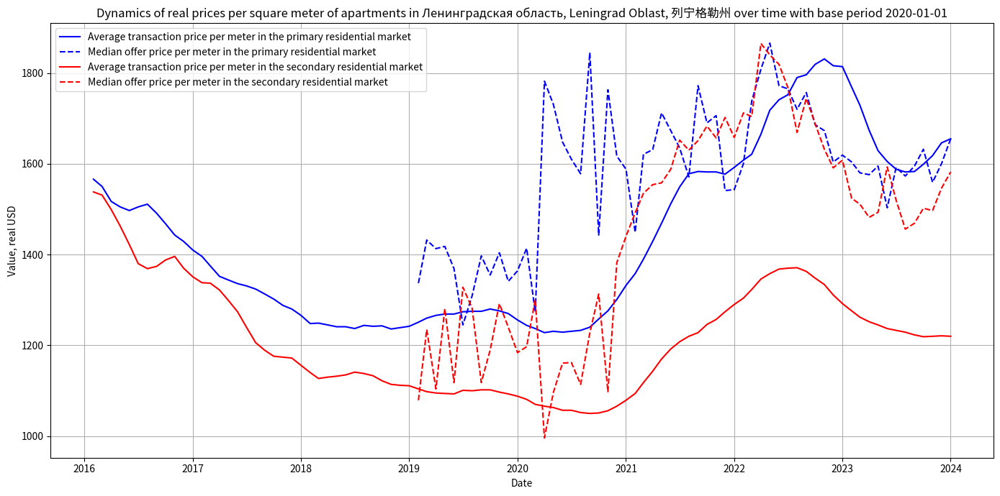

In [174]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Ленинградская область, Leningrad Oblast, 列宁格勒州')

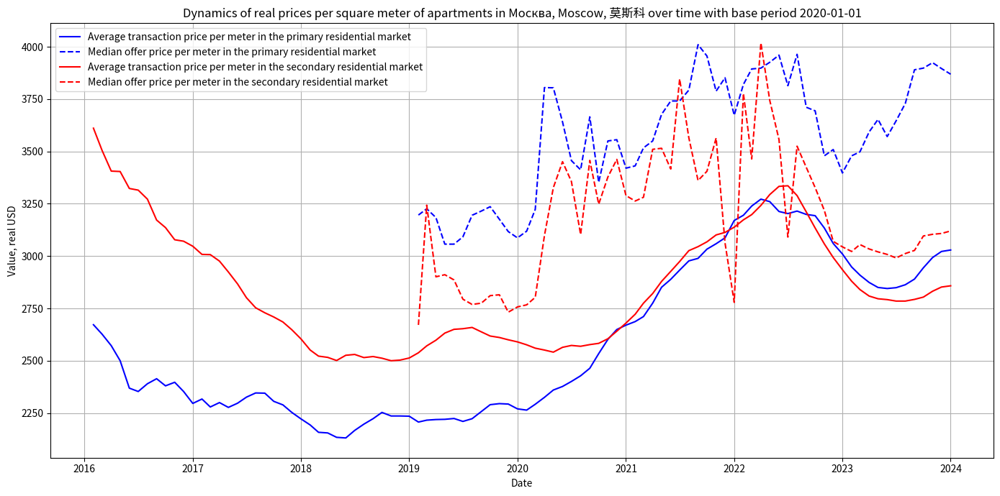

In [175]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Москва, Moscow, 莫斯科')

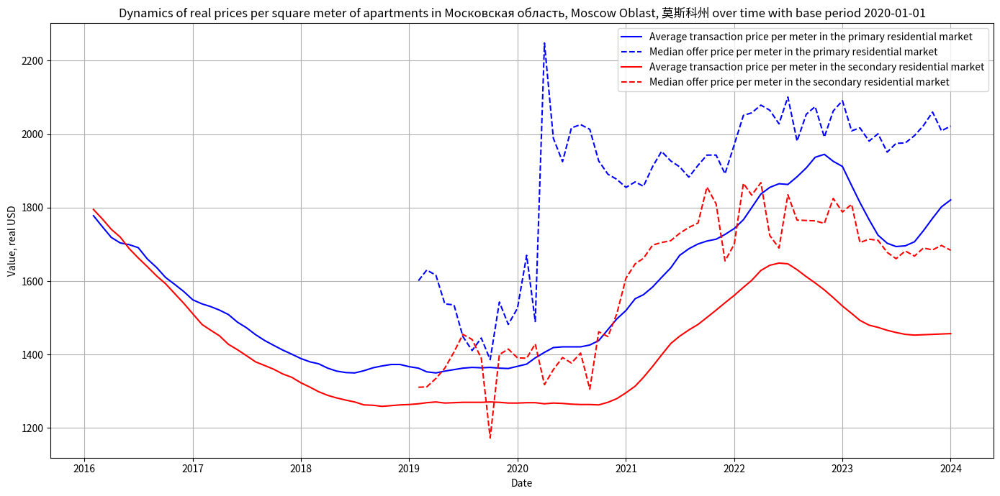

In [176]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Московская область, Moscow Oblast, 莫斯科州')

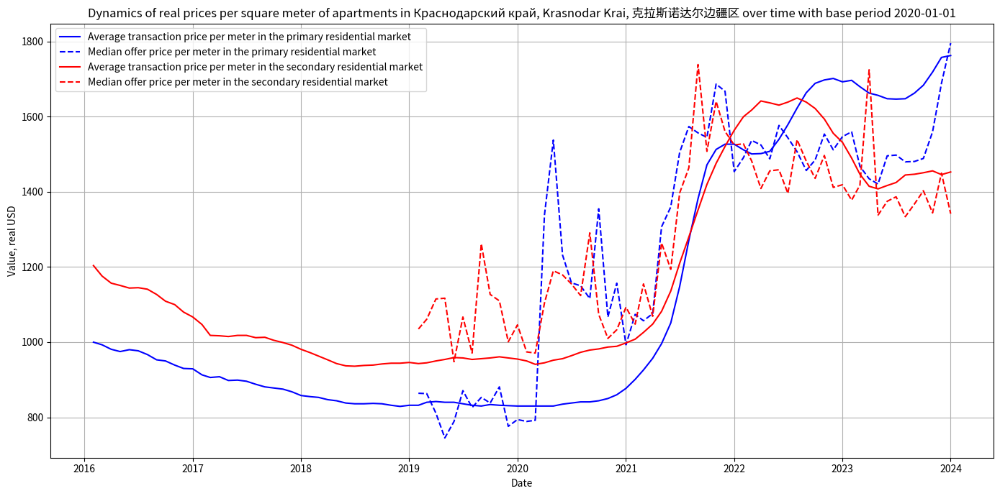

In [177]:
syv.plot_market_real_usd_price_indicators(primary_deals_real_usd,
                                      primary_offers_real_usd,
                                      secondary_deals_real_usd,
                                      secondary_offers_real_usd,
                                      'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Графики для всех регионов доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [178]:
syv.save_real_usd_prices_plots(primary_deals_real_usd,
                           primary_offers_real_usd,
                           secondary_deals_real_usd,
                           secondary_offers_real_usd)

## 5.7 Анализ относительного изменения индикаторов цен в регионах

Рассмотрим относительное изменение номинальных рублёвых цен сделок на первичном рынке жилья в многоквартирных домах. Для этого будет построена [диаграмма рассеяния](https://en.wikipedia.org/wiki/Scatter_plot), по оси X которой отложены логарифмы значений на январь 2020 года, а по оси Y &mdash; на январь 2024 года. Каждая точка представляет собой конкретный регион. Её положение на диаграмме по оси X определено значением логарифма средней цены сделок на первичном рынке по состоянию на 2020-01-01. А положение по оси Y определено значением логарифма средней цены сделок на первичном рынке по состоянию на 2024-01-01. Далее была построена линейная модель, описывающая зависимость цены по состоянию на 2024-01-01 от цены на 2020-01-01. Использовалась простейшая версия модели, использующая в качестве метрики качества квадраты ошибок (МНК). Интерпретация диаграммы может быть осуществлена следующим образом: регионы, лежащие выше прямой линейной модели, характеризуются ростом цены выше общего тренда, а регионы, лежащие ниже прямой линейной модели, характеризуются ростом цены ниже общего тренда. Далее приводятся две диаграммы: статичная и интерактивная, а также общие характеристики линейной модели. 


/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


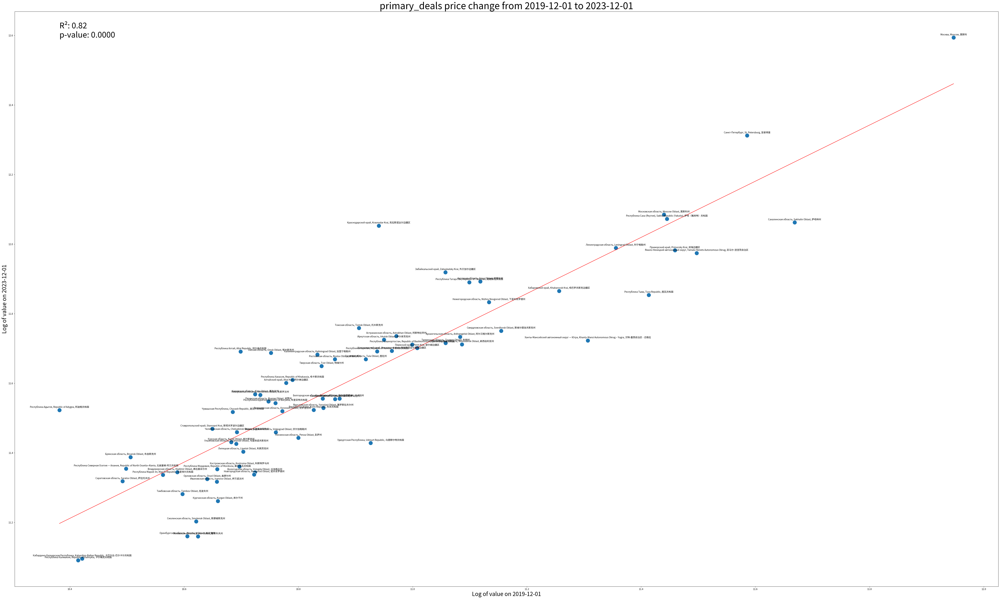

In [179]:
pds_model_summary = syv.plot_log_indicator_change(primary_deals_ts,
                                              'primary_deals', 'value', 'region', '2019-12-01', '2023-12-01')

In [180]:
print(pds_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.817
Model:                             OLS   Adj. R-squared:                  0.814
Method:                  Least Squares   F-statistic:                     316.1
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           7.43e-28
Time:                         11:45:18   Log-Likelihood:                 51.165
No. Observations:                   73   AIC:                            -98.33
Df Residuals:                       71   BIC:                            -93.75
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [181]:
pdi_model_summary = syv.plot_log_indicator_change_interactive(primary_deals_ts,
                                                      'primary_deals_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Аналогичным образом рассмотрим относительное изменение номинальных рублёвых цен сделок на вторичном рынке жилья в многоквартирных домах.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



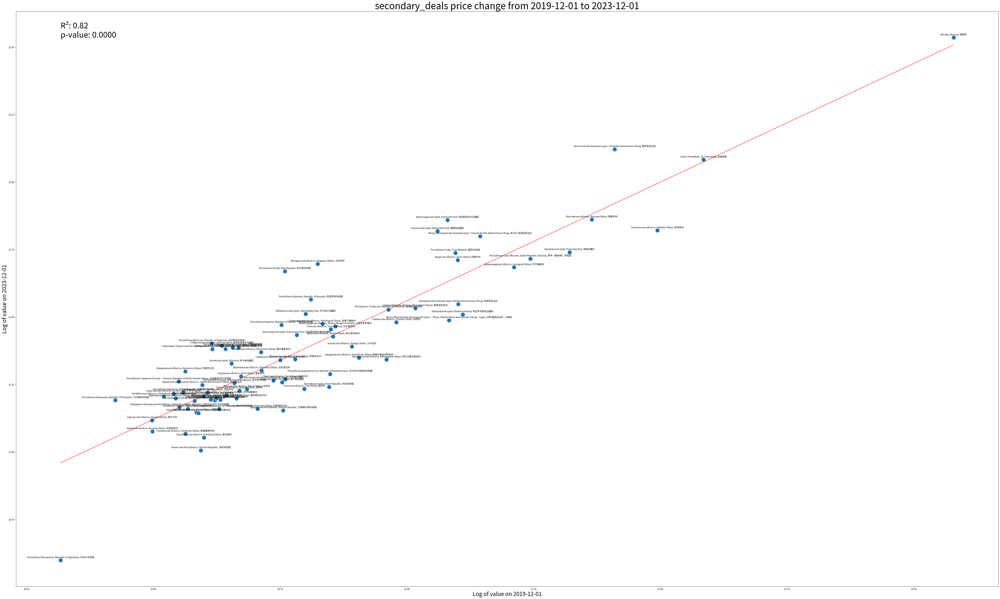

In [182]:
sds_model_summary = syv.plot_log_indicator_change(secondary_deals_ts,
                                              'secondary_deals',
                                                  'value',
                                                  'region',
                                                  '2019-12-01',
                                                  '2023-12-01')

In [183]:
print(sds_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.821
Model:                             OLS   Adj. R-squared:                  0.818
Method:                  Least Squares   F-statistic:                     370.8
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           5.72e-32
Time:                         11:45:36   Log-Likelihood:                 59.406
No. Observations:                   83   AIC:                            -114.8
Df Residuals:                       81   BIC:                            -110.0
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [184]:
sdi_model_summary = syv.plot_log_indicator_change_interactive(secondary_deals_ts,
                                                      'secondary_deals_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Аналогичным образом рассмотрим относительное изменение номинальных рублёвых цен предложений на первичном рынке жилья в многоквартирных домах.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



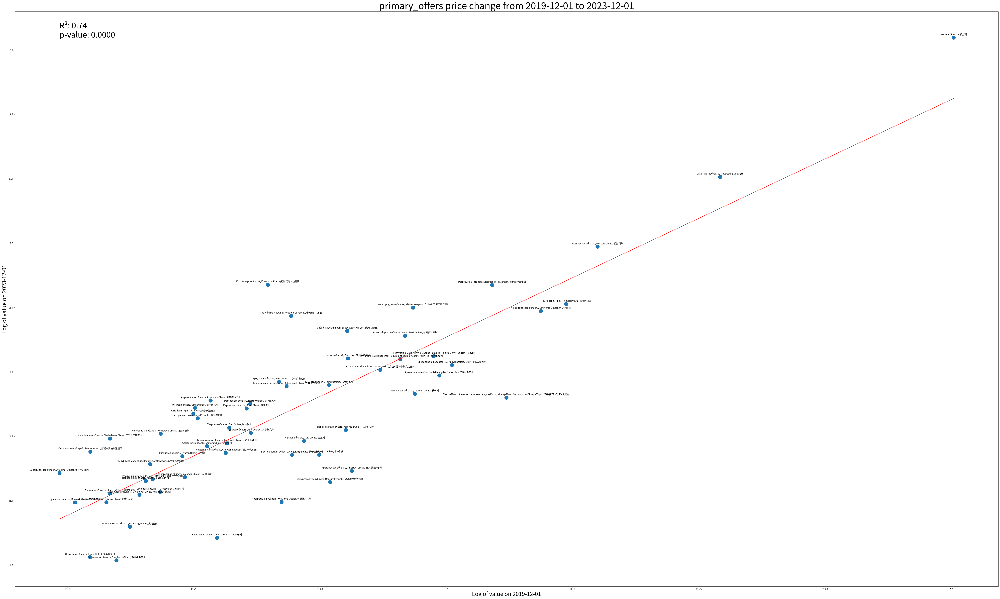

In [185]:
pos_model_summary = syv.plot_log_indicator_change(primary_offers_ts,
                                              'primary_offers',
                                                  'value',
                                                  'region',
                                                  '2019-12-01',
                                                  '2023-12-01')

In [186]:
print(pos_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.744
Model:                             OLS   Adj. R-squared:                  0.740
Method:                  Least Squares   F-statistic:                     162.9
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           3.24e-18
Time:                         11:46:09   Log-Likelihood:                 30.238
No. Observations:                   58   AIC:                            -56.48
Df Residuals:                       56   BIC:                            -52.36
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [187]:
poi_model_summary = syv.plot_log_indicator_change_interactive(primary_offers_ts,
                                                      'primary_offers_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Аналогичным образом рассмотрим относительное изменение номинальных рублёвых цен предложений на вторичном рынке жилья в многоквартирных домах.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



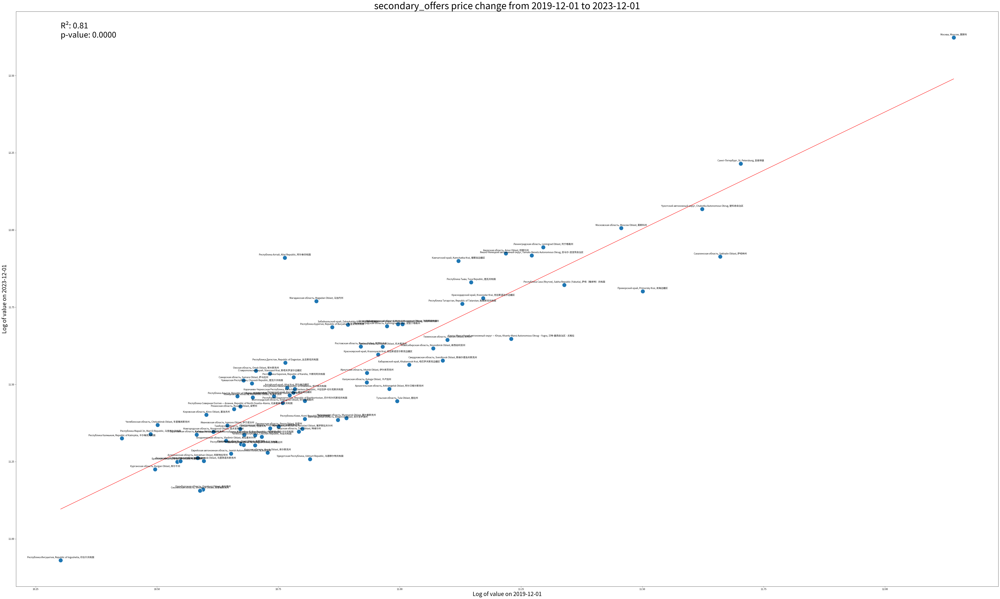

In [188]:
sos_model_summary = syv.plot_log_indicator_change(secondary_offers_ts,
                                              'secondary_offers', 'value', 'region', '2019-12-01', '2023-12-01')

In [189]:
print(sos_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.810
Model:                             OLS   Adj. R-squared:                  0.807
Method:                  Least Squares   F-statistic:                     344.3
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           6.63e-31
Time:                         11:46:20   Log-Likelihood:                 61.828
No. Observations:                   83   AIC:                            -119.7
Df Residuals:                       81   BIC:                            -114.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [190]:
soi_model_summary = syv.plot_log_indicator_change_interactive(secondary_offers_ts,
                                                      'secondary_offers_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Аналогичным образом рассмотрим относительное изменение объёмов предложения на первичном рынке жилья в многоквартирных домах.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



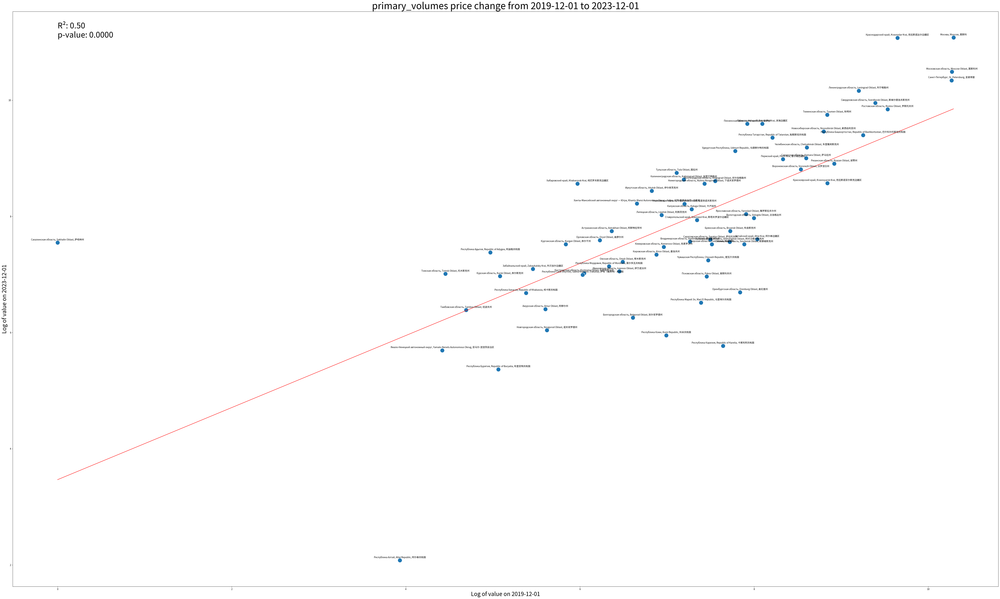

In [191]:
pvs_model_summary = syv.plot_log_indicator_change(primary_volumes_ts,
                                              'primary_volumes', 'value', 'region', '2019-12-01', '2023-12-01')

In [192]:
print(pvs_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.504
Model:                             OLS   Adj. R-squared:                  0.497
Method:                  Least Squares   F-statistic:                     68.09
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           8.47e-12
Time:                         11:46:30   Log-Likelihood:                -100.69
No. Observations:                   69   AIC:                             205.4
Df Residuals:                       67   BIC:                             209.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [193]:
pvi_model_summary = syv.plot_log_indicator_change_interactive(primary_volumes_ts,
                                                      'primary_volumes_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

Аналогичным образом рассмотрим относительное изменение объёмов предложения на вторичном рынке жилья в многоквартирных домах.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



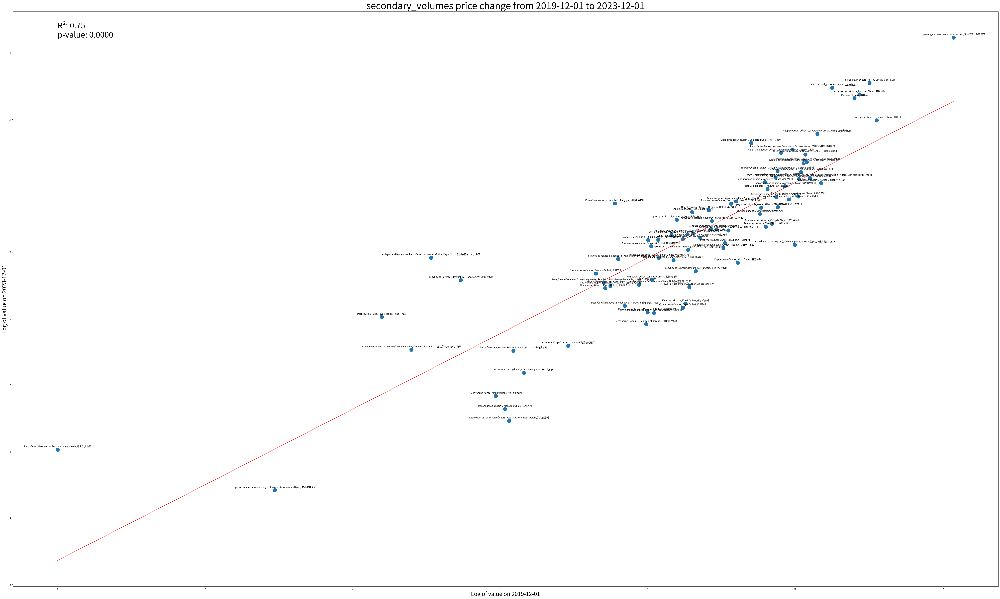

In [194]:
svs_model_summary = syv.plot_log_indicator_change(secondary_volumes_ts,
                                              'secondary_volumes', 'value', 'region', '2019-12-01', '2023-12-01')

In [195]:
print(svs_model_summary)

                             OLS Regression Results                            
Dep. Variable:     2023-12-01 00:00:00   R-squared:                       0.750
Model:                             OLS   Adj. R-squared:                  0.747
Method:                  Least Squares   F-statistic:                     240.4
Date:                 Thu, 21 Mar 2024   Prob (F-statistic):           8.08e-26
Time:                         11:46:38   Log-Likelihood:                -76.484
No. Observations:                   82   AIC:                             157.0
Df Residuals:                       80   BIC:                             161.8
Df Model:                            1                                         
Covariance Type:             nonrobust                                         
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                   

In [196]:
svi_model_summary = syv.plot_log_indicator_change_interactive(secondary_volumes_ts,
                                                      'secondary_volumes_ts', 'value',
                                                      'region', '2019-12-01', '2023-12-01')

## 6 Вопросы доступности жилья

В качестве индикатора доступности жилья используется простое отношение средней стоимости одного квадратного метра, к средней зарплате по данным Росстата. Формула расчёта индекса доступности:

\begin{align}
A_{i} = \frac{\text{Mean Transaction Price per 1 Square Meter}}{\text{Mean Salary}}.
\end{align}

Таким образом, конкретное значение индекса доступности означает количество квадратных метров, которые можно купить на одну среднюю зарплату в регионе.

Гармонизируем названия регионов.

In [197]:
salaries_df = syv.read_salary_data()

Salary data loaded successfully.


In [198]:
salaries_df = syv.correct_region_names_with_hardcoded_mapping(salaries_df)

In [199]:
syv.check_region_name_mismatches(primary_deals_ts, secondary_deals_ts,
                             salaries_df, 'region', 'region')

All region names match between price and salary data frames.


In [200]:
salaries_df = syv.set_dates_to_month_end(salaries_df,'date')

Проведём сглаживание значений заработных плат для исключения сезонной компоненты с использованием метода Holt-Winters' и скользящего среднего с окном 25.

In [201]:
seasonal_periods = 12 # Assuming monthly data and annual seasonality
salaries_df = syv.apply_holt_winters(salaries_df,
                                       'date', 'region', 'salary',
                                       seasonal_periods,
                                       smoothing_level=0.2,
                                       smoothing_trend=0.2,
                                       smoothing_seasonal=0.1)  # Adjust smoothing parameters as needed

In [202]:
salaries_df = syv.smooth_with_moving_average(
    df=salaries_df,
    date_col='date',
    value_col='smoothed_salary',
    region_col='region',
    window_size=25)

## 6.1 Текущее состояние доступности жилья в регионах

### 6.1.1 Первичный рынок

Рассчитаем значения индекса доступности жилья за период 2016-01 &mdash; 2023-12 для всех регионов, представленных в анализе. 

In [203]:
affordability_index_primary_df = syv.calculate_affordability_index(
    price_df=primary_deals_ts, 
    salary_df=salaries_df, 
    price_col='value', 
    salary_col='smoothed_salary_avg'
)

# Display the first few rows of the resulting DataFrame
print(affordability_index_primary_df.head())

                                                 region     date   value  \
0         Забайкальский край, Zabaykalsky Krai, 外贝加尔边疆区  2016-01   49890   
1                Самарская область, Samara Oblast, 萨马拉州  2016-01   45176   
2                 Рязанская область, Ryazan Oblast, 梁赞州  2016-01   38007   
3              Ростовская область, Rostov Oblast, 罗斯托夫州  2016-01   46371   
4     Республика Хакасия, Republic of Khakassia, 哈卡斯共和国  2016-01   42061   
5                 Республика Тыва, Tuva Republic, 图瓦共和国  2016-01   90540   
6     Республика Татарстан, Republic of Tatarstan, 鞑...  2016-01   53110   
7                 Санкт-Петербург, St. Petersburg, 圣彼得堡  2016-01   82734   
8     Республика Северная Осетия — Алания, Republic ...  2016-01   31562   
9     Республика Мордовия, Republic of Mordovia, 莫尔多...  2016-01   42116   
10       Республика Марий Эл, Mari El Republic, 马里埃尔共和国  2016-01   39012   
11                Республика Коми, Komi Republic, 科米共和国  2016-01   54405   
12     Респу

Создадим отдельный набор данных для текущего месяца анализа.

In [204]:
# Create a separate data frame for specific month
affordability_index_primary_df_dec_2023 = affordability_index_primary_df[affordability_index_primary_df['date'] == '2023-12']
affordability_index_primary_df_dec_2023 = affordability_index_primary_df_dec_2023.rename(columns={'value': 'primary_market_price'})
affordability_index_primary_df_dec_2023 = affordability_index_primary_df_dec_2023.rename(columns={'affordability_index': 'affordability_index_primary'})
# Display the filtered DataFrame for December 2023
affordability_index_primary_df_dec_2023

,region,date,primary_market_price,smoothed_salary_avg,affordability_index_primary
7114,"Самарская область, Samara Oblast, 萨马拉州",2023-12,104264,55175.596095,0.529191
7115,"Рязанская область, Ryazan Oblast, 梁赞州",2023-12,103529,52277.922916,0.504959
7116,"Ростовская область, Rostov Oblast, 罗斯托夫州",2023-12,116917,52251.363863,0.446910
7117,"Республика Хакасия, Republic of Khakassia, 哈卡斯共和国",2023-12,110172,45841.215984,0.416088
7118,"Республика Тыва, Tuva Republic, 图瓦共和国",2023-12,140615,61784.408724,0.439387
7119,"Республика Татарстан, Republic of Tatarstan, 鞑...",2023-12,145831,61045.048986,0.418601
7120,"Республика Северная Осетия — Алания, Republic ...",2023-12,85356,41388.463153,0.484892
7121,"Республика Коми, Komi Republic, 科米共和国",2023-12,101055,77396.157076,0.765882
7122,"Республика Мордовия, Republic of Mordovia, 莫尔多...",2023-12,85242,45758.392157,0.536806
7123,"Республика Марий Эл, Mari El Republic, 马里埃尔共和国",2023-12,83830,47629.363332,0.568166


Графически покажем связь между средней заработной платой и средними ценами за 1 кв. м на первичном рынке. Рассчитаем коэффициенты корреляции между этими показателями и соответствующие им p-значения. Интерпретация диаграммы рассеяния может быть осуществлена следующим образом: регионы, расположенные выше красной зоны, характеризуются ценами, опережающими возможности их жителей с точки зрения доходов. Регионы, расположенные ниже красной зоны, напротив характеризуются зарплатами, позволяющими относительно легко приобрести жильё. Регионы, расположенные внутри красной зоны, имеют сбалансированные показатели доходов и цен. Как видно из диаграммы, низкая доступность жилья характерна, в частности, для крупнейших агломераций (Санкт-Петербург, Москва, Краснодар), привлекающих многих жителей других регионов России и других территорий своими высокими стандартами жизни. Высокая доступность жилья характерна, среди прочего, для нефтегазоносных провинций (Тюменская область, ЯНАО, Р. Коми и т.д.), в которых обеспечивается высокий уровень доходов сотрудников, занятых в данном и смежном секторах экономики. При этом, данные регионы характеризуются сложным климатом, невысоким уровнем сервисов (за исключением самого г. Тюмень) и часто не рассматриваются в качестве места постоянного проживания.

Данный анализ показывает существенную положительную корреляцию между доходами и ценами в регионах.

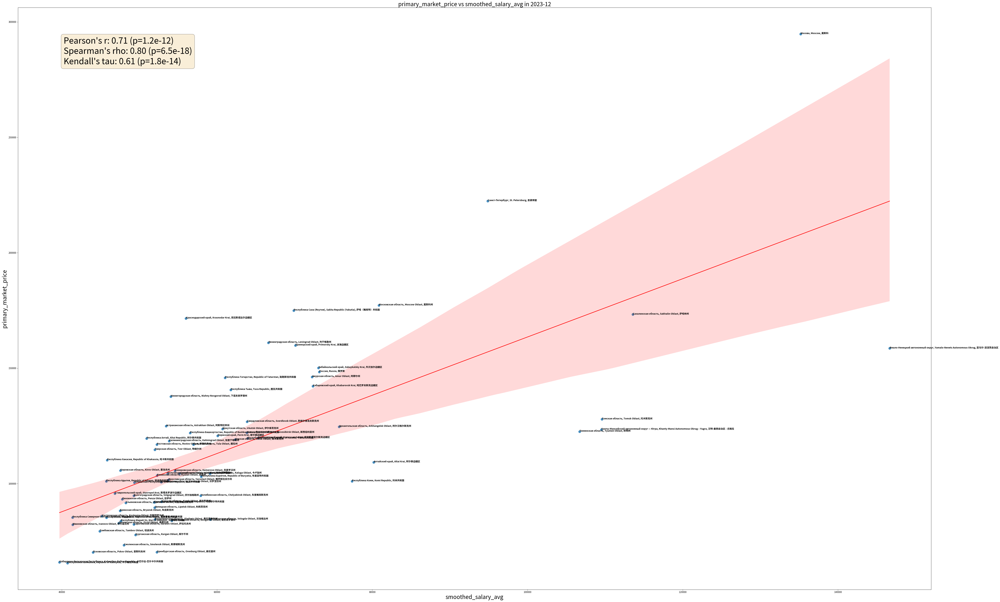

In [205]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='primary_market_price',
    date_col='date',
    region_col='region'
)

Проведём графический анализ связи между доходами и доступностью жилья в регионах. Из диаграммы видно, что для большинства регионов характерна отрицательная связь между доходами и доступностью жилья. Итоговые положительные значения коэффициентов корреляции обусловлены всего несколькими нефтеносными регионами. Общая модель при этом является статистически незначимой и служит только для графического анализа.

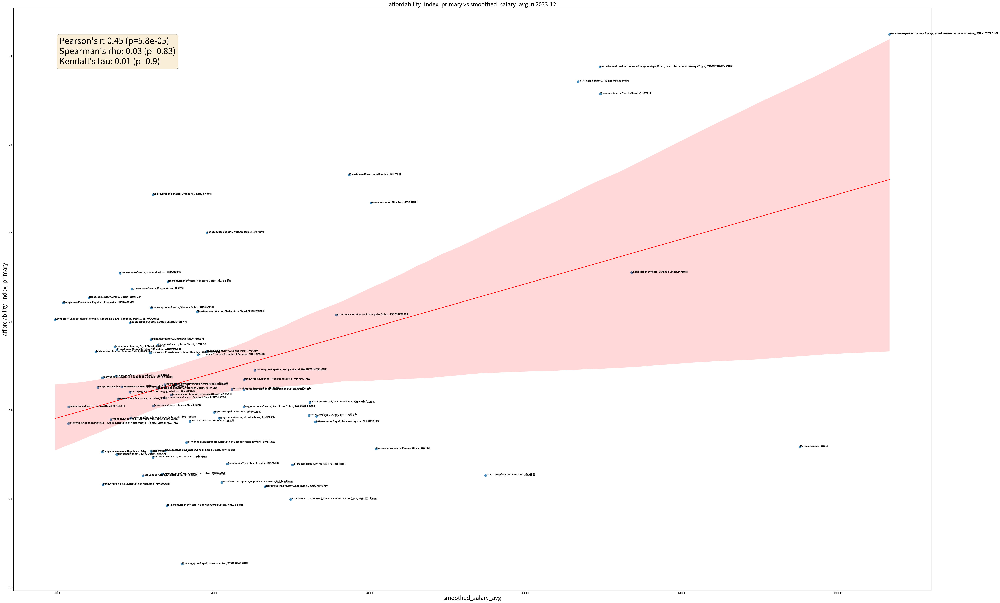

In [206]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='affordability_index_primary',
    date_col='date',
    region_col='region'
)


Проведём графический анализ связи между ценами и доступностью жилья в регионах. Как видно, существует умеренная статистически значимая отрицательная связь между ценами и доступностью. Интерпретация диаграммы может быть осуществлена следующим образом: регионы, расположенные выше красной зоны, обладают относительно высоким уровнем доступности, расположенные ниже &mdash; низким, расположенные внутри неё имеют сбалансированное соотношение цены и доступности.

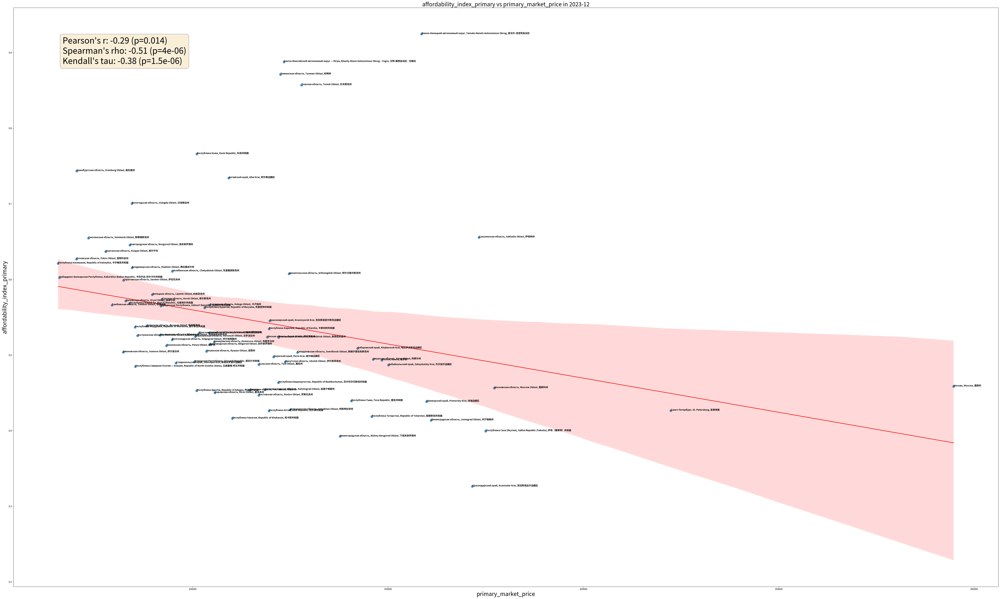

In [207]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_primary_df_dec_2023,
    x_col='primary_market_price',
    y_col='affordability_index_primary',
    date_col='date',
    region_col='region')


Проведём проверку имён регионов в данных по доступности жилья и геоданных.

In [208]:
syv.check_region_name_matching(df1=affordability_index_primary_df_dec_2023,
                               df2=shifted_gdf,
                               region_col='region')

Regions in the affordability data frame but not in the GeoJSON: {'Россия, Russia, 俄罗斯'}
Regions in the GeoJSON but not in the affordability data frame: {'Магаданская область, Magadan Oblast, 马加丹州', 'Чукотский автономный округ, Chukotka Autonomous Okrug, 楚科奇自治区', 'Карачаево-Черкесская Республика, Karachay-Cherkess Republic, 卡拉恰伊-切尔克斯共和国', 'Ненецкий автономный округ, Nenets Autonomous Okrug, 涅涅茨自治区', 'Камчатский край, Kamchatka Krai, 堪察加边疆区', 'Республика Ингушетия, Republic of Ingushetia, 印古什共和国', 'Республика Дагестан, Republic of Dagestan, 达吉斯坦共和国', 'Мурманская область, Murmansk Oblast, 摩尔曼斯克州', 'Еврейская автономная область, Jewish Autonomous Oblast, 犹太自治州', 'Чеченская Республика, Chechen Republic, 车臣共和国'}


Построим и сохраним статичную карту доступности жилья по регионам. Более светлые тона означают низкую доступность, более тёмные &mdash; более высокую.

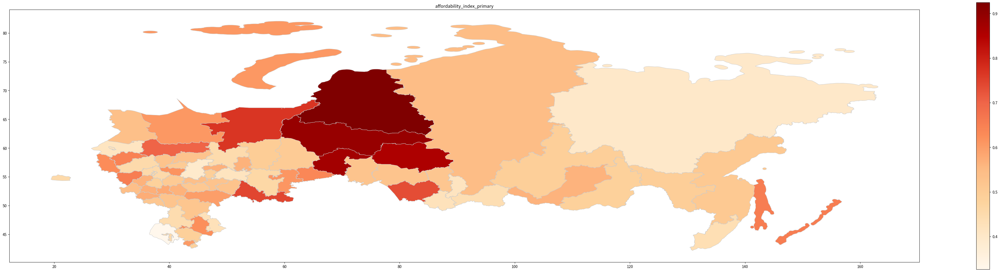

In [209]:
syv.create_and_display_heatmaps_sberindex(
    data=affordability_index_primary_df_dec_2023,
    column_name='affordability_index_primary',
    display_name='affordability_index_primary',
    filename='affordability_index_primary',
    geo_dataframe=shifted_gdf
)


Построим и сохраним интерактивную карту доступности на картографической основе OSM.

In [210]:
syv.create_and_save_choropleth_sberindex(
    data=affordability_index_primary_df_dec_2023,
    column_name='affordability_index_primary',
    display_name='Affordability Index for December 2023',
    geo_dataframe=shifted_gdf,
    dataset_name='affordability_index_primary'
)

### 6.1.2  Вторичный рынок 

Рассчитаем значения индекса доступности жилья за период 2016-01 — 2023-12 для всех регионов, представленных в анализе. 

In [211]:
affordability_index_secondary_df = syv.calculate_affordability_index(
    price_df=secondary_deals_ts, 
    salary_df=salaries_df, 
    price_col='value', 
    salary_col='smoothed_salary_avg'
)

Создадим отдельный набор данных для текущего месяца анализа.

In [212]:
# Create a separate data frame for specific month
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df[affordability_index_secondary_df['date'] == '2023-12']
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df_dec_2023.rename(
    columns={'value': 'secondary_market_price'}
)
affordability_index_secondary_df_dec_2023 = affordability_index_secondary_df_dec_2023.rename(
    columns={'affordability_index': 'affordability_index_secondary'}
)


Графически покажем связь между средней заработной платой и средними ценами за 1 кв. м на вторичном рынке. Рассчитаем коэффициенты корреляции между этими показателями и соответствующие им p-значения. Интерпретация диаграммы рассеяния может быть осуществлена следующим образом: регионы, расположенные выше красной зоны, характеризуются ценами, опережающими возможности их жителей с точки зрения доходов. Регионы, расположенные ниже красной зоны, напротив характеризуются зарплатами, позволяющими относительно легко приобрести жильё. Регионы, расположенные внутри красной зоны, имеют сбалансированные показатели доходов и цен. Как видно, из диаграммы, низкая доступность жилья характерна, в частности, для крупнейших агломераций (Санкт-Петербург, Москва, Краснодар), привлекающих многих жителей других регионов России и других территорий своими высокими стандартами жизни. Высокая доступность жилья характера, среди прочего, для нефтегазоносных провинций (Тюменская область, НАО, ХМАО и т.д.), в которых обеспечивается высокий уровень доходов сотрудников, занятых в данном и смежном секторах экономики. При этом, данные регионы характеризуются сложным климатом, невысоким уровнем сервисов (за исключением самого г. Тюмень) и часто не рассматриваются в качестве места постоянного проживания.

Данный анализ показывает существенную положительную корреляцию между доходами и ценами в регионах.


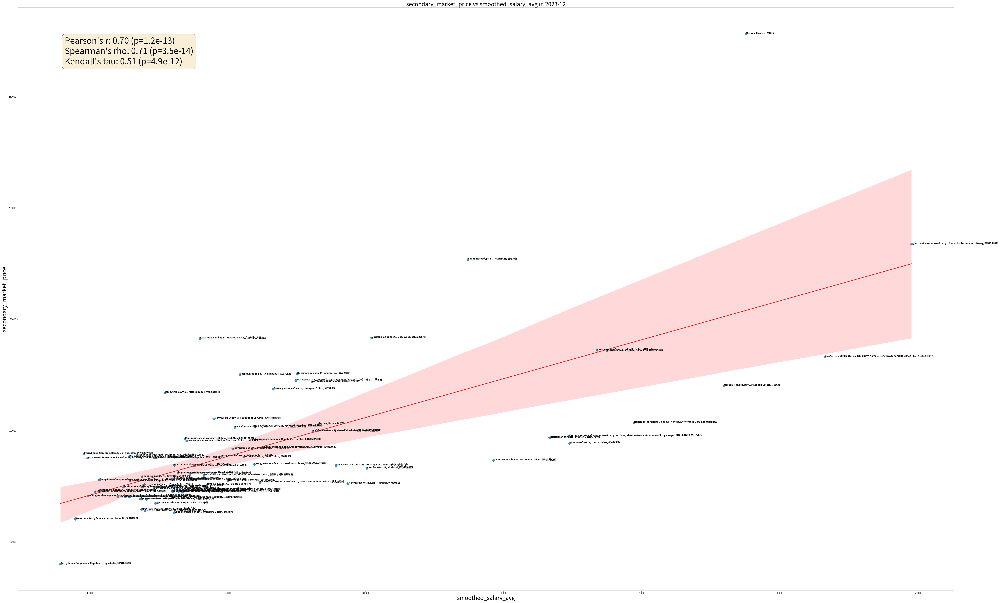

In [213]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='secondary_market_price',
    date_col='date',
    region_col='region'
)

Проведём графический анализ связи между доходами и доступностью жилья в регионах. Из диаграммы видно, что для большинства регионов характерно противоречивая связь между доходами и доступностью жилья. Итоговые положительны значения коэффициентов корреляции обусловлены присутствием ряда нефтегазоносных регионов. Общая модель при этом является статистически значимой и может быть использована с осторожностью.

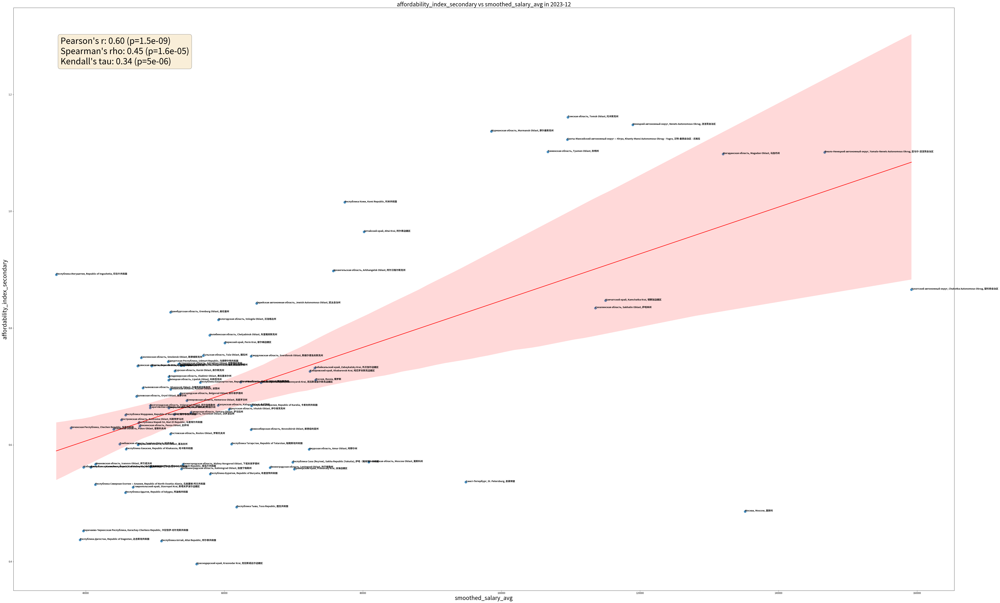

In [214]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='smoothed_salary_avg',
    y_col='affordability_index_secondary',
    date_col='date',
    region_col='region'
)

Проведём графический анализ связи между ценами и доступностью жилья в регионах. Как видно, существует небольшая статистически незначимая отрицательная связь между ценами и доступностью. Интерпретация диаграммы может быть осуществлена следующим образом: регионы, расположенные выше красной зоны, обладают относительно высоким уровнем доступности, расположенные ниже — низким, расположенные внутри неё имеют сбалансированное соотношение цены и доступности. Модель является статистически незначимой и не может прямо использоваться для анализа.

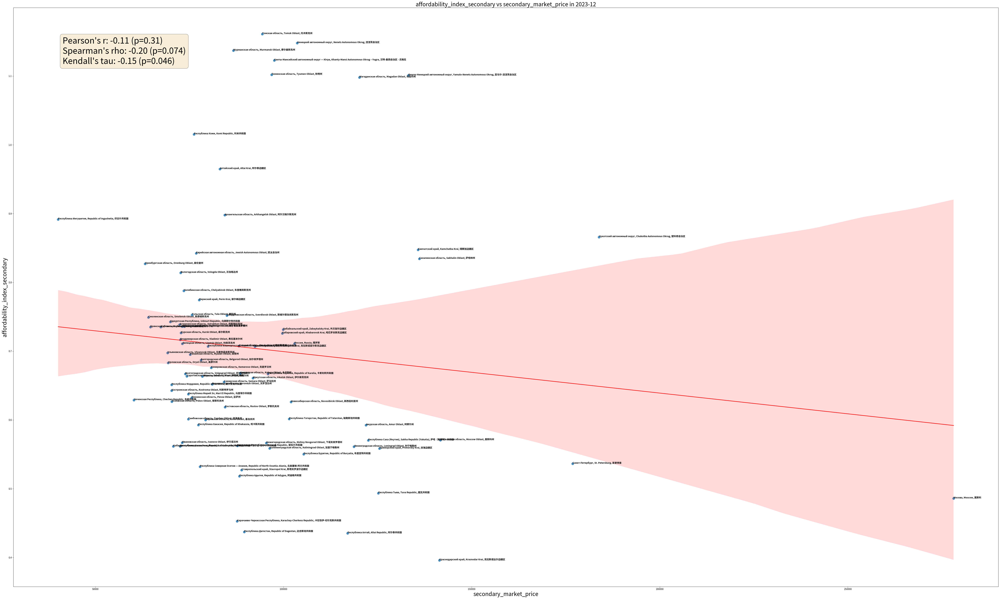

In [215]:
syv.plot_with_correlation_measures_labels_and_trendline(
    df=affordability_index_secondary_df_dec_2023,
    x_col='secondary_market_price',
    y_col='affordability_index_secondary',
    date_col='date',
    region_col='region'
)

Проведём проверку имён регионов в данных по доступности жилья и геоданных.

In [216]:
syv.check_region_name_matching(
    df1=affordability_index_secondary_df_dec_2023,
    df2=shifted_gdf,
    region_col='region')

Regions in the affordability data frame but not in the GeoJSON: {'Россия, Russia, 俄罗斯'}
All regions in the second data frame are also in the first data frame.


Построим и сохраним статичную карту доступности жилья по регионам. Более светлые тона означают низкую доступность, более тёмные — более высокую.

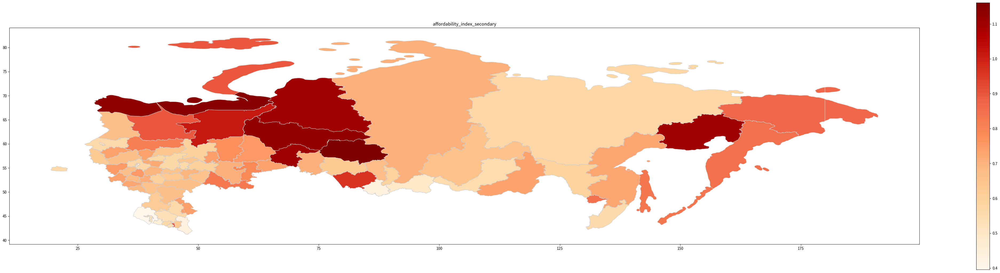

In [217]:
syv.create_and_display_heatmaps_sberindex(
    data=affordability_index_secondary_df_dec_2023,
    column_name='affordability_index_secondary',
    display_name='affordability_index_secondary',
    filename='affordability_index_secondary',
    geo_dataframe=shifted_gdf
)

Построим и сохраним интерактивную карту доступности на картографической основе OSM.

In [218]:
syv.create_and_save_choropleth_sberindex(
    data=affordability_index_secondary_df_dec_2023,
    column_name='affordability_index_secondary',
    display_name='Affordability Index for December 2023',
    geo_dataframe=shifted_gdf,
    dataset_name='affordability_index_secondary'
)

## 6.2 Динамика доступности

Рассмотрим вопрос динамики доступности первичного жилья по регионам. Для этого построим диаграмму рассеяния, по оси X которой отложим значения индекса доступности по состоянию на 2020-01-01, по оси Y &mdash; на 2024-01-01. Также построим линейную модель, в которой предиктором является значение индекса доступности на 2020-01-01, а откликом значение на 2024-01-01. Добавим на график линейный тренд. 

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



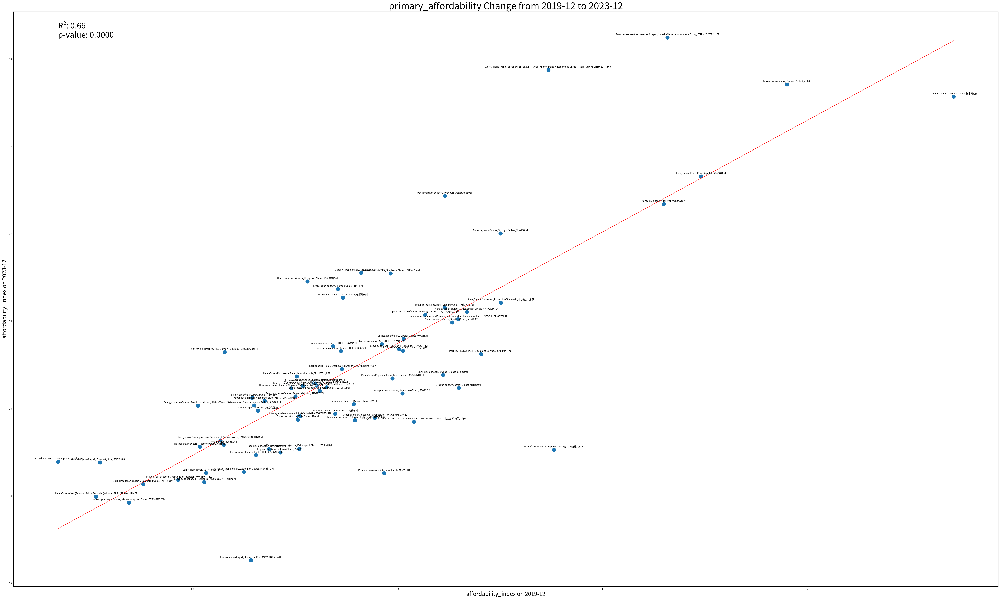

In [219]:
primary_affordability_model_summary = syv.plot_indicator_change(
    affordability_index_primary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12')

Приведём общие сведения о линейной модели. Основные метрики: R-квадрат, p-значение для предиктора, значения критерия Дарбина-Ватсона, коэффициентов асимметрии и эксцесса указывают на значимость модели.

In [220]:
print(primary_affordability_model_summary)

                            OLS Regression Results                            
Dep. Variable:                2023-12   R-squared:                       0.659
Model:                            OLS   Adj. R-squared:                  0.654
Method:                 Least Squares   F-statistic:                     137.0
Date:                Thu, 21 Mar 2024   Prob (F-statistic):           3.09e-18
Time:                        11:50:00   Log-Likelihood:                 92.196
No. Observations:                  73   AIC:                            -180.4
Df Residuals:                      71   BIC:                            -175.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0639      0.042      1.521      0.1

Построим аналогичную интерактивную диаграмму рассеяния.

In [221]:
pai_model_summary = syv.plot_indicator_change_interactive(
    affordability_index_primary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12'
)

Рассмотрим вопрос динамики доступности вторичного жилья по регионам. Для этого построим диаграмму рассеяния, по оси X которой отложим значения индекса доступности по состоянию на 2020-01-01, по оси Y &mdash' на 2024-01-01. Также построим линейную модель, в которой предиктором является значение индекса доступности на 2020-01-01, а откликом значение на 2024-01-01. Добавим на график линейный тренд.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

/home/kaarlahti/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



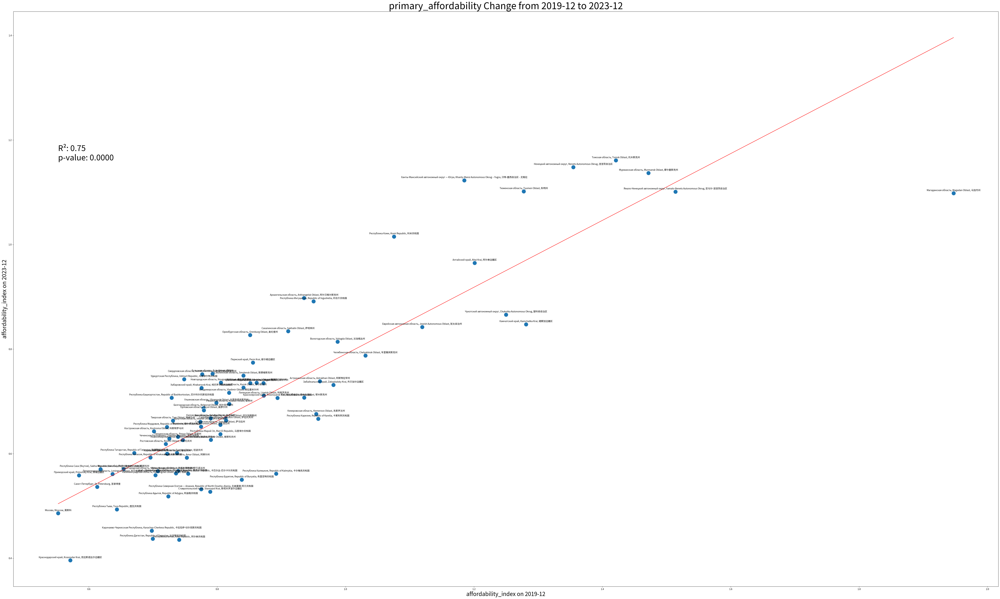

In [222]:
secondary_affordability_model_summary = syv.plot_indicator_change(
    affordability_index_secondary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12')

Приведём общие сведения о линейной модели. Основные метрики: R-квадрат, p-значения предиктора, значения критерия Дарбина-Ватсона, коэффициентов ассиметрии и эксцесса указывают на значимость модели.

In [223]:
print(secondary_affordability_model_summary)

                            OLS Regression Results                            
Dep. Variable:                2023-12   R-squared:                       0.751
Model:                            OLS   Adj. R-squared:                  0.748
Method:                 Least Squares   F-statistic:                     244.6
Date:                Thu, 21 Mar 2024   Prob (F-statistic):           3.46e-26
Time:                        11:50:32   Log-Likelihood:                 85.878
No. Observations:                  83   AIC:                            -167.8
Df Residuals:                      81   BIC:                            -162.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1512      0.037      4.130      0.0

Построим аналогичную интерактивную диаграмму рассеяния.

In [224]:
sai_model_summary = syv.plot_indicator_change_interactive(
    affordability_index_secondary_df,
    'primary_affordability',
    'affordability_index',
    'region',
    '2019-12',
    '2023-12'
)

Построим графики динамики доступности жилья в пяти ключевых регионах: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край.

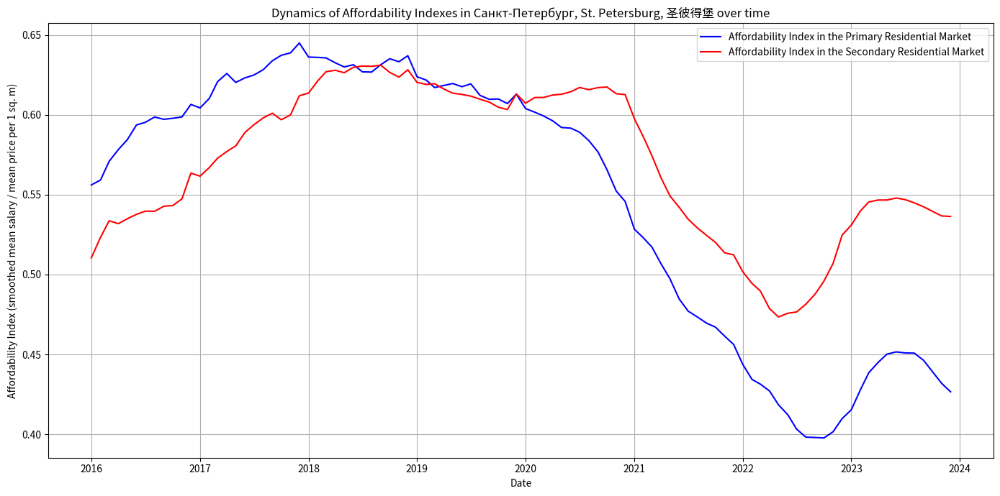

In [225]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Санкт-Петербург, St. Petersburg, 圣彼得堡')

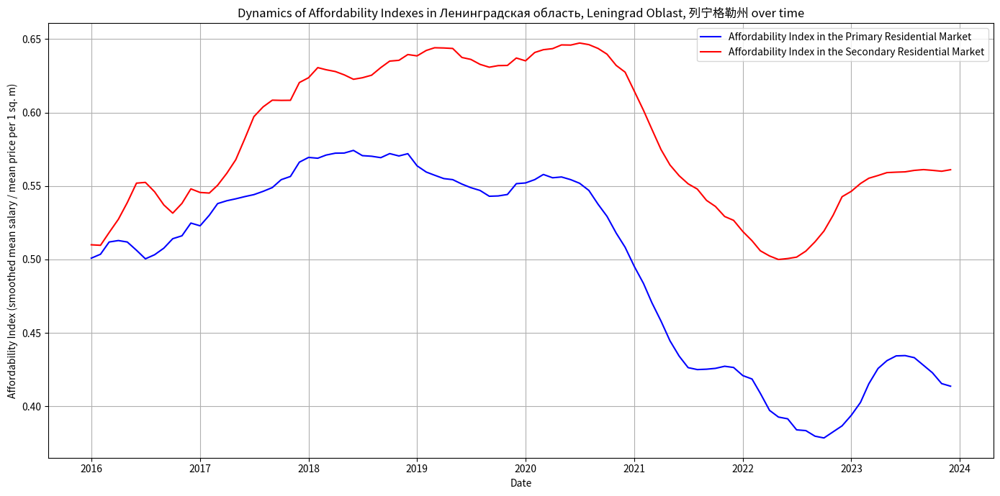

In [226]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Ленинградская область, Leningrad Oblast, 列宁格勒州')

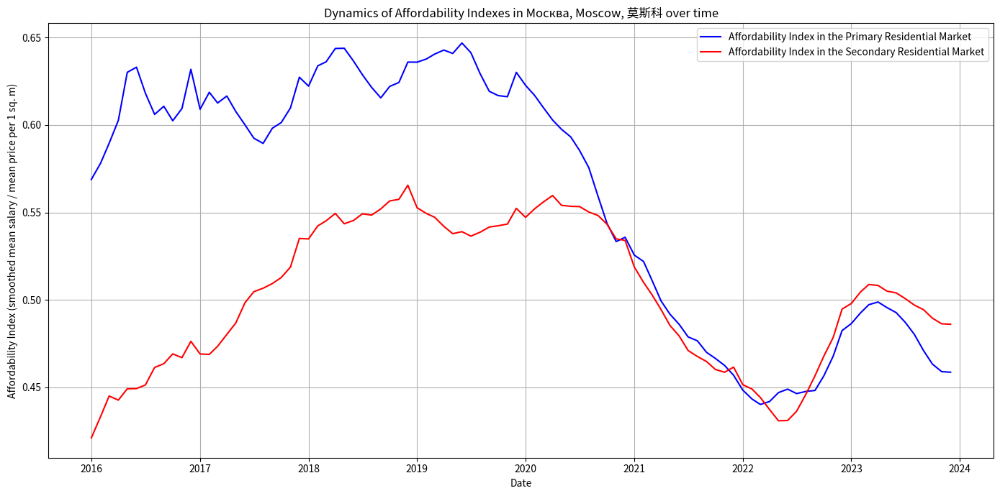

In [227]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Москва, Moscow, 莫斯科')

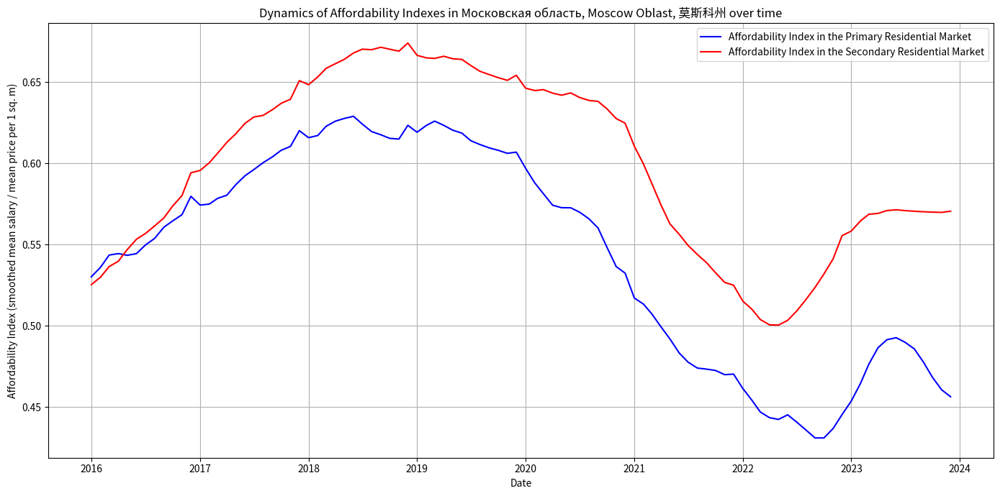

In [228]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Московская область, Moscow Oblast, 莫斯科州')

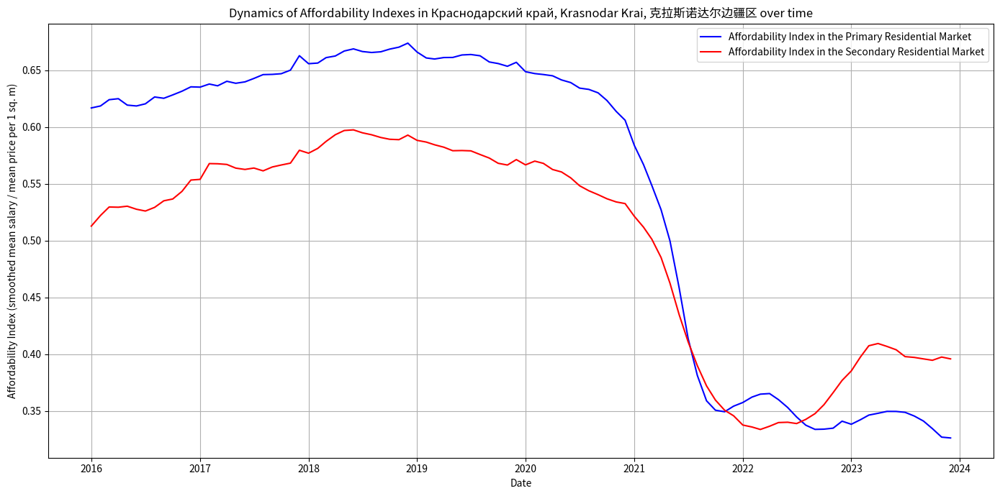

In [229]:
syv.plot_affordability_indicators(
    affordability_index_primary_df,
    affordability_index_secondary_df,
    'Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区')

Сохраним графики для всех регионов. Они доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [230]:
syv.save_affordability_indicators_charts(
    affordability_index_primary_df,
    affordability_index_secondary_df
)

'Charts saved successfully'

# 7 Макроэкономические индикаторы

Проведём анализ связи между макроэкономическими индикаторами: денежными агрегатами (М2 и "Широкая Денежная Масса"), ключевой ставкой и реальными рублёвыми ценами.

## 7.1 Связь между величиной денежных агрегатов и реальными ценами

Прочитаем данные о величине денежных агрегатов

In [231]:
aggregates_df = syv.read_monetary_aggregates()
aggregates_df = syv.adjust_dates_and_offset_aggregates_by_day(aggregates_df)
aggregates_df = aggregates_df[aggregates_df['date'] >= '2016-01-31']

Monetary Aggregates Data loaded successfully.


Объединим 2 таблицы в одну с помощью метода merge() и зададим ключи для объединения по столбцам 'region' и 'date':

In [232]:
merged_primary_secondary_df = syv.merge_primary_secondary_with_end_of_month_dates(
    primary_deals_real,
    secondary_deals_real
)
merged_primary_secondary_df.drop(['date_primary', 'date_secondary'], axis=1, inplace=True)

Объединим данные о ценах и денежных агрегатах. Отсортируем их по дате. Сохраним результат в объект merged_primary_secondary_df.

In [233]:
merged_agg_primary_secondary_df = syv.merge_price_with_aggregates(
    merged_primary_secondary_df,
    aggregates_df=aggregates_df,
    prices_date_col='month_end_date',
    aggregates_date_col='date'
)

Построим диаграммы рассеяния для ключевых регионов, а также России в целом. На оси абсцисс представлены данные о величине денежного агрегата. На оси ординат &mdash; данные о реальных ценах первичного и вторичного рынков.

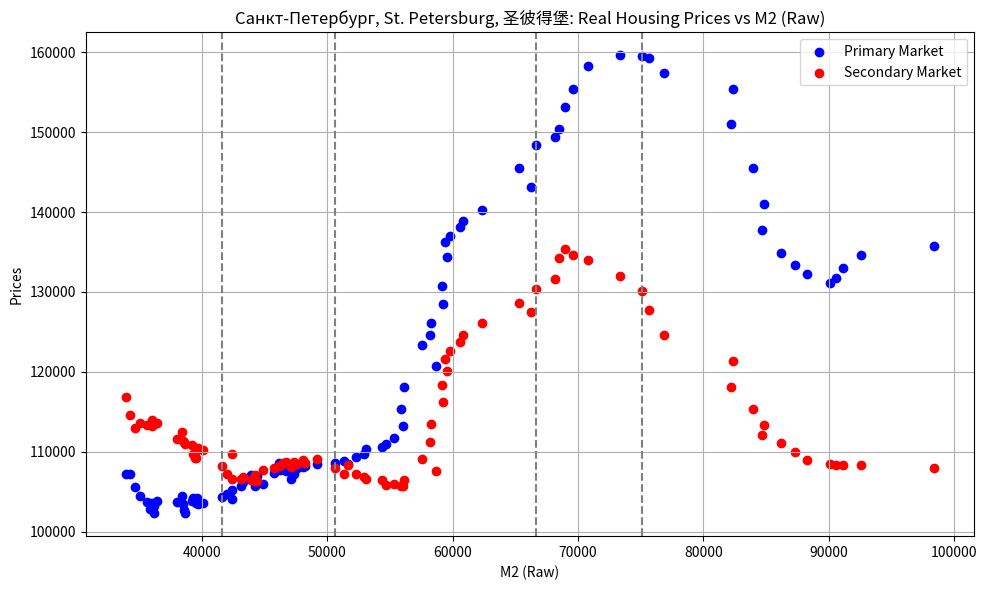

In [234]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

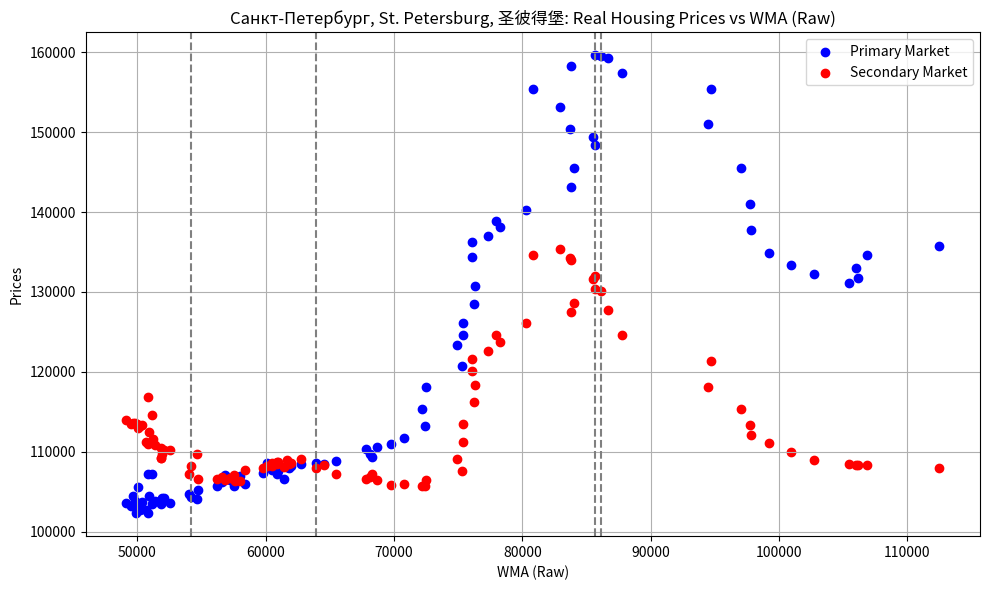

In [235]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

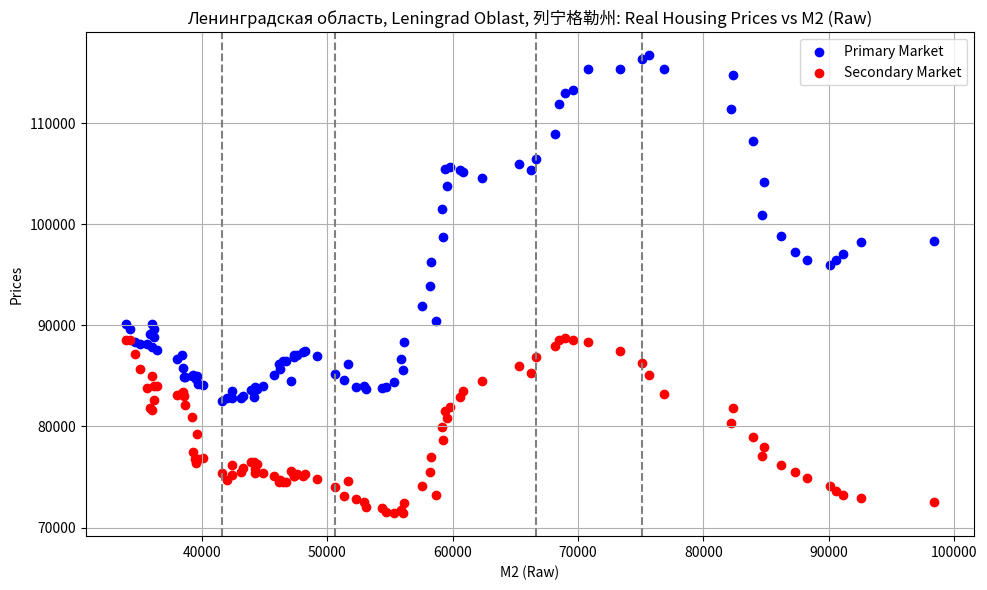

In [236]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

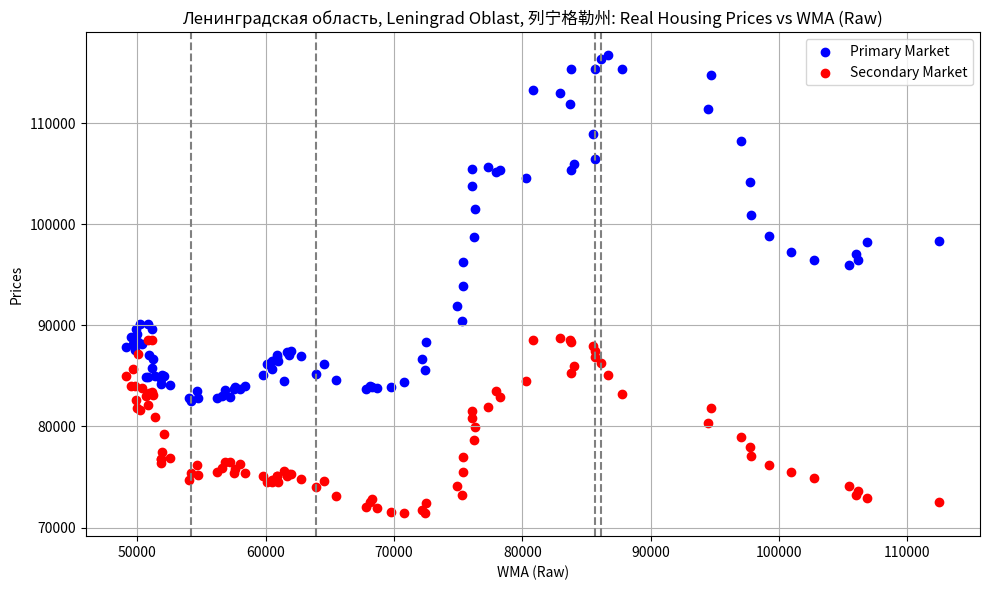

In [237]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)


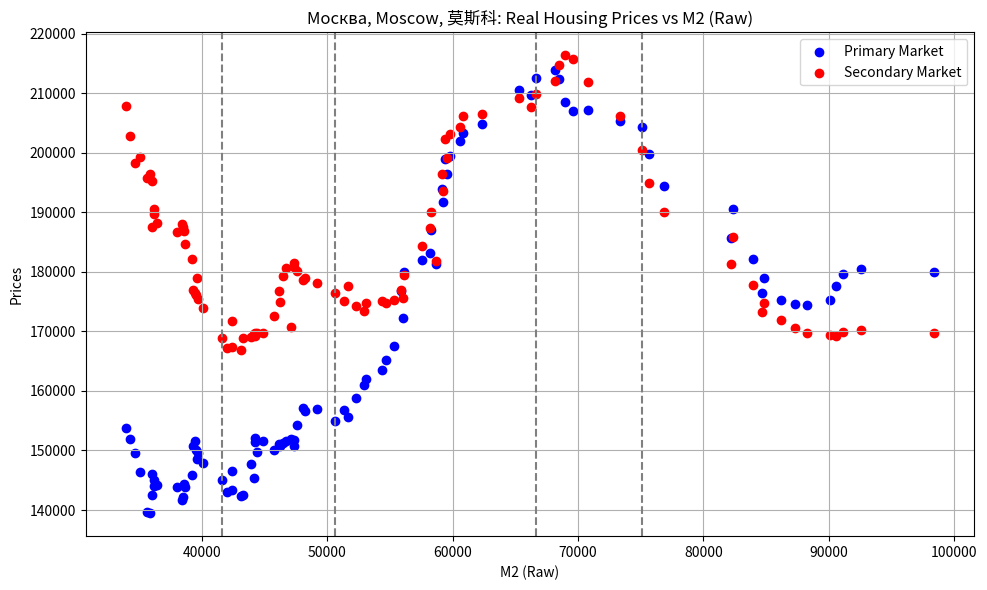

In [238]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

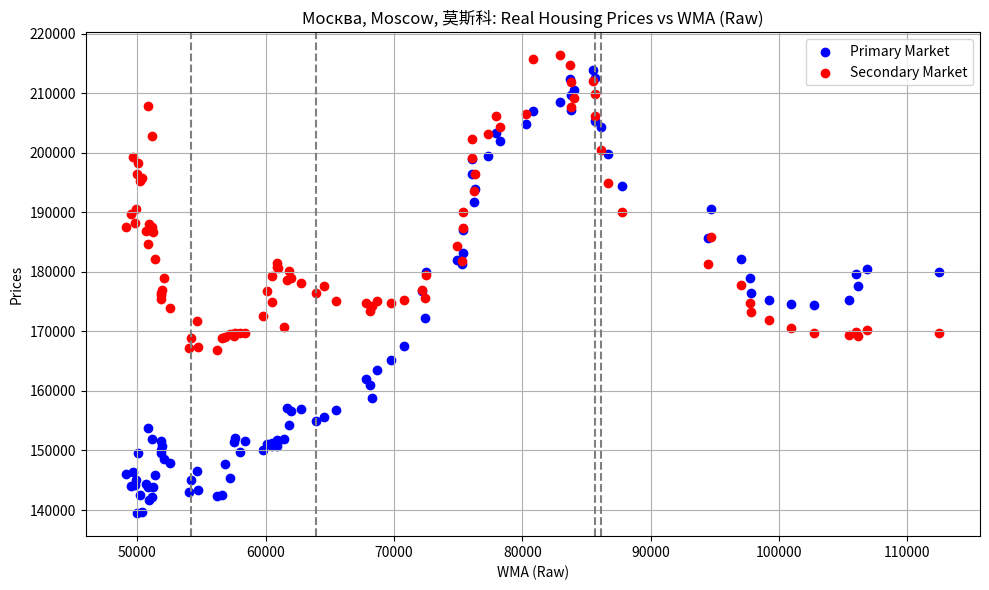

In [239]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

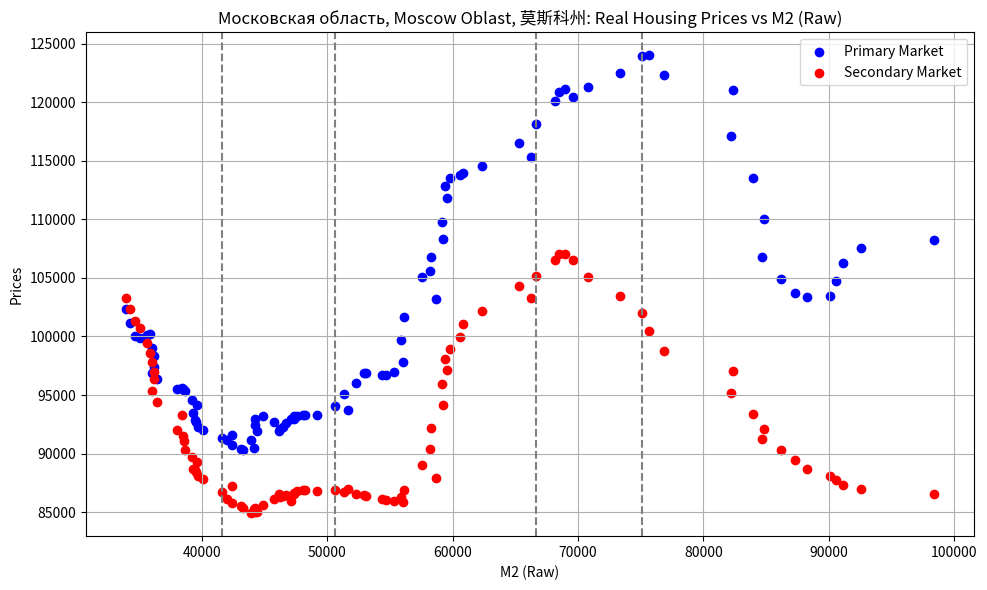

In [240]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

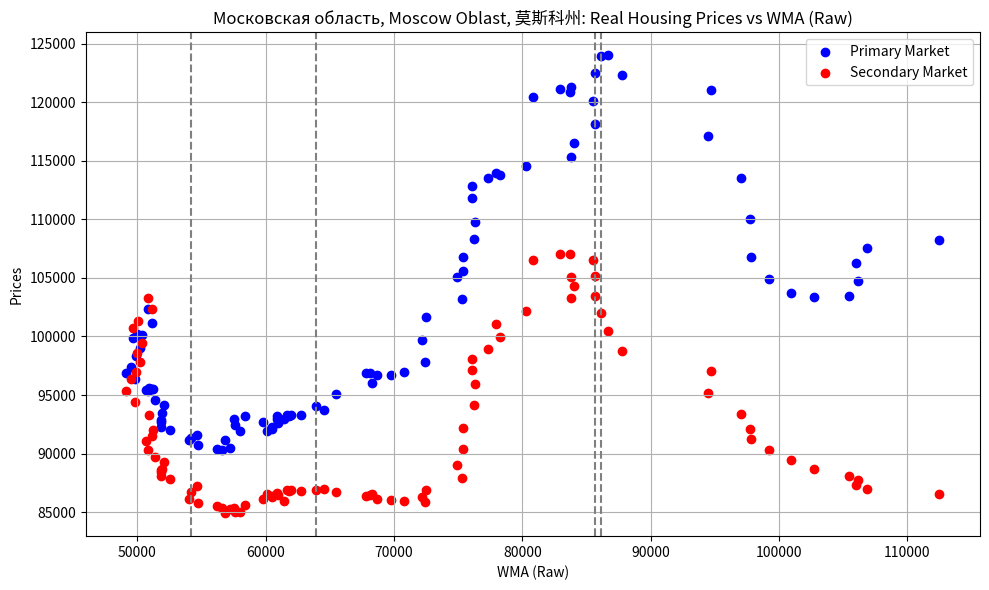

In [241]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

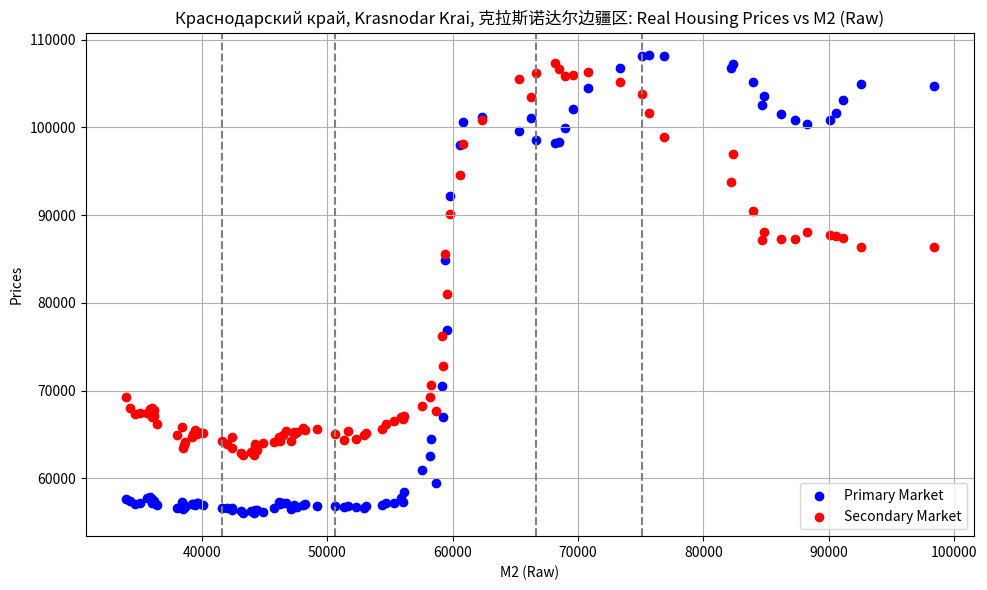

In [242]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

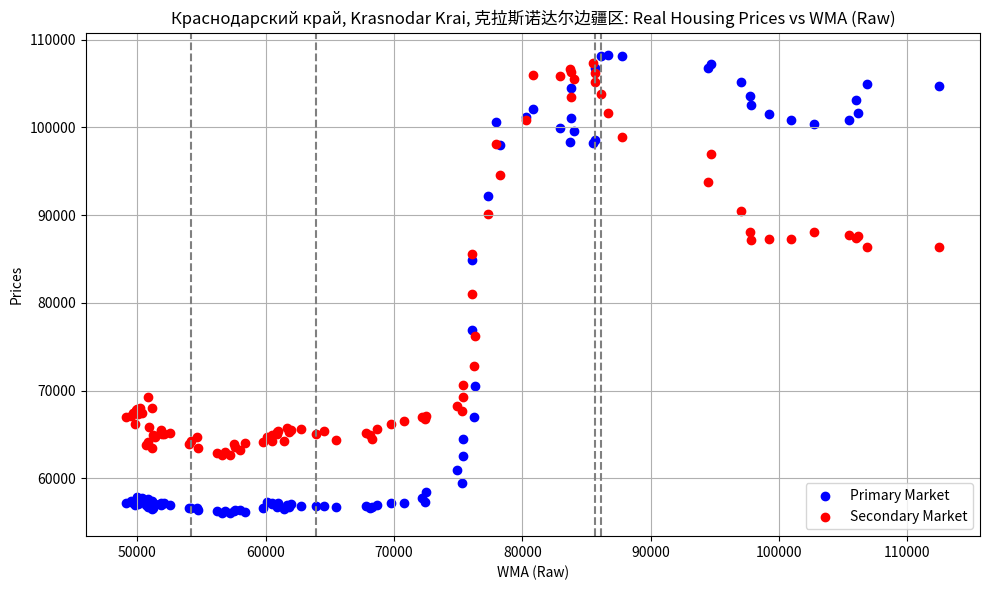

In [243]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

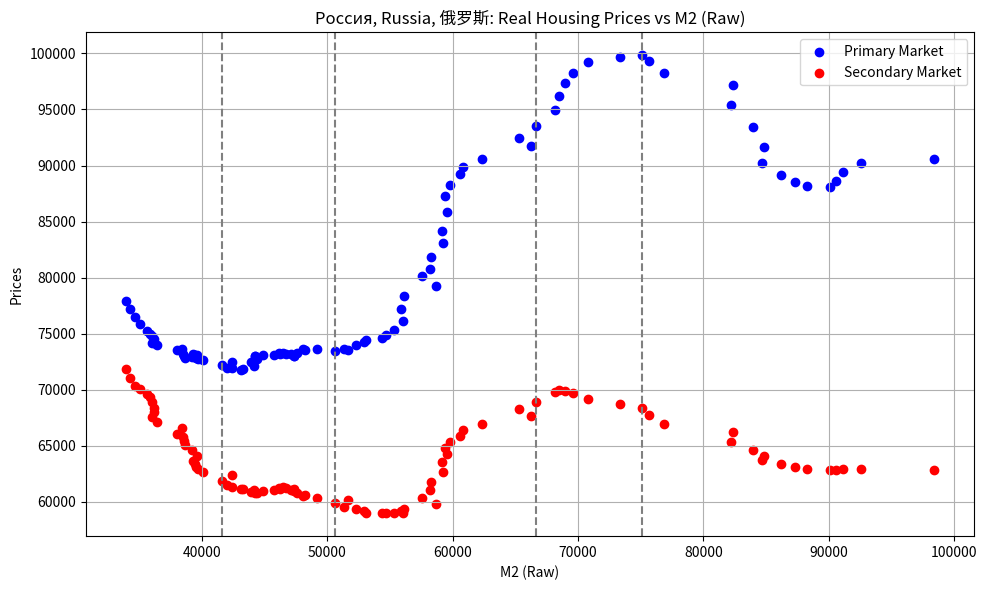

In [244]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='M2',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

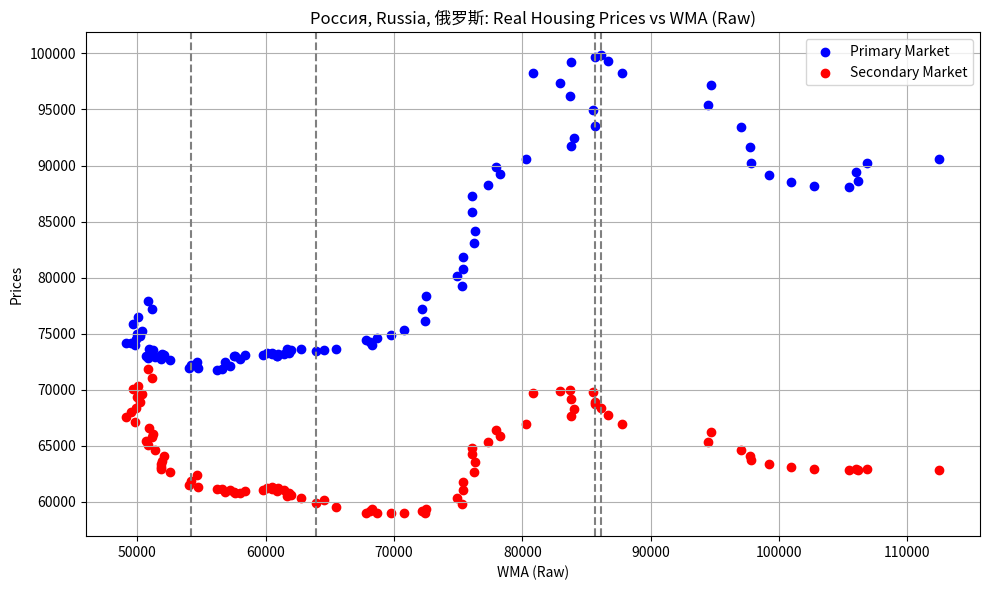

In [245]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']

syv.plot_region_with_monetary_agg_single_df(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='WMA',
    price_col_primary='value_real_primary',
    price_col_secondary='value_real_secondary',
    analysis_type='raw',
    specific_dates=specific_dates
)

Сохраним диаграммы для всех регионов. Они доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [246]:
specific_dates = ['2018-01-31', '2020-01-31', '2022-02-28', '2022-09-30']
syv.save_scatter_plots_for_regions(
    merged_agg_primary_secondary_df,
    'value_real_primary',
    'value_real_secondary',
    'raw',
    specific_dates
)

In [247]:
merged_agg_primary_secondary_df = syv.calculate_growth_rates(merged_agg_primary_secondary_df)

Построим графики, показывающие изменения реальных цен, а также денежной массы М2 и широкой денежной массы для ключевых регионов, а также России в целом.

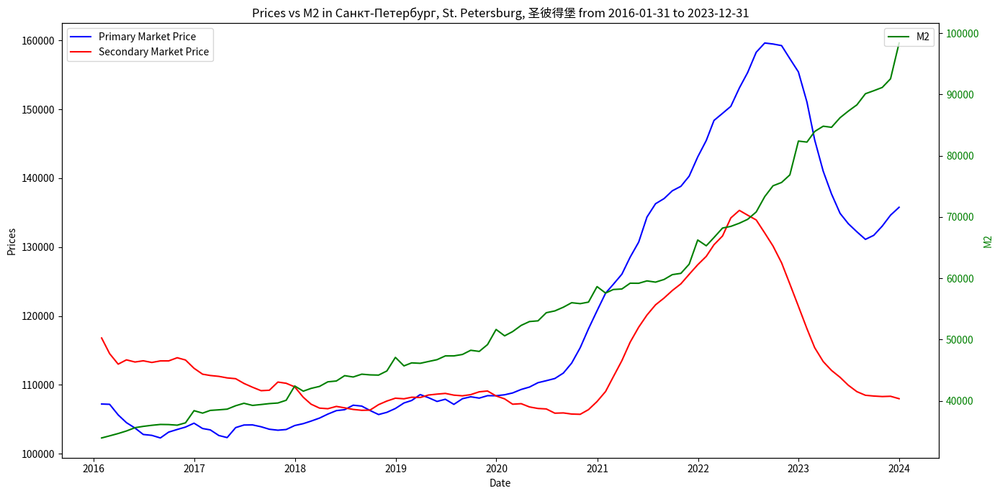

In [248]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

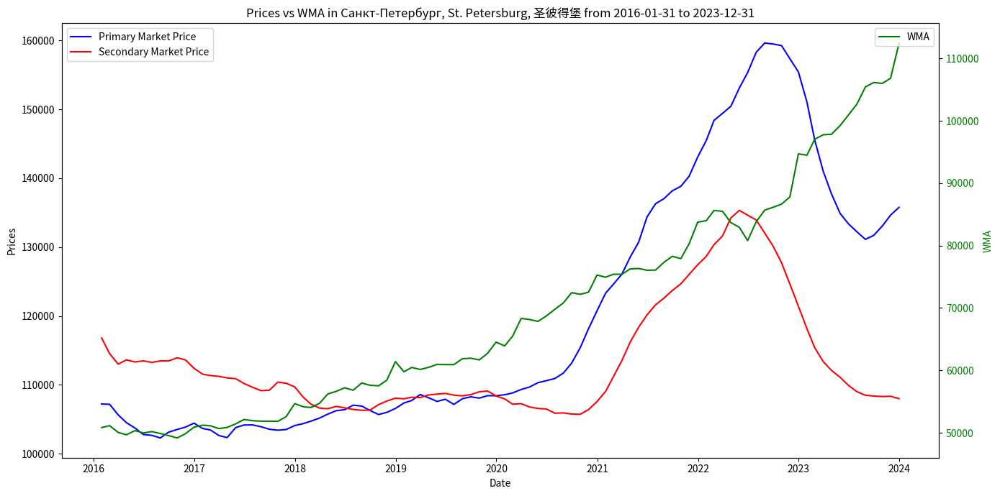

In [249]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

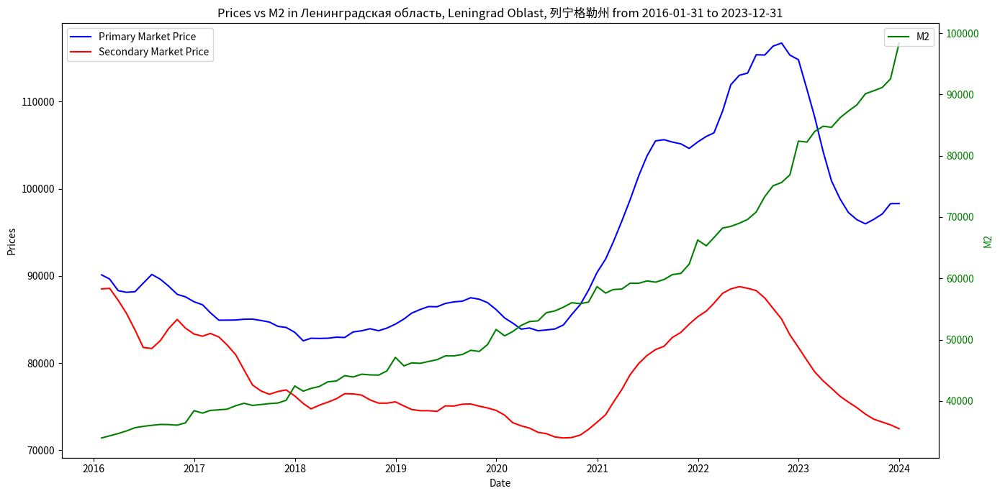

In [250]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

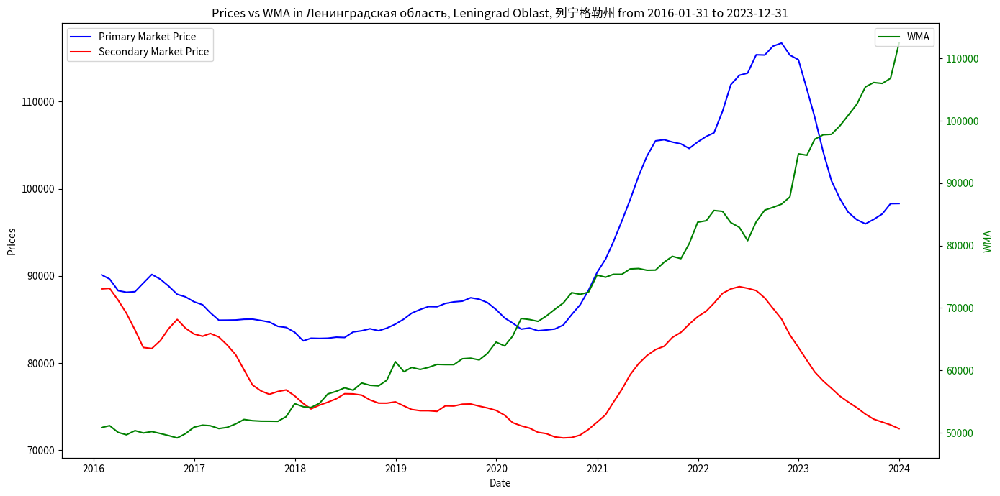

In [251]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

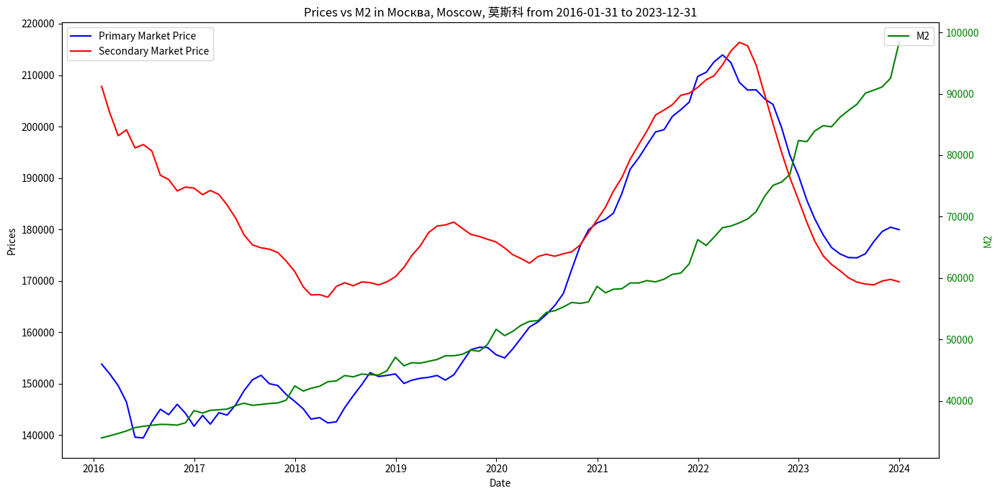

In [252]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

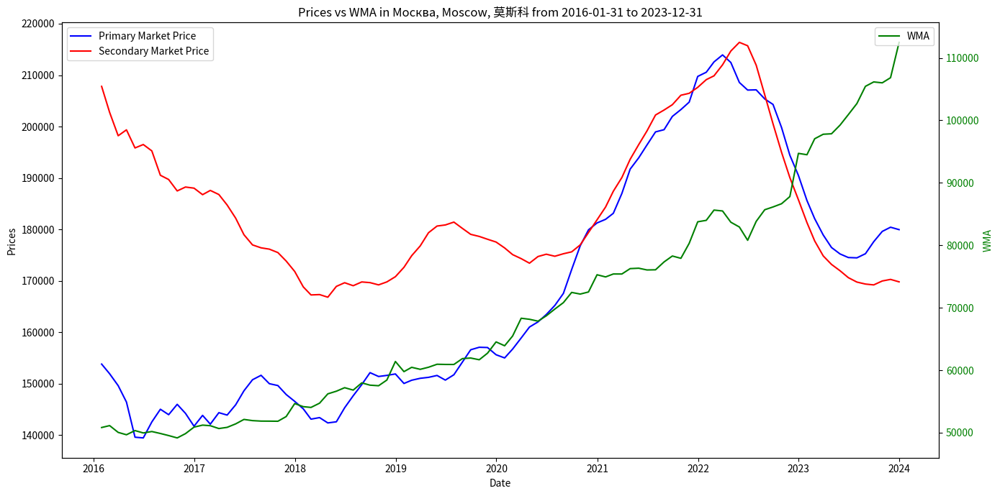

In [253]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

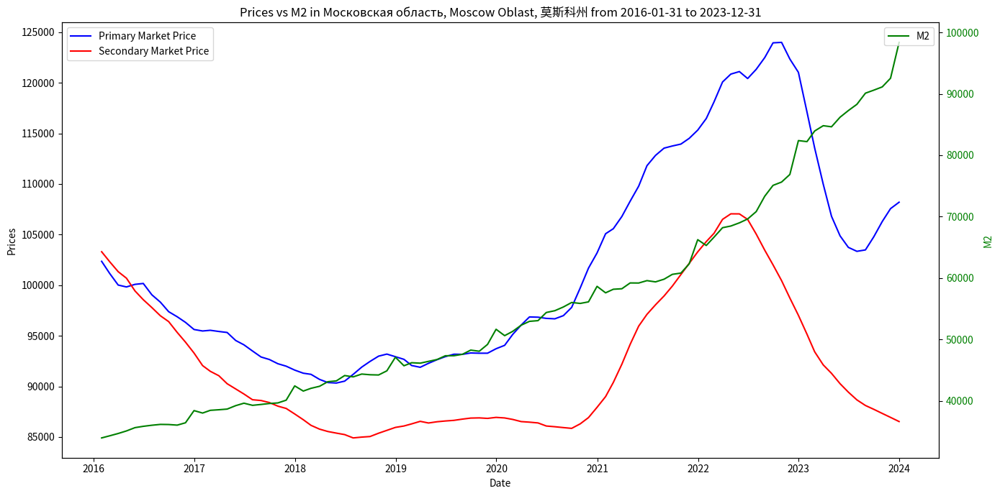

In [254]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

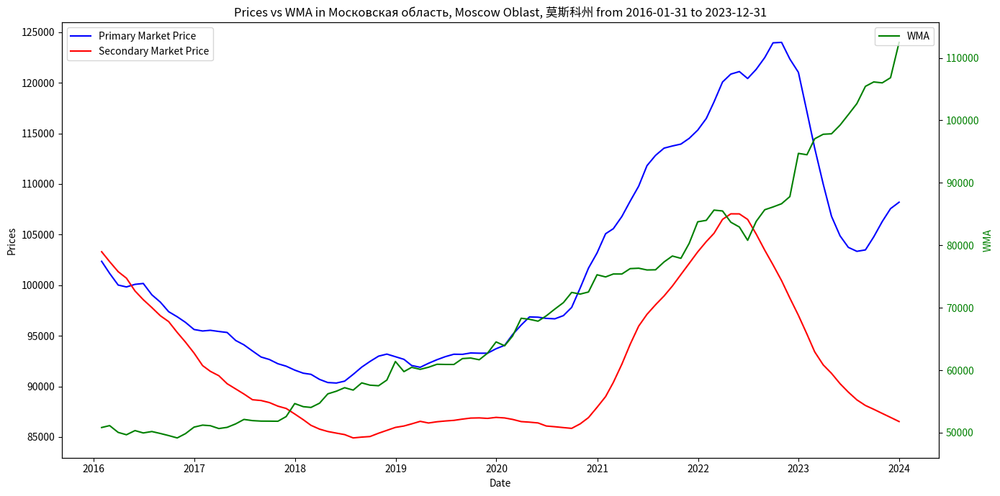

In [255]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

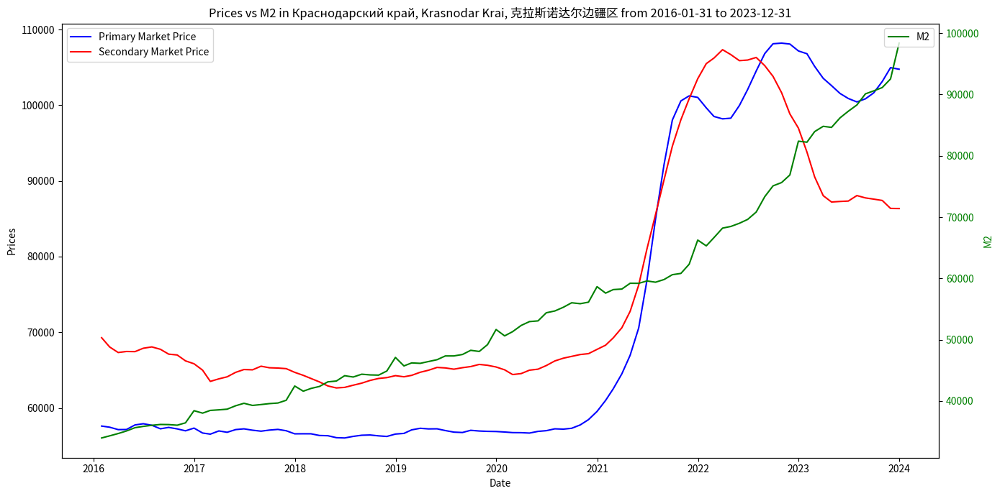

In [256]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

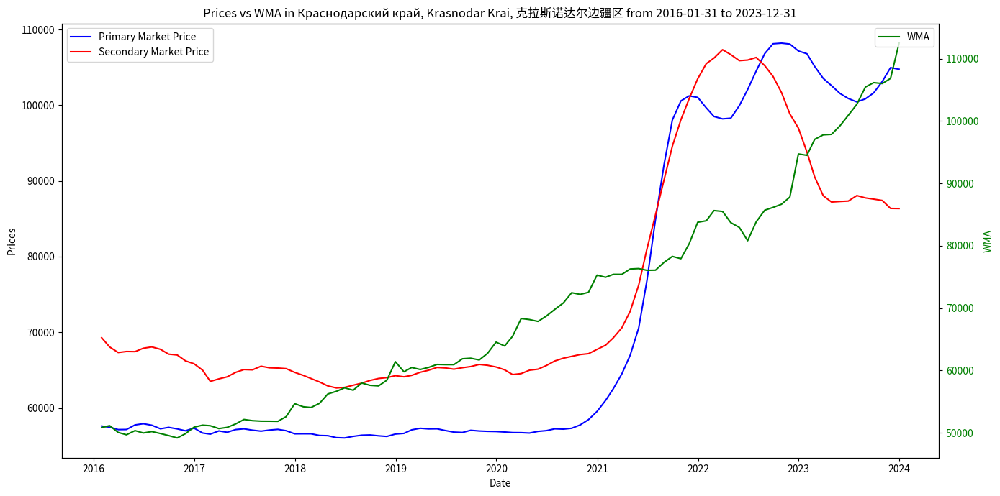

In [257]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

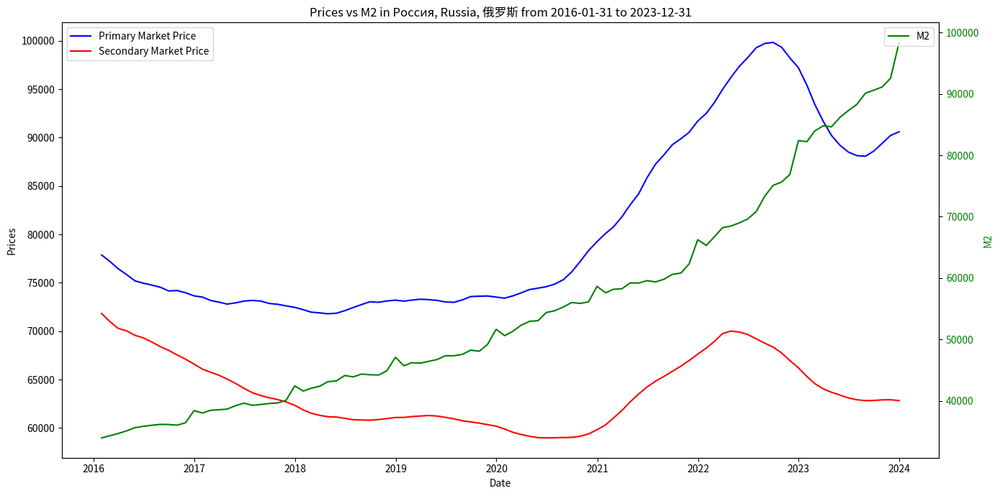

In [258]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='M2',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

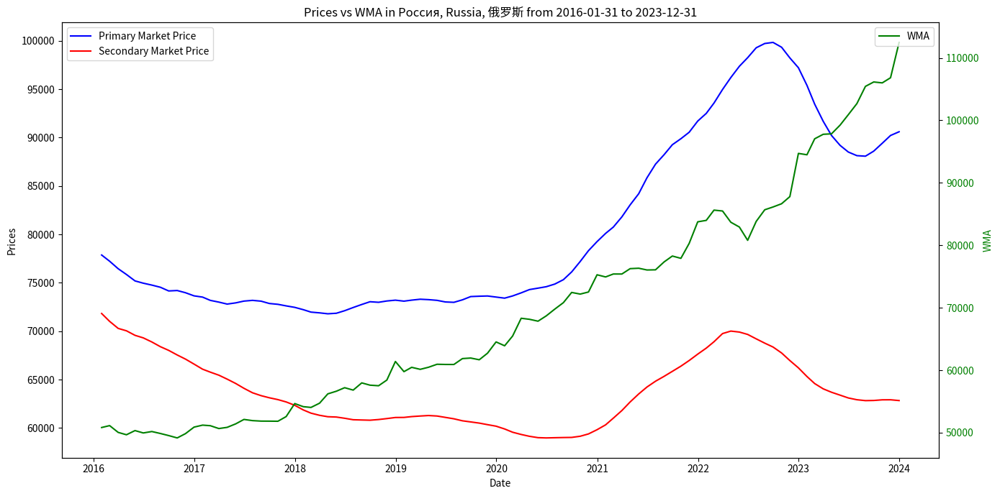

In [259]:
syv.plot_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='WMA',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

Сохраним данные графики для всех регионов. Они доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [260]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    'M2',
    '2016-01-31',
    '2023-12-31'
)

In [261]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    merged_agg_primary_secondary_df,
    'WMA',
    '2016-01-31',
    '2023-12-31'
)

## 7.2 Связь между величиной ключевой ставки и реальными ценами

Прочитаем данные о ключевой ставке.

In [262]:
key_rate_df = syv.read_key_rate_data()
key_rate_df.reset_index(drop=True, inplace=True)
print(key_rate_df)

            date  key_rate
0     2016-01-01    0.1100
1     2016-01-11    0.1100
2     2016-01-12    0.1100
3     2016-01-13    0.1100
4     2016-01-14    0.1100
5     2016-01-15    0.1100
6     2016-01-18    0.1100
7     2016-01-19    0.1100
8     2016-01-20    0.1100
9     2016-01-21    0.1100
10    2016-01-22    0.1100
11    2016-01-25    0.1100
12    2016-01-26    0.1100
13    2016-01-27    0.1100
14    2016-01-28    0.1100
15    2016-01-29    0.1100
16    2016-02-01    0.1100
17    2016-02-02    0.1100
18    2016-02-03    0.1100
19    2016-02-04    0.1100
20    2016-02-05    0.1100
21    2016-02-08    0.1100
22    2016-02-09    0.1100
23    2016-02-10    0.1100
24    2016-02-11    0.1100
25    2016-02-12    0.1100
26    2016-02-15    0.1100
27    2016-02-16    0.1100
28    2016-02-17    0.1100
29    2016-02-18    0.1100
30    2016-02-19    0.1100
31    2016-02-20    0.1100
32    2016-02-24    0.1100
33    2016-02-25    0.1100
34    2016-02-26    0.1100
35    2016-02-29    0.1100
3

Рассчитаем средневзвешенные значения ключевой ставки ЦБ для каждого месяца.

In [263]:
weighted_key_rates = syv.calculate_weighted_average_key_rate(key_rate_df)
print(weighted_key_rates)

         date  average_key_rate
0  2016-01-31          0.110000
1  2016-02-29          0.110000
2  2016-03-31          0.110000
3  2016-04-30          0.110000
4  2016-05-31          0.110000
5  2016-06-30          0.107167
6  2016-07-31          0.105000
7  2016-08-31          0.105000
8  2016-09-30          0.102813
9  2016-10-31          0.100000
10 2016-11-30          0.100000
11 2016-12-31          0.100000
12 2017-01-31          0.100000
13 2017-02-28          0.100000
14 2017-03-31          0.099470
15 2017-04-30          0.097500
16 2017-05-31          0.092500
17 2017-06-30          0.091406
18 2017-07-31          0.090000
19 2017-08-31          0.090000
20 2017-09-30          0.087742
21 2017-10-31          0.084833
22 2017-11-30          0.082500
23 2017-12-31          0.079679
24 2018-01-31          0.077500
25 2018-02-28          0.075982
26 2018-03-31          0.074453
27 2018-04-30          0.072500
28 2018-05-31          0.072500
29 2018-06-30          0.072500
30 2018-

Объединим данные по ценам и средневзвешенной ключевой ставке.

In [264]:
prices_vs_rates_df = syv.merge_prices_with_key_rates(merged_primary_secondary_df, weighted_key_rates)

Построим графики динамики цен и ключевой ставки для 5 главных регионов: Санкт-Петербург, Ленинградская область, Москва, Московская область, Краснодарский край, а также для России в целом.

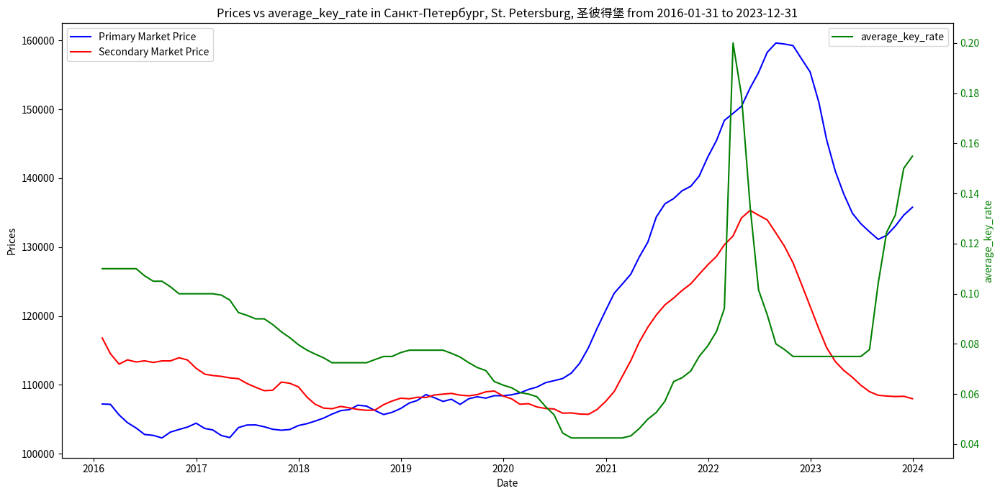

In [265]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Санкт-Петербург, St. Petersburg, 圣彼得堡',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

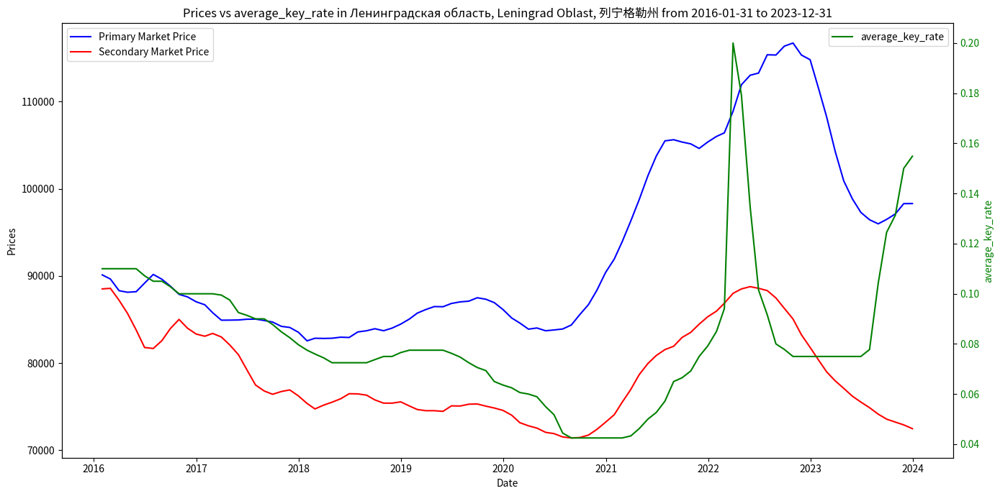

In [266]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Ленинградская область, Leningrad Oblast, 列宁格勒州',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

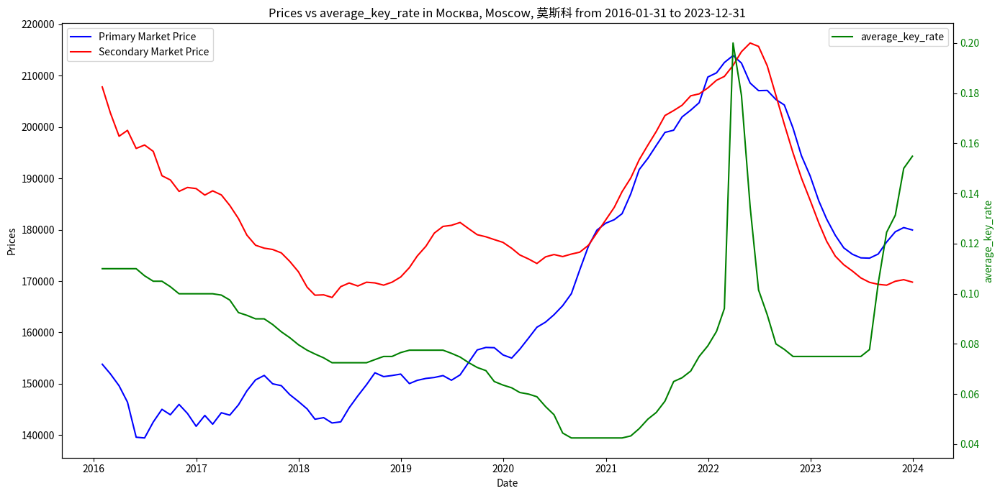

In [267]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Москва, Moscow, 莫斯科',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

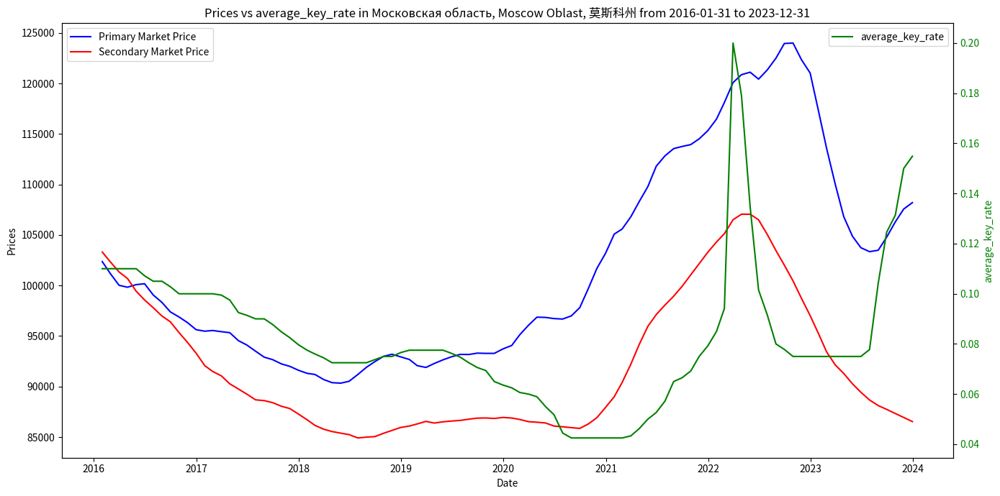

In [268]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Московская область, Moscow Oblast, 莫斯科州',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

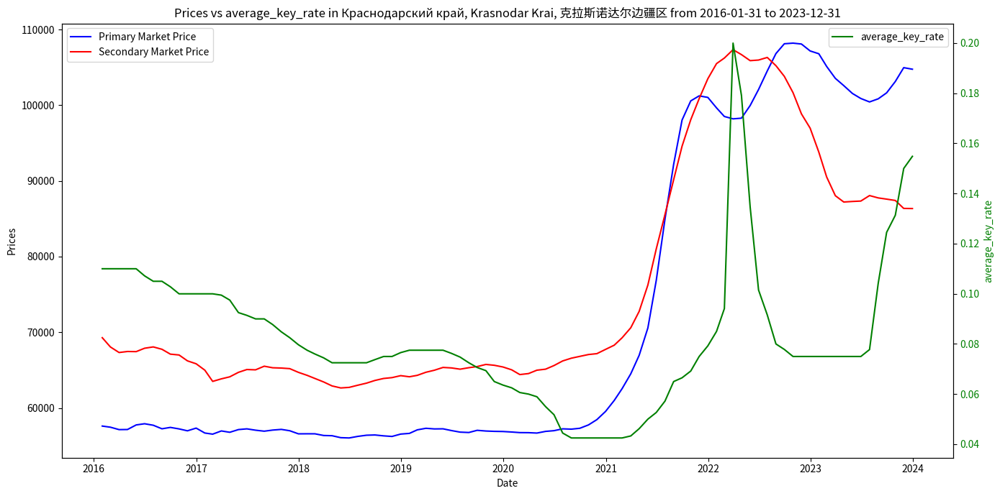

In [269]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Краснодарский край, Krasnodar Krai, 克拉斯诺达尔边疆区',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

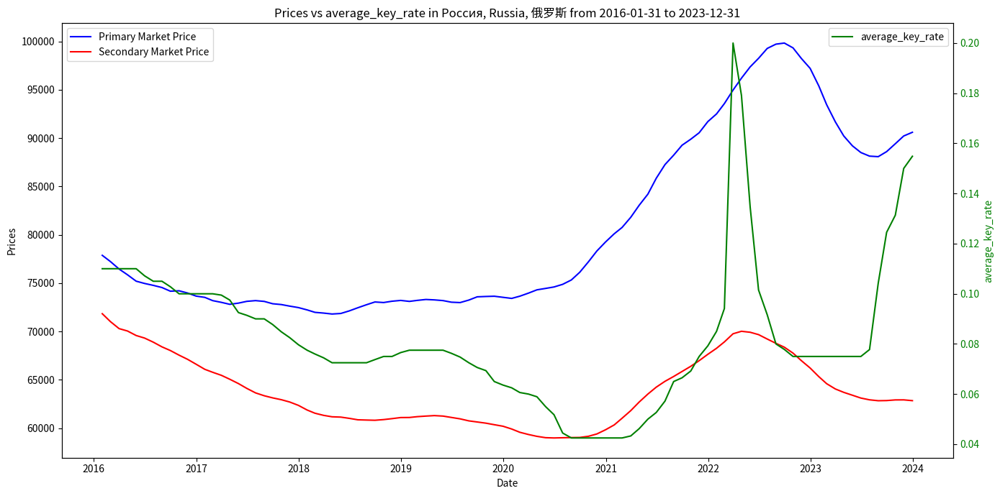

In [270]:
syv.plot_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    region_name='Россия, Russia, 俄罗斯',
    monetary_col='average_key_rate',
    start_date='2016-01-31',
    end_date='2023-12-31'
)

Сохраним данные графики для всех регионов. Они доступны по [ссылке](https://web.tresorit.com/l/1SK8A#4Rzl6PPlQ6Ri07meLsayuA).

In [271]:
syv.save_all_regions_prices_vs_monetary_aggregate(
    prices_vs_rates_df,
    'average_key_rate',
    '2016-01-31',
    '2023-12-31'
)

## Обратная связь

Для обратной связи, вопросов и предложений используйте: [группу Artificial Intelligence in Valuation](https://www.facebook.com/groups/1977067932456703) либо [канал Artificial Intelligence in Valuation](https://t.me/AIinValuation).